# Etude des préfixes exprimant le haut degré dans Google Ngram (1800-2010)

liste des préfixes étudiés : ultra-, super-, supra-, hyper-, hypra-, sur-, extra-, méga-, giga-, archi-, maxi-

Dans ce notebook, nous générons, à partir des données de Google Ngrams nettoyées (conservation des seules lignes contenant dans la chaîne l'un des formants ci-dessous), la liste définitive des données qui seront conservées pour l'étude linguistique. Il s'agit principalement d'éliminer les ignes contenant des mots appartenant à des stoplists (mots n'étant pas formés sur la base d'un des préfixes malgré une forme commune, autres erreurs).
Nous générons d'abord la liste des unigrammes (mégacool), puis les bi-grammes (méga fatiguant)  puis les trigrammes (méga-bête).


In [2]:
import requests
import sys, csv,re, random, glob,os
import numpy as np                               # vectors and matrices
import pandas as pd                              # tables and data manipulations
import matplotlib.pyplot as plt
import matplotlib.pylab as plt
%matplotlib inline
from matplotlib.pylab import rcParams
rcParams['figure.figsize'] = 15, 6
import matplotlib
import seaborn as sns                            # more plots
from sklearn.metrics import mean_absolute_error
from matplotlib.backends.backend_pdf import PdfPages

# chargement des fonctions

In [3]:
## functions
# load yearly corpus stats (total words)
# compare with google stats per year
def load_total_counts(corpus_id, start_year, end_year):
    '''
    This function loads the total counts for a given corpus from Google's source data.
    '''
    # map from id to url
    id_to_url= {
    15: 'http://storage.googleapis.com/books/ngrams/books/googlebooks-eng-all-totalcounts-20120701.txt',
    17: 'http://storage.googleapis.com/books/ngrams/books/googlebooks-eng-us-all-totalcounts-20120701.txt',
    18: 'http://storage.googleapis.com/books/ngrams/books/googlebooks-eng-gb-all-totalcounts-20120701.txt',
    16: 'http://storage.googleapis.com/books/ngrams/books/googlebooks-eng-fiction-all-totalcounts-20120701.txt',
    23: 'http://storage.googleapis.com/books/ngrams/books/googlebooks-chi-sim-all-totalcounts-20120701.txt',
    19: 'http://storage.googleapis.com/books/ngrams/books/googlebooks-fre-all-totalcounts-20120701.txt',
    20: 'http://storage.googleapis.com/books/ngrams/books/googlebooks-ger-all-totalcounts-20120701.txt',
    24: 'http://storage.googleapis.com/books/ngrams/books/googlebooks-heb-all-totalcounts-20120701.txt',
    22: 'http://storage.googleapis.com/books/ngrams/books/googlebooks-ita-all-totalcounts-20120701.txt',
    25: 'http://storage.googleapis.com/books/ngrams/books/googlebooks-rus-all-totalcounts-20120701.txt',
    21: 'http://storage.googleapis.com/books/ngrams/books/googlebooks-spa-all-totalcounts-20120701.txt'
    }
    hdr='Mozilla/5.0 (Macintosh; Intel Mac OS X x.y; rv:10.0) Gecko/20100101 Firefox/10.0'
    headers={'User-Agent':hdr}
    resp = requests.get(id_to_url[corpus_id],headers=headers)
    resp.raise_for_status()
    response = resp.text
    #print(response)
    #response = urllib2.urlopen(urllib2.Request(id_to_url[corpus_id]))
    #total_counts = []
    total_counts2 = {}
    data = response.split("\t")
    for row in data:
        #print (row)
        #continue
        # first and last rows are empty, so a try...except is needed
        try:
            year, word_count, _, _ = row.split(',')
            #print(start_year)
            #print(end_year)
            #print(year)
            if int(year) >= start_year and int(year) <= end_year:
                #print(year)
                #print(word_count)
                #total_counts.append(int(word_count))
                total_counts2[year]=int(word_count)
                #print(total_counts)
        except ValueError:
            pass
        
    return total_counts2


def plot_rolling_simple(df,title, window=10):
    fig, ax = plt.subplots(2,figsize=(20, 10))
    ax[0].plot(df.index, df.data, label='raw data')
    ax[0].plot(df.data.rolling(window=window).mean(),label="rolling mean (window=" + str(window) + ")")
    ax[0].plot(df.data.rolling(window=window).std(), label="rolling std (window=" + str(window) + ")")
    ax[0].legend()

    ax[1].plot(df.index, df.z_data, label="de-trended data")
    ax[1].plot(df.z_data.rolling(window=window).mean(), label="rolling mean (window=" + str(window) + ")")
    ax[1].plot(df.z_data.rolling(window=window).std(), label="rolling std (window=" + str(window) + ")")
    ax[1].legend()

    fig.suptitle(title, fontsize=13)
    plt.tight_layout()
    #fig.autofmt_xdate()
    
# useful for annotating barcharts
def add_value_labels(ax, spacing=5):
    """Add labels to the end of each bar in a bar chart.

    Arguments:
        ax (matplotlib.axes.Axes): The matplotlib object containing the axes
            of the plot to annotate.
        spacing (int): The distance between the labels and the bars.
    """

    # For each bar: Place a label
    for rect in ax.patches:
        # Get X and Y placement of label from rect.
        y_value = rect.get_height()
        x_value = rect.get_x() + rect.get_width() / 2

        # Number of points between bar and label. Change to your liking.
        space = spacing
        # Vertical alignment for positive values
        va = 'bottom'

        # If value of bar is negative: Place label below bar
        if y_value < 0:
            # Invert space to place label below
            space *= -1
            # Vertically align label at top
            va = 'top'

        # Use Y value as label and format number with one decimal place
        label = "{:.1f}".format(y_value)

        # Create annotation
        ax.annotate(
            label,                      # Use `label` as label
            (x_value, y_value),         # Place label at end of the bar
            xytext=(0, space),          # Vertically shift label by `space`
            textcoords="offset points", # Interpret `xytext` as offset in points
            ha='center',                # Horizontally center label
            va=va)                      # Vertically align label differently for
                                        # positive and negative values.


            
            
# save dataframe df
# save to excel
def save_report(df, key, outfile):
    """
    Take a report and save it to a single Excel file
    """
    cols = sorted(list(df.columns.values),reverse=True)
    #print(cols)
    writer = pd.ExcelWriter(outfile)
    #for k, grp in df[['prefix','word','full_count','string']].groupby(key):
    for pref in dist1.index.values:
        dfprint = df[df.prefix == pref].groupby(['word','string','sep'])['full_count'].sum().reset_index().sort_values('full_count', ascending=False).set_index(['word'])
        #print(dfprint)
        dfprint.to_excel(writer,pref)
        #grp.sort_values('full_count', ascending=False).set_index(['string','word','sep'])['full_count'].to_excel(writer,k)
    writer.save()
    return True


# Chargement des stoplists

In [4]:
stoplist={}
stoplist_loc={}
files = glob.glob("../data/stoplists/*.txt")
for file in files:
    with open(file, mode="r",encoding="utf8") as f:
        if re.search(r'stoplist_latinloc', file):
            for line in f:
                if len(line.strip())>0:
                    stoplist_loc[line.strip()]=1
        else:
            for line in f:
                if len(line.strip())>0:
                    stoplist[line.strip()]=1
            
print("Stoplist chargée : " + str(len(stoplist)) + " mots.")
print("Stoplist Loc chargée : " + str(len(stoplist_loc)) + " mots.")

# sauvegarde des données complètes
fout = open("../data/stoplists/all_stopwords.csv", mode="w", encoding="utf-8")
fout.write("\n".join(stoplist.keys()))
fout.write("\n".join(stoplist_loc.keys()))
fout.close()

Stoplist chargée : 4174 mots.
Stoplist Loc chargée : 890 mots.


# Données sans analyse morphosyntaxique

Deux versions du jeux de données Google Ngrams sont disponibles : avec et sans analyse morphosyntaxique. Nous générons d'abord les données sans parties du discours.

## 1 grams

Tout d'abord, on élimine les données commençant par sur pour obtenir le comptage exact des données de départ.

In [5]:

if os.path.isfile('../data/fre.prefixes.1.grams.1799-2009.csv'):
    print("Loading the 1 gram big file (no pos)...")
    df= pd.read_csv('../data/fre.prefixes.1.grams.1799-2009.csv', header=0, sep=',', error_bad_lines=False)#, index_col=0 
else:
    print("Please first launch retrieve_google_1grams.py to generate fre.prefixes.1.grams.1799-2009.csv")
    exit()

df = df[~df.string.str.contains(r'^sur')] # elimination mots commençant par sur
df_tmp = df.copy(deep=True)

# on génére les trois colonnes préfix, word et sep (pour les comptages)
pref_re = '^(ultra|super|hyper|hypra|extra|méga|archi|maxi|supra)(?:.*)$'
pref_re2 = '^(?:ultra|super|hyper|hypra|extra|méga|archi|maxi|supra)(.*)$'
df_tmp['prefix'] = df.string.str.extract(pref_re, expand=True)
df_tmp['word'] = df.string.str.extract(pref_re2, expand=True)
df_tmp['sep'] = 'FUSION'

print(df_tmp.info())
#print(df.head())
df_tmp.dropna(inplace=True)
df_tmp = df_tmp[~df_tmp.word.str.contains(r"\d")] # elimination mots contenant des chiffres
df_tmp = df_tmp[df_tmp.word.str.contains(r"^\w{3,}$")] # conservation seulement des mots de plus de trois lettres
print(df_tmp.info())
#print(df.head())
print(df_tmp.prefix.value_counts())

Loading the 1 gram big file (no pos)...
<class 'pandas.core.frame.DataFrame'>
Int64Index: 5774 entries, 0 to 10357
Columns: 214 entries, string to sep
dtypes: int64(210), object(4)
memory usage: 9.5+ MB
None
<class 'pandas.core.frame.DataFrame'>
Int64Index: 5381 entries, 3 to 10357
Columns: 214 entries, string to sep
dtypes: int64(210), object(4)
memory usage: 8.8+ MB
None
super    1400
hyper    1202
extra     985
archi     653
supra     335
ultra     316
maxi      251
méga      239
Name: prefix, dtype: int64


In [6]:

# élimination stoplist
df = df[~df.string.isin(stoplist)] # elimination mots dans les stoplists
print(df.info())
df.head()
# 
pref_re = '^(ultra|super|hyper|hypra|extra|méga|archi|maxi|supra)(?:.*)$'
pref_re2 = '^(?:ultra|super|hyper|hypra|extra|méga|archi|maxi|supra)(.*)$'
df['prefix'] = df.string.str.extract(pref_re, expand=True)
df['word'] = df.string.str.extract(pref_re2, expand=True)
df['sep'] = 'FUSION'
print(df.info())
#print(df.head())
df.dropna(inplace=True)
df = df[~df.word.str.contains(r"\d")] # elimination mots contenant des chiffres
df = df[df.word.str.contains(r"^(|s|\w{3,})$")] # conservation seulement des mots de plus de trois lettres (ou un s ou rien en cas d'emploi autonome du préfixe)
print(df.info())
print(df.prefix.value_counts())

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2458 entries, 0 to 10357
Columns: 211 entries, string to 2009
dtypes: int64(210), object(1)
memory usage: 4.0+ MB
None
<class 'pandas.core.frame.DataFrame'>
Int64Index: 2458 entries, 0 to 10357
Columns: 214 entries, string to sep
dtypes: int64(210), object(4)
memory usage: 4.0+ MB
None
<class 'pandas.core.frame.DataFrame'>
Int64Index: 2457 entries, 0 to 10357
Columns: 214 entries, string to sep
dtypes: int64(210), object(4)
memory usage: 4.0+ MB
None
hyper    877
super    446
extra    404
supra    236
ultra    191
archi    156
méga     141
maxi       6
Name: prefix, dtype: int64


/Users/emmanuelcartier/opt/anaconda3/lib/python3.7/site-packages/pandas/core/strings.py:1952: UserWarning: This pattern has match groups. To actually get the groups, use str.extract.
  return func(self, *args, **kwargs)


In [13]:
columns = df.columns
periods = [elt for elt in columns if re.match("[0-9]{4}", elt)]
df['full_count'] = df.apply(lambda x: x[periods].sum(), axis=1)
df.head()
df.to_csv("df.csv")


## 2-grams (sans annotation pos)

In [22]:

if os.path.isfile('../data/fre.prefixes.2.grams.1799-2009.csv'):
    print("Loading the 2 gram big file (no pos)...")
    df2= pd.read_csv('../data/fre.prefixes.2.grams.1799-2009.csv', header=0, sep=',', error_bad_lines=False)#, index_col=0 
else:
    print("Please first launch retrieve_google_2grams.py to generate fre.prefixes.2.grams.1799-2009.csv")
    exit()

#print(df2.head())
print(df2.info())
df2 = df2[~df2.string.str.contains(r'^sur')] # elimination mots commençant par sur
print(df2.info())


Loading the 2 gram big file (no pos)...
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 26763 entries, 0 to 26762
Columns: 211 entries, string to 2009
dtypes: float64(50), int64(160), object(1)
memory usage: 43.1+ MB
None
<class 'pandas.core.frame.DataFrame'>
Int64Index: 2672 entries, 0 to 26762
Columns: 211 entries, string to 2009
dtypes: float64(50), int64(160), object(1)
memory usage: 4.3+ MB
None


In [23]:

# élimination stoplist
df2 = df2[~df2.string.isin(stoplist)]
df2.info()
df2.head()

# colonnes préfix et word
pref_re = '^(ultra|super|hyper|hypra|extra|méga|archi|maxi|supra)\s+(?:\w{3,})$'
pref_re2 = '^(?:ultra|super|hyper|hypra|extra|méga|archi|maxi|supra)\s+(\w{3,})$'
df2['prefix'] = df2.string.str.extract(pref_re, expand=True)
df2['word'] = df2.string.str.extract(pref_re2, expand=True)
df2['sep'] = 'ESPACE'
print(df2.info())
print(df2.head())
df2.dropna(inplace=True)
df2 = df2[~df2.word.str.contains(r"\d")]
df2 = df2[df2.word.str.contains(r"^(|s|\w{3,})$")]
print(df2.info())
print(df2.prefix.value_counts())


<class 'pandas.core.frame.DataFrame'>
Int64Index: 2650 entries, 0 to 26762
Columns: 211 entries, string to 2009
dtypes: float64(50), int64(160), object(1)
memory usage: 4.3+ MB
<class 'pandas.core.frame.DataFrame'>
Int64Index: 2650 entries, 0 to 26762
Columns: 214 entries, string to sep
dtypes: float64(50), int64(160), object(4)
memory usage: 4.3+ MB
None
             string  1800  1801  1802  1803  1804  1805  1806  1807  1808  \
0           archi 1   0.0   0.0     0     0     0     0   0.0   0.0   0.0   
1         archi Fig   0.0   0.0     0     0     0     0   0.0   0.0   0.0   
2          archi Le   0.0   0.0     0     0     0     0   0.0   0.0   0.0   
3           archi a   0.0   0.0     0     0     0     0   0.0   0.0   0.0   
4  archi chancelier   0.0   0.0     0     1     2     4   1.0   1.0   8.0   

   ...  2003  2004  2005  2006  2007  2008  2009  prefix        word     sep  
0  ...     8     3     2     0     3     2     1     NaN         NaN  ESPACE  
1  ...     0     0   

/Users/emmanuelcartier/opt/anaconda3/lib/python3.7/site-packages/pandas/core/strings.py:1952: UserWarning: This pattern has match groups. To actually get the groups, use str.extract.
  return func(self, *args, **kwargs)


In [71]:
columns = df2.columns
periods = [elt for elt in columns if re.match("[0-9]{4}", elt)]
df2['full_count'] = df2.apply(lambda x: x[periods].sum(), axis=1)
df2.head()
df2.to_csv("df2.csv")


## 3-grams (sans annotation pos)

In [31]:

if os.path.isfile('../data/fre.prefixes.3.grams.1799-2009.csv'):
    print("Loading the 3 gram big file (no pos)...")
    df3= pd.read_csv('../data/fre.prefixes.3.grams.1799-2009.csv', header=0, sep=',', error_bad_lines=False)#, index_col=0 
else:
    print("Please first launch retrieve_google_3grams.py to generate fre.prefixes.3.grams.1799-2009.csv")
    exit()

print(df3.info())
df3 = df3[~df3.string.str.contains(r'^sur')] # elimination mots commençant par sur
print(df3.info())
    
# élimination stoplist
df3 = df3[~df3.string.isin(stoplist)]
df3.info()
#df3.head()

Loading the 3 gram big file (no pos)...
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3393 entries, 0 to 3392
Columns: 211 entries, string to 2009
dtypes: int64(210), object(1)
memory usage: 5.5+ MB
None
<class 'pandas.core.frame.DataFrame'>
Int64Index: 3393 entries, 0 to 3392
Columns: 211 entries, string to 2009
dtypes: int64(210), object(1)
memory usage: 5.5+ MB
None
<class 'pandas.core.frame.DataFrame'>
Int64Index: 3393 entries, 0 to 3392
Columns: 211 entries, string to 2009
dtypes: int64(210), object(1)
memory usage: 5.5+ MB


In [33]:
# colonnes préfix et word
pref_re = '^(ultra|super|hyper|hypra|extra|méga|archi|maxi|supra)\s+-\s+(?:.*)$'
pref_re2 = '^(?:ultra|super|hyper|hypra|extra|méga|archi|maxi|supra)\s+-\s+(.*)$'
df3['prefix'] = df3.string.str.extract(pref_re, expand=True)
df3['word'] = df3.string.str.extract(pref_re2, expand=True)
df3['sep'] = 'TIRET'
print(df3.info())
#print(df3.head())
#print(df3[df3.isnull().any(axis=1)].head())
#df3.dropna(inplace=True)
#df3 = df3[~df3.word.str.contains(r"\d")]
#df3 = df3[df3.word.str.contains(r"^(|s|\w{3,})$")]
print(df3.info())
print(df3.prefix.value_counts())
#print(df3.head())

<class 'pandas.core.frame.DataFrame'>
Int64Index: 3393 entries, 0 to 3392
Columns: 214 entries, string to sep
dtypes: int64(210), object(4)
memory usage: 5.6+ MB
None
<class 'pandas.core.frame.DataFrame'>
Int64Index: 3393 entries, 0 to 3392
Columns: 214 entries, string to sep
dtypes: int64(210), object(4)
memory usage: 5.6+ MB
None
extra    856
ultra    555
super    362
hyper    180
archi     97
méga      26
maxi       6
Name: prefix, dtype: int64


In [74]:
columns = df3.columns
periods = [elt for elt in columns if re.match("[0-9]{4}", elt)]
df3['full_count'] = df3.apply(lambda x: x[periods].sum(), axis=1)
df3.head()
df3.to_csv("df3.csv")

## Génération dataframe commun

In [35]:
df4 = pd.concat([df,df2,df3],ignore_index=True)
print(df4.info())
#print(df4.head)
print(df4.prefix.value_counts())
df4.to_csv("../data/df_googlengrams_all.csv")

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8243 entries, 0 to 8242
Columns: 214 entries, string to sep
dtypes: float64(50), int64(160), object(4)
memory usage: 13.5+ MB
None
<bound method NDFrame.head of                         string  1800  1801  1802  1803  1804  1805   1806  \
0                        archi  44.0  59.0    98   178   204   372  272.0   
1                  archiabbaye   0.0   0.0     0     0     0     0    0.0   
2                    archiabbé   0.0   0.0     0     0     0     0    0.0   
3                    archibanc   0.0   0.0     0     0     0     0    0.0   
4                   archibancs   0.0   0.0     0     0     0     0    0.0   
...                        ...   ...   ...   ...   ...   ...   ...    ...   
8238  ultra vires successionis   0.0   0.0     0     0     0     0    0.0   
8239           ultra vires the   0.0   0.0     0     0     0     0    0.0   
8240           ultra vires une   0.0   0.0     0     0     0     0    0.0   
8241             ul

## Generate dataframes with relative frequency

In [36]:


# load totals of tokens per corpus year
totals = load_total_counts(19,1800,2009)
pd.DataFrame.from_dict(totals, orient='index').plot(title="Evolution de la taille des corpus entre 1800 et 2010")
#pdf0.savefig()
#plt.close()


ConnectionError: HTTPConnectionPool(host='storage.googleapis.com', port=80): Max retries exceeded with url: /books/ngrams/books/googlebooks-fre-all-totalcounts-20120701.txt (Caused by NewConnectionError('<urllib3.connection.HTTPConnection object at 0x1a22635050>: Failed to establish a new connection: [Errno 8] nodename nor servname provided, or not known'))

In [80]:
df = df4.copy(deep=True)

df_rel = df.copy(deep=True)
# load totals of tokens per corpus year
totals = load_total_counts(19,1800,2009)

# calculate relative frequency for each column

for i in range(1800,2010):
    df_rel[str(i) + '_freqrel'] = (df_rel[str(i)] / totals[str(i)]) * 100000

# remove absolute frequency for df (relative frequency used for clustering and plotting)
df_rel = df_rel.drop([str(i) for i in range(1800,2010)], axis=1)
df_rel.columns = df_rel.columns.str.replace('_freqrel', '')

print(df_rel.info())
print(df_rel.head(10))


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6916 entries, 0 to 6915
Columns: 215 entries, string to 2009
dtypes: float64(211), object(4)
memory usage: 11.3+ MB
None
            string prefix        word     sep  full_count      1800      1801  \
0            archi  archi              FUSION     80899.0  0.045341  0.042295   
1      archiabbaye  archi      abbaye  FUSION       113.0  0.000000  0.000000   
2        archiabbé  archi        abbé  FUSION       279.0  0.000000  0.000000   
3        archibanc  archi        banc  FUSION       118.0  0.000000  0.000000   
4       archibancs  archi       bancs  FUSION        47.0  0.000000  0.000000   
5   archibasilique  archi   basilique  FUSION        89.0  0.000000  0.000000   
6      archiblaste  archi      blaste  FUSION       207.0  0.000000  0.000000   
7  archiblastiques  archi  blastiques  FUSION        77.0  0.000000  0.000000   
8       archibondé  archi       bondé  FUSION       179.0  0.000000  0.000000   
9      archibondée 

## Génération synthèse

        count        sum  freq100      prod
prefix                                     
super    1855  2507204.0    826.0  0.445283
extra    1729  7263836.0    625.0  0.361481
hyper    1126  1895423.0    373.0  0.331261
ultra    1073  1327013.0    487.0  0.453868
supra     660  1792592.0    287.0  0.434848
archi     278   806194.0    118.0  0.424460
méga      166   179401.0     51.0  0.307229
maxi       29    38804.0     12.0  0.413793


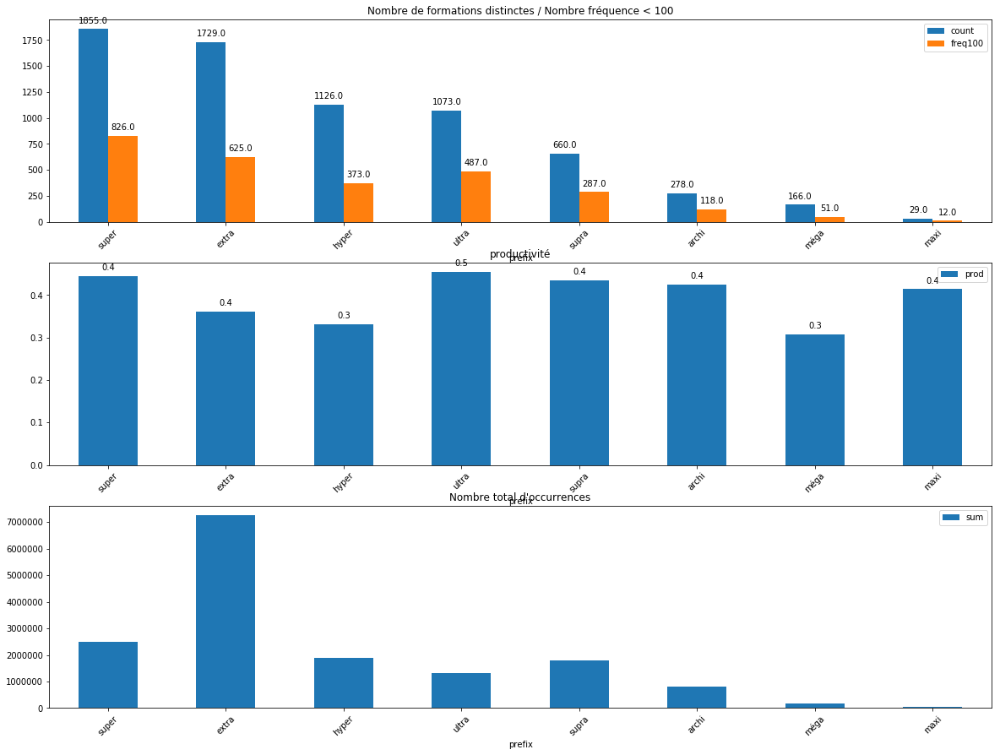

In [97]:
# calcul productivité
def freq100(x):
    #print(x)
    return len(x[x<100])
df2 = df.groupby(['prefix'])['full_count'].agg(['count','sum',freq100]).sort_values('count', ascending=False)

df2['prod'] = df2['freq100'] / df2['count']
print(df2)
fig, ax = plt.subplots(3, figsize=(20, 15))
df2[['count','freq100']].plot(kind="bar", ax=ax[0], rot=45, title="Nombre de formations distinctes / Nombre fréquence < 100",legend=True)
add_value_labels(ax[0])
df2[['prod']].plot(kind="bar",ax=ax[1], rot=45, title="productivité")

df2[['sum']].plot(kind="bar",ax=ax[2], rot=45, title="Nombre total d'occurrences")
add_value_labels(ax[1])
#df2[['freq1']].plot(kind="bar",ax=ax[0][0], rot=45, title="Nombre de formations de fréquence 1")
#df2[['prod']].plot(kind="bar",ax=ax[1][1], rot=45, title="Taux de fréquence 1 / nombre total")


In [63]:
# for neoveille visualization of results
print(df_rel.columns)
periods = [elt for elt in columns if re.match("[0-9]{4}", elt)]
df5 =  df_rel.copy(deep=True)
df5tmp = df5[periods]
df5tmp2 = df5[['string','prefix','word','sep']]
#print(df5tmp.info())
#print(df5tmp2.info())

df6 = df5tmp.merge(df5tmp2, right_index = True, left_index = True)
#print(df6.head())
df7 = df6.melt(id_vars = ['string','prefix','word','sep'], value_name = "rel_freq").dropna()
df7.rename(index=str, columns={"variable": "year"}, inplace=True)
df7 = df7[df7.rel_freq > 0]
print(df7.info())
print(df7.head())
df7.to_csv("../tmp/df_googlengrams_neoveille_nopos.csv", index=False)

NameError: name 'df_rel' is not defined

In [98]:
    # remove those obvious outliers...
    df = df[~df.word.str.contains(r"^[A-Z]|^conservate$")]
    df_rel = df_rel[~df_rel.word.str.contains(r"^[A-Z]|^conservate$")]
    #df = df[~df.word.isin(['Bowl','héros','Mario','Cacher','conservate','League','Rugby'])]
#    dfw = dfw[~dfw.word.isin(['Bowl','héros'])]
#    df_rel = df_rel[~df_rel.word.isin(['Bowl','héros'])]
    # base for browsing words
    words = df.groupby('word')['full_count'].agg(['count','sum']).sort_values('sum', ascending=False)
    print(words.head())
    words20 = list(words.index.values)[0:20]
    print(list(words.index.values)[0:20])

    
    

            count        sum
word                        
                8  3937843.0
ordinaire       3  3713273.0
ordinaires      3  1630606.0
position        6   340751.0
trophie         2   336663.0
['', 'ordinaire', 'ordinaires', 'position', 'trophie', 'tension', 'structure', 'diacre', 'posent', 'duchesse', 'ducs', 'violets', 'marchés', 'tectonique', 'structures', 'marché', 'phosphate', 'nationale', 'posant', 'plasie']


super
word                  abondance  abondant  abondante  acide
1800-12-31  0.206094   0.000000  0.000000   0.000000    0.0
1805-12-31  1.801786   0.000000  0.000000   0.000000    0.0
1810-12-31  2.217321   0.000000  0.001022   0.000000    0.0
1815-12-31  2.909755   0.000000  0.000000   0.000000    0.0
1820-12-31  1.930762   0.002022  0.000000   0.000783    0.0
word             abondance  abondant  abondante  acide
1800-12-31  NaN        NaN       NaN        NaN    NaN
1805-12-31  0.0        0.0       0.0        0.0    0.0
1810-12-31  0.0        0.0       1.0        0.0    0.0
1815-12-31  0.0        0.0      -1.0        0.0    0.0
1820-12-31  0.0        1.0       0.0        1.0    0.0
word             abondance  abondant  abondante  acide
1800-12-31  NaN        NaN       NaN        NaN    NaN
1805-12-31  0.0        0.0       0.0        0.0    0.0
1810-12-31  0.0        0.0       1.0        0.0    0.0
1815-12-31  0.0        0.0      -1.0        0.0    0.0
1820-12-31  0.0        1.0   

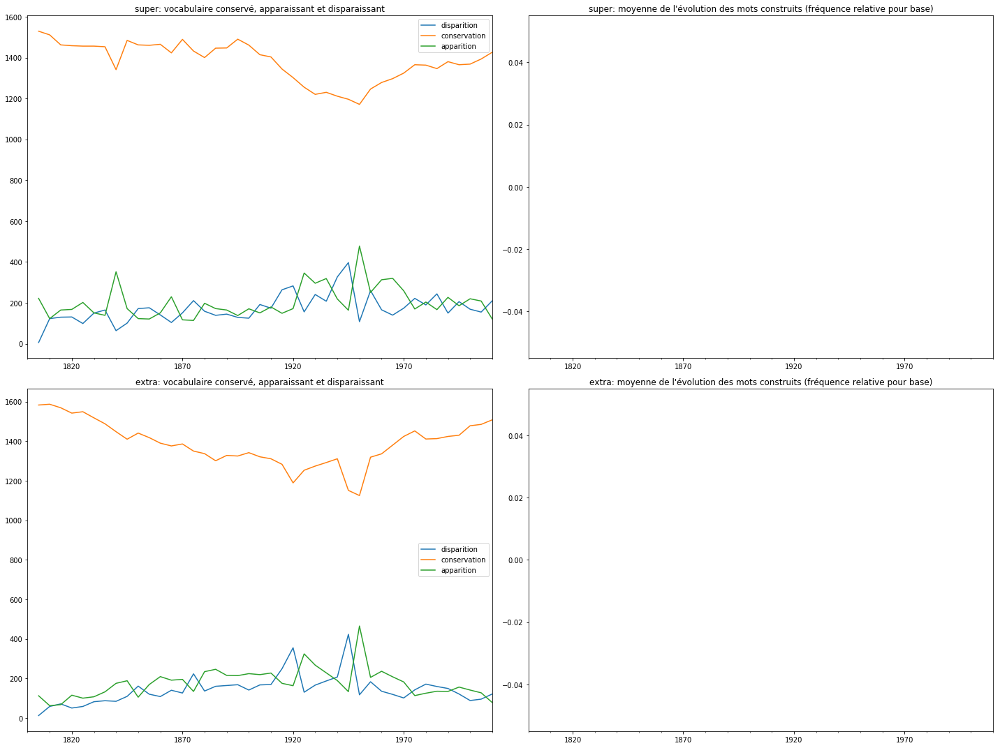

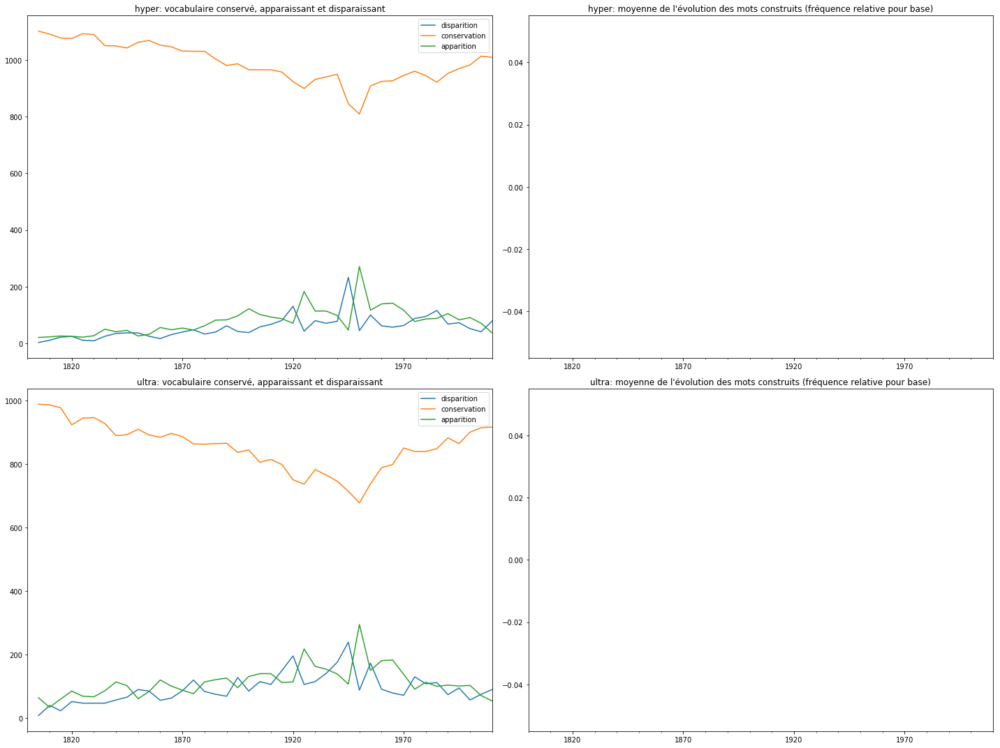

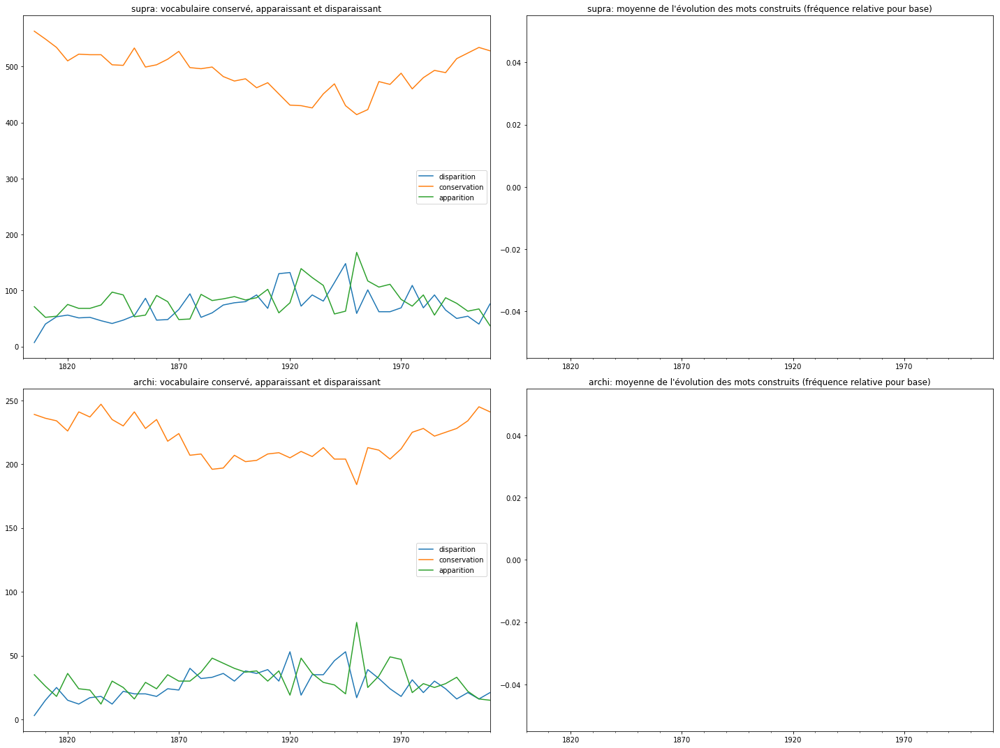

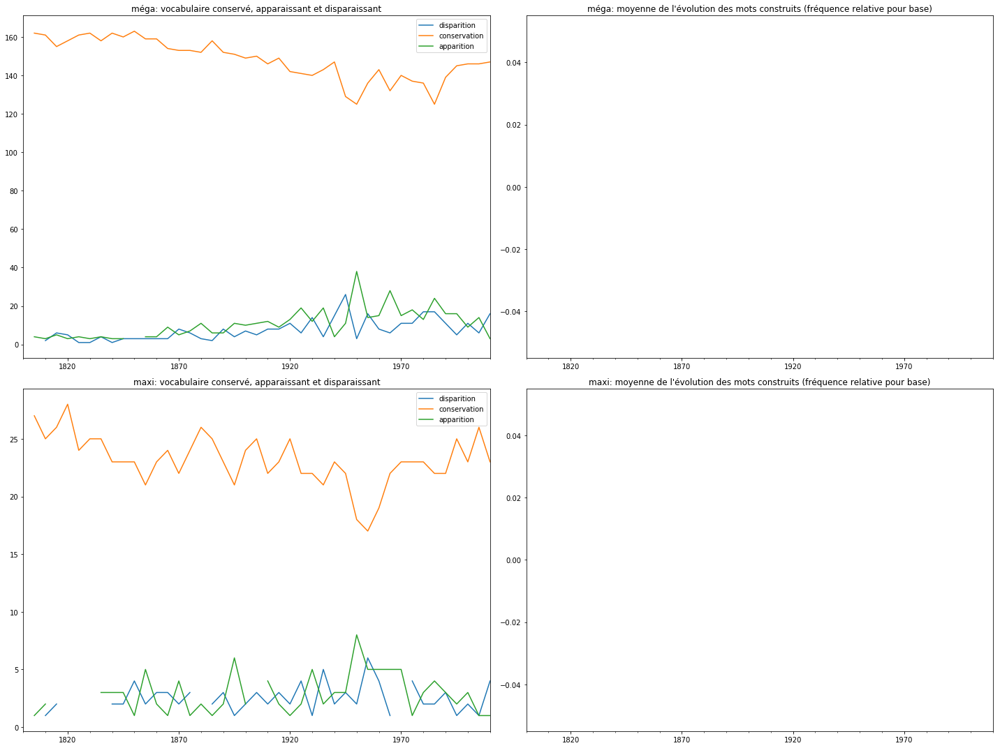

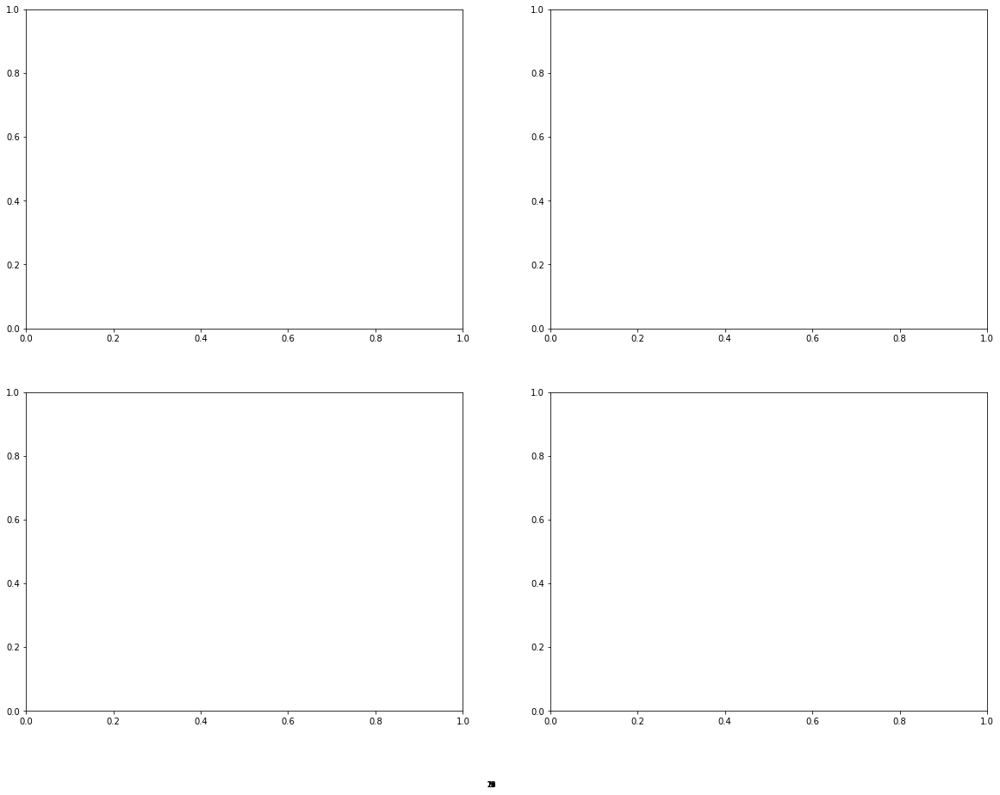

In [129]:
corpus = "googlengrams"
pdf2 = PdfPages('./results/Prefix_all_noPOS_synthesis_' + corpus+ '.pdf')

#columns = df.columns
#periods = [elt for elt in columns if re.match("[0-9]{4}-[0-9]{2}-[0-9]{2}", elt)]

# distribution entre les prefixes
fig, ax = plt.subplots(2, figsize=(20, 15))
df.groupby('prefix')['full_count'].count().plot(ax=ax[0],kind="bar",title='Distribution des fréquences entre préfixes (nbre de formations distinctes)', rot=45, figsize=(20,10))  # [['full_count']]
add_value_labels(ax[0])
df.groupby('prefix')['full_count'].sum().plot(ax=ax[1],kind="bar",title="Distribution des fréquences entre préfixes (nbre total d'occurrences)", rot=45, figsize=(20,10))  # [['full_count']]
add_value_labels(ax[1])
fig.text(4.25/8.5, 0.5/11., pdf2.get_pagecount(), ha='center', va='center', fontsize=8)
fig.tight_layout()

pdf2.savefig()
plt.close()

# distribution entre les mots
fig, ax = plt.subplots(2, figsize=(20, 15))
#df.groupby('source')['full_count'].nlargest(20).count().plot(ax=ax[0],kind="bar",title='Distribution des fréquences entre sources (nbre de formations distinctes)', rot=45, figsize=(20,10))  # [['full_count']]
df[df.word.isin(words20)].groupby('word')['full_count'].count().plot(ax=ax[0],kind="bar",title='Distribution des fréquences entre mots (20) (nbre de formations distinctes)', rot=45, figsize=(20,10))  # [['full_count']]
add_value_labels(ax[0])
df[df.word.isin(words20)].groupby('word')['full_count'].sum().plot(ax=ax[1],kind="bar",title="Distribution des fréquences entre mots (20) (nbre total d'occurrences)", rot=45, figsize=(20,10))  # [['full_count']]
add_value_labels(ax[1])
fig.text(4.25/8.5, 0.5/11., pdf2.get_pagecount(), ha='center', va='center', fontsize=8)
fig.tight_layout()

pdf2.savefig()
plt.close()

# distribution entre les séparateurs
fig, ax = plt.subplots(2, figsize=(20, 15))
df.groupby('sep')['full_count'].count().plot(ax=ax[0],kind="bar",title='Distribution des fréquences entre séparateurs  (nbre de formations distinctes)', rot=45, figsize=(20,10))  # [['full_count']]
add_value_labels(ax[0])
df.groupby('sep')['full_count'].sum().plot(ax=ax[1],kind="bar",title="Distribution des fréquences entre séparateurs  (nbre total d'occurrences)", rot=45, figsize=(20,10))  # [['full_count']]
add_value_labels(ax[1])
fig.text(4.25/8.5, 0.5/11., pdf2.get_pagecount(), ha='center', va='center', fontsize=8)
fig.tight_layout()

pdf2.savefig()
plt.close()




# distribution plots
fig, ax = plt.subplots(8,3, figsize=(20, 15))
# get 0.9 quantile
i = 0
for pref in dist1.index.values:
        dfplot = df[df.prefix == pref]
        sns.distplot(dfplot['full_count'], ax=ax[i][0]).set_title('{} : {} formes distinctes, {} total occurrences (100%)'.format(pref, dist1.loc[pref,'count'], dist1.loc[pref,'sum']))
        # get 0.95 quantile
        q = dfplot["full_count"].quantile(0.9)
        dfplot2 = dfplot[dfplot["full_count"] < q]['full_count']      
        sns.distplot(dfplot2, ax=ax[i][1]).set_title(pref + ' : 90% quantiles')
        #sns.distplot(np.log(dfplot), ax=ax[0])
        sns.boxplot(dfplot2,ax=ax[i][2]).set_title(pref + ' : 90% quantiles')
        i=i+1
fig.text(4.25/8.5, 0.5/11., pdf2.get_pagecount(), ha='center', va='center', fontsize=8)
fig.tight_layout()
pdf2.savefig()
plt.close()         

q = df["full_count"].quantile(0.9)
dfplot2 = df[df["full_count"] < q]      

sns.boxplot(x="prefix", y="full_count", data=dfplot2).set_title("Boîte à moustache des préfixes (fréquences absolues, 90% quantile)")
    # +  (TBD) kind= violin, box, boxen...
pdf2.savefig()
plt.close()


# evolution globale pour chaque préfixe
dfplot = df.groupby('prefix')[periods].sum().T
dfplot.index = pd.to_datetime(dfplot.index)
dfplot_rel = df_rel.groupby('prefix')[periods].sum().T
# freq absolue
fig, ax = plt.subplots(1, figsize=(20, 15))
dfplot.plot(ax=ax,kind="line", title="Evolution des distributions des préfixes (fréquence absolue, périodisation originelle)", rot=45, figsize=(20,10))  # [['full_count']]    
fig.text(4.25/8.5, 0.5/11., pdf2.get_pagecount(), ha='center', va='center', fontsize=8)
pdf2.savefig()
plt.close()


# freq rel
fig, ax = plt.subplots(1, figsize=(20, 15))
dfplot_rel.plot(ax=ax,kind="line", title="Evolution des distributions des préfixes (fréquence relative)", rot=45, figsize=(20,10))  # [['full_count']]    
fig.text(4.25/8.5, 0.5/11., pdf2.get_pagecount(), ha='center', va='center', fontsize=8)
pdf2.savefig()
plt.close()


# freq rel
fig, ax = plt.subplots(1, figsize=(20, 15))
dfplot_rel.ewm(span = 10).mean().plot(ax=ax,kind="line", title="Evolution des distributions des préfixes (fréquence relative), Lissage 10 ans", rot=45, figsize=(20,10))  # [['full_count']]    
fig.text(4.25/8.5, 0.5/11., pdf2.get_pagecount(), ha='center', va='center', fontsize=8)
pdf2.savefig()
plt.close()



# evolution nbre de mots distincts
fig, ax = plt.subplots(1, figsize=(20, 15))
for k,grp in df_rel.groupby(['prefix']):
    grp[periods].astype(bool).sum(axis=0).T.plot(legend=True, ax=ax,kind="line", title="Evolution du nombre de formes différentes", rot=45, figsize=(20,10))  # [['full_count']]
fig.text(4.25/8.5, 0.5/11., pdf2.get_pagecount(), ha='center', va='center', fontsize=8)
pdf2.savefig()
plt.close()


# evolution globale pour chaque mots
fig, ax = plt.subplots(1, figsize=(20, 15))
dfplot = df[df.word.isin(words20)].groupby('word')[periods].sum().T
dfplot.index = pd.to_datetime(dfplot.index)
dfplot_rel = df_rel[df_rel.word.isin(words20)].groupby('word')[periods].sum().T
dfplot4=dfplot.resample('5A').sum()
#dfplot.plot(legend=None, ax=ax[0],kind="line", title="Evolution des distributions des mots (fréquence absolue, périodisation originelle)", rot=45, figsize=(20,10))  # [['full_count']]    
#dfplot4.plot(legend=None, ax=ax[1],kind="line", title="Evolution des distributions des mots (fréquence absolue, période 5 ans)", rot=45, figsize=(20,10))  # [['full_count']]    
dfplot_rel.plot(ax=ax,kind="line", title="Evolution des distributions des mots (fréquence relative)", rot=45, figsize=(20,10))  # [['full_count']]    
fig.text(4.25/8.5, 0.5/11., pdf2.get_pagecount(), ha='center', va='center', fontsize=8)
fig.tight_layout()
pdf2.savefig()
plt.close()


# evolution globale pour chaque séparateur
fig, ax = plt.subplots(1, figsize=(20, 15))
dfplot = df.groupby('sep')[periods].sum().T
dfplot.index = pd.to_datetime(dfplot.index)
dfplot_rel = df_rel.groupby('sep')[periods].sum().T
dfplot4=dfplot.resample('5A').sum()
#dfplot.plot(legend=None, ax=ax[0],kind="line", title="Evolution des distributions des séparateurs (fréquence absolue, périodisation originelle)", rot=45, figsize=(20,10))  # [['full_count']]    
#dfplot4.plot(legend=None, ax=ax[1],kind="line", title="Evolution des distributions des séparateurs (fréquence absolue, période 5 ans)", rot=45, figsize=(20,10))  # [['full_count']]    
dfplot_rel.plot(ax=ax,kind="line", title="Evolution des distributions des séparateurs (fréquence relative)", rot=45, figsize=(20,10))  # [['full_count']]    
fig.text(4.25/8.5, 0.5/11., pdf2.get_pagecount(), ha='center', va='center', fontsize=8)
fig.tight_layout()
pdf2.savefig()
plt.close()




# get 0.9 quantile
i = 0
fig, ax = plt.subplots(2,2, figsize=(20, 15))
for pref in dist1.index.values:
    print(pref)
    dfplot3 = df_rel[df_rel.prefix == pref].set_index('word')[periods].T
    dfplot3.index = pd.to_datetime(dfplot3.index)
    dfplot4=dfplot3.resample('5y').sum()
    print(dfplot4.iloc[0:5,0:5])
    #print(np.log(dfplot4.iloc[0:5,0:5]))
    dfplotdiffres = (dfplot4/1000).apply(np.ceil).diff()
    print(dfplotdiffres.iloc[0:5,0:5])
    dfplotdiffres = dfplotdiffres.loc[:, (dfplotdiffres != 0).any(axis=0)]
    print(dfplotdiffres.iloc[0:5,0:5])
    dfdiffok = dfplotdiffres.apply(lambda x : x.value_counts(), axis=1)
    dfdiffok.rename(columns={-1.0:'disparition',
                          0.0:'conservation',
                          1.0:'apparition'}, 
                 inplace=True)
    print(dfdiffok.iloc[0:5,0:5])
    dfdiffok.plot(ax=ax[i][0], title=pref + ": vocabulaire conservé, apparaissant et disparaissant")

    dfplotdiffres['mean_diff'] = dfplot3.diff().apply(lambda x : x.mean(), axis=1)
    dfplotdiffres['mean_diff'].plot(ax=ax[i][1], title=pref + ": moyenne de l'évolution des mots construits (fréquence relative pour base)")

    if i==1:
        fig.tight_layout()
        pdf2.savefig()
        fig, ax = plt.subplots(2,2, figsize=(20, 15))
        i=0
    else:
        i=i+1
        
 




# moving average, trends etc.
df5 = df_rel.groupby('prefix').sum()[periods]
for pref in dist1.index.values : #df5.index.values:
    series = df5.loc[pref]
    #series.index = series.index.resample("W", how='sum')
    ts = pd.DataFrame({'data':series.values}, index=series.index) # 'year':seriesrel.index, 

    ts['z_data'] = (ts['data'] - ts.data.rolling(window=10).mean()) / ts.data.rolling(window=10).std()
    #ts['zp_data'] = ts['z_data'] - ts['z_data'].shift(10)
    plot_rolling_simple(ts,title= pref, window=10)
    fig.text(4.25/8.5, 0.5/11., pdf2.get_pagecount(), ha='center', va='center', fontsize=8)
    pdf2.savefig()
    plt.close()
pdf2.close()



super
word                  abondance  abondant  abondante  acide
1800-12-31  0.206094   0.000000  0.000000   0.000000    0.0
1805-12-31  1.801786   0.000000  0.000000   0.000000    0.0
1810-12-31  2.217321   0.000000  0.001022   0.000000    0.0
1815-12-31  2.909755   0.000000  0.000000   0.000000    0.0
1820-12-31  1.930762   0.002022  0.000000   0.000783    0.0
word             abondance  abondant  abondante  acide
1800-12-31  NaN        NaN       NaN        NaN    NaN
1805-12-31  0.0        0.0       0.0        0.0    0.0
1810-12-31  0.0        0.0       1.0        0.0    0.0
1815-12-31  0.0        0.0      -1.0        0.0    0.0
1820-12-31  0.0        1.0       0.0        1.0    0.0
word             abondance  abondant  abondante  acide
1800-12-31  NaN        NaN       NaN        NaN    NaN
1805-12-31  0.0        0.0       0.0        0.0    0.0
1810-12-31  0.0        0.0       1.0        0.0    0.0
1815-12-31  0.0        0.0      -1.0        0.0    0.0
1820-12-31  0.0        1.0   

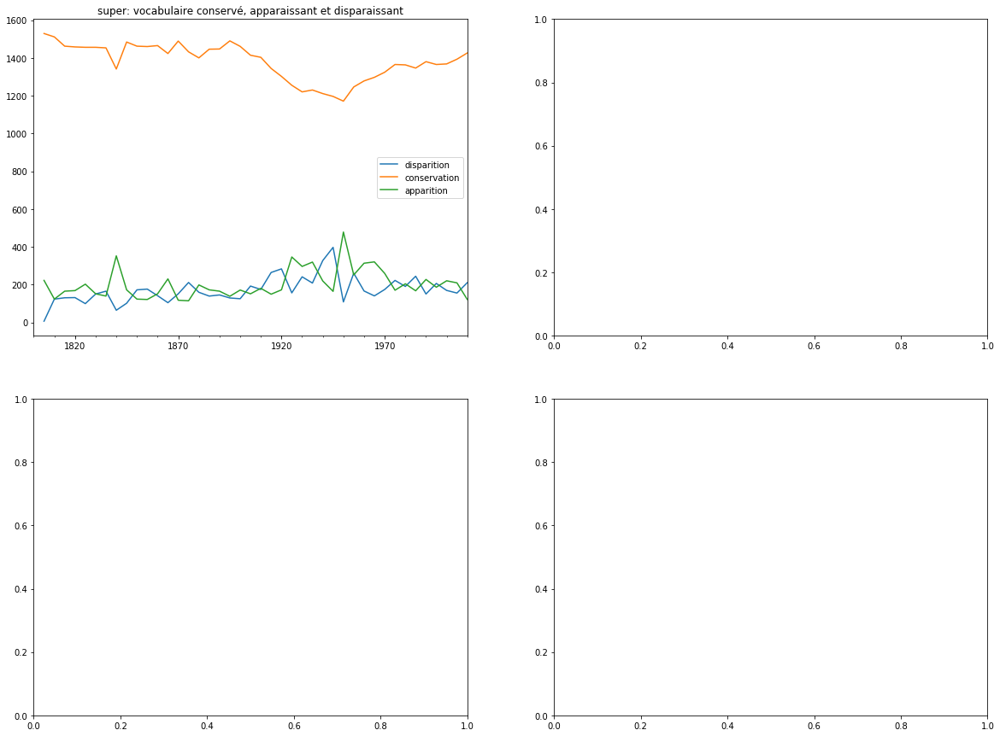

extra
word                  abdominale  africaine  africaines  africains
1800-12-31  0.184454    0.000000        0.0         0.0        0.0
1805-12-31  0.983453    0.000849        0.0         0.0        0.0
1810-12-31  1.330005    0.000000        0.0         0.0        0.0
1815-12-31  1.507351    0.000000        0.0         0.0        0.0
1820-12-31  1.518694    0.000911        0.0         0.0        0.0
word             abdominale  africaine  africaines  africains
1800-12-31  NaN         NaN        NaN         NaN        NaN
1805-12-31  0.0         1.0        0.0         0.0        0.0
1810-12-31  0.0        -1.0        0.0         0.0        0.0
1815-12-31  0.0         0.0        0.0         0.0        0.0
1820-12-31  0.0         1.0        0.0         0.0        0.0
word             abdominale  africaine  africaines  africains
1800-12-31  NaN         NaN        NaN         NaN        NaN
1805-12-31  0.0         1.0        0.0         0.0        0.0
1810-12-31  0.0        -1.0       

In [128]:
# get 0.9 quantile
i = 0
fig, ax = plt.subplots(2,2, figsize=(20, 15))
for pref in dist1.index.values:
    print(pref)
    dfplot3 = df_rel[df_rel.prefix == pref].set_index('word')[periods].T
    dfplot3.index = pd.to_datetime(dfplot3.index)
    dfplot4=dfplot3.resample('5y').sum()
    print(dfplot4.iloc[0:5,0:5])
    #print(np.log(dfplot4.iloc[0:5,0:5]))
    dfplotdiffres = (dfplot4/1000).apply(np.ceil).diff()
    print(dfplotdiffres.iloc[0:5,0:5])
    dfplotdiffres = dfplotdiffres.loc[:, (dfplotdiffres != 0).any(axis=0)]
    print(dfplotdiffres.iloc[0:5,0:5])
    dfdiffok = dfplotdiffres.apply(lambda x : x.value_counts(), axis=1)
    dfdiffok.rename(columns={-1.0:'disparition',
                          0.0:'conservation',
                          1.0:'apparition'}, 
                 inplace=True)
    print(dfdiffok.iloc[0:5,0:5])
    dfdiffok.plot(ax=ax[i][0], title=pref + ": vocabulaire conservé, apparaissant et disparaissant")
    plt.show()
#    dfplotdiffres['mean_diff'] = dfplot3.diff().apply(lambda x : x.mean(), axis=1)
#    dfplotdiffres['mean_diff'].plot(ax=ax[i][1], title=pref + ": moyenne de l'évolution des mots construits (fréquence relative pour base)")

    if i==1:
        fig.tight_layout()
        i=0
    else:
        i=i+1
        
 

In [118]:
### par préfixe

for pref in dist1.index.values:
    pdf2 = PdfPages('./results/' + pref + '_all_noPOS_synthesis_' + corpus + '.pdf')
    dfpref = df[df.prefix==pref]
    dfwpref = df_rel[df_rel.prefix==pref]
    dfpref_rel = df_rel[df_rel.prefix==pref]

    words = dfpref.groupby('word')['full_count'].agg(['count','sum']).sort_values('sum', ascending=False)
   # print(sources)
    words20pref = list(words.index.values)[0:20]
    #print(list(sources.index.values)[0:20])    

    
    # distribution 
    fig, ax = plt.subplots(2, figsize=(20, 15))
    dfpref.groupby('prefix')['full_count'].count().plot(ax=ax[0],kind="bar",title=pref + ' : distribution des fréquences (nbre de formations distinctes)', rot=45, figsize=(20,10))  # [['full_count']]
    add_value_labels(ax[0])
    dfpref.groupby('prefix')['full_count'].sum().plot(ax=ax[1],kind="bar",title=pref + " : distribution des fréquences (nbre total d'occurrences)", rot=45, figsize=(20,10))  # [['full_count']]
    add_value_labels(ax[1])
    fig.text(4.25/8.5, 0.5/11., pdf2.get_pagecount(), ha='center', va='center', fontsize=8)
    fig.tight_layout()

    pdf2.savefig()
    plt.close()

    
    
    # distribution entre les mots générés les plus fréquents d'informations
    fig, ax = plt.subplots(2, figsize=(20, 15))
    #df.groupby('source')['full_count'].nlargest(20).count().plot(ax=ax[0],kind="bar",title='Distribution des fréquences entre sources (nbre de formations distinctes)', rot=45, figsize=(20,10))  # [['full_count']]
    dfpref[df.word.isin(words20pref)].groupby('word')['full_count'].count().plot(ax=ax[0],kind="bar",title='Distribution des fréquences entre mots (20) (nbre de formations distinctes)', rot=45, figsize=(20,10))  # [['full_count']]
    add_value_labels(ax[0])
    dfpref[df.word.isin(words20pref)].groupby('word')['full_count'].sum().plot(ax=ax[1],kind="bar",title="Distribution des fréquences entre mots (20) (nbre total d'occurrences)", rot=45, figsize=(20,10))  # [['full_count']]
    add_value_labels(ax[1])
    fig.text(4.25/8.5, 0.5/11., pdf2.get_pagecount(), ha='center', va='center', fontsize=8)
    fig.tight_layout()
    
    pdf2.savefig()
    plt.close()
    
    # distribution entre les séparateurs de mots
    fig, ax = plt.subplots(2, figsize=(20, 15))
    #df.groupby('source')['full_count'].nlargest(20).count().plot(ax=ax[0],kind="bar",title='Distribution des fréquences entre sources (nbre de formations distinctes)', rot=45, figsize=(20,10))  # [['full_count']]
    dfpref.groupby('sep')['full_count'].count().plot(ax=ax[0],kind="bar",title='Distribution des fréquences entre séparateurs  (nbre de formations distinctes)', rot=45, figsize=(20,10))  # [['full_count']]
    add_value_labels(ax[0])
    dfpref.groupby('sep')['full_count'].sum().plot(ax=ax[1],kind="bar",title="Distribution des fréquences entre séparateurs  (nbre total d'occurrences)", rot=45, figsize=(20,10))  # [['full_count']]
    add_value_labels(ax[1])
    fig.text(4.25/8.5, 0.5/11., pdf2.get_pagecount(), ha='center', va='center', fontsize=8)
    fig.tight_layout()
    
    pdf2.savefig()
    plt.close()
  
    
    # distribution plots
    fig, ax = plt.subplots(3, figsize=(20, 15))
    dfplot = dfpref
    sns.distplot(dfplot['full_count'], ax=ax[0]).set_title('{} : {} formes distinctes, {} total occurrences (100%)'.format(pref, dist1.loc[pref,'count'], dist1.loc[pref,'sum']))
    # get 0.95 quantile
    q = dfplot["full_count"].quantile(0.9)
    dfplot2 = dfplot[dfplot["full_count"] < q]['full_count']      
    sns.distplot(dfplot2, ax=ax[1]).set_title(pref + ' : 90% quantiles')
    #sns.distplot(np.log(dfplot), ax=ax[0])
    sns.boxplot(dfplot2,ax=ax[2]).set_title(pref + ' : 90% quantiles')
    fig.text(4.25/8.5, 0.5/11., pdf2.get_pagecount(), ha='center', va='center', fontsize=8)
    fig.tight_layout()
    pdf2.savefig()
    plt.close()         
    
    
    
    # evolution globale pour chaque préfixe
    dfplot = dfpref[periods].sum().T
    dfplot.index = pd.to_datetime(dfplot.index)
    dfplot_rel = dfpref_rel[periods].sum().T
    # freq absolue
    fig, ax = plt.subplots(1, figsize=(20, 15))
    dfplot.plot(ax=ax,kind="line", title=pref + " : évolution des distributions des préfixes (fréquence absolue, périodisation originelle)", rot=45, figsize=(20,10))  # [['full_count']]    
    fig.text(4.25/8.5, 0.5/11., pdf2.get_pagecount(), ha='center', va='center', fontsize=8)
    pdf2.savefig()
    plt.close()
    
    
    # freq rel
    fig, ax = plt.subplots(1, figsize=(20, 15))
    dfplot_rel.plot(ax=ax,kind="line", title=pref + " : évolution des distributions des préfixes (fréquence relative)", rot=45, figsize=(20,10))  # [['full_count']]    
    fig.text(4.25/8.5, 0.5/11., pdf2.get_pagecount(), ha='center', va='center', fontsize=8)
    pdf2.savefig()
    plt.close()
    
    # evolution nbre de mots distincts
    fig, ax = plt.subplots(1, figsize=(20, 15))
    dfpref[periods].astype(bool).sum(axis=0).T.plot(ax=ax,kind="line", title=pref + " : évolution du nombre de formes différentes", rot=45, figsize=(20,10))  # [['full_count']]
    fig.text(4.25/8.5, 0.5/11., pdf2.get_pagecount(), ha='center', va='center', fontsize=8)
    pdf2.savefig()
    plt.close()
    
     # evolution globale pour chaque mot
    fig, ax = plt.subplots(1, figsize=(20, 15))
    dfplot = dfpref[dfpref.word.isin(words20pref)].groupby('word')[periods].sum().T
    dfplot.index = pd.to_datetime(dfplot.index)
    dfplot_rel = dfpref_rel[dfpref_rel.word.isin(words20pref)].groupby('word')[periods].sum().T
    dfplot4=dfplot.resample('5A').sum()
#    dfplot.plot(legend=None, ax=ax[0],kind="line", title="Evolution des distributions des mots (fréquence absolue, périodisation originelle)", rot=45, figsize=(20,10))  # [['full_count']]    
#    dfplot4.plot(legend=None, ax=ax[1],kind="line", title="Evolution des distributions des mots (fréquence absolue, période 5 ans)", rot=45, figsize=(20,10))  # [['full_count']]    
    dfplot_rel.plot(ax=ax,kind="line", title=pref + " : évolution des distributions des mots (fréquence relative)", rot=45, figsize=(20,10))  # [['full_count']]    
    fig.text(4.25/8.5, 0.5/11., pdf2.get_pagecount(), ha='center', va='center', fontsize=8)
    fig.tight_layout()
    pdf2.savefig()
    plt.close()
    
     # evolution globale pour chaque séparateur
    fig, ax = plt.subplots(1, figsize=(20, 15))
    dfplot = dfpref.groupby('sep')[periods].sum().T
    dfplot.index = pd.to_datetime(dfplot.index)
    dfplot_rel = dfpref_rel.groupby('sep')[periods].sum().T
    dfplot4=dfplot.resample('5A').sum()
    #dfplot.plot(legend=None, ax=ax[0],kind="line", title="Evolution des distributions des séparateurs (fréquence absolue, périodisation originelle)", rot=45, figsize=(20,10))  # [['full_count']]    
    #dfplot4.plot(legend=None, ax=ax[1],kind="line", title="Evolution des distributions des séparateurs (fréquence absolue, période 5 ans)", rot=45, figsize=(20,10))  # [['full_count']]    
    dfplot_rel.plot(ax=ax,kind="line", title=pref + " : évolution des distributions des séparateurs (fréquence relative)", rot=45, figsize=(20,10))  # [['full_count']]    
    fig.text(4.25/8.5, 0.5/11., pdf2.get_pagecount(), ha='center', va='center', fontsize=8)
    fig.tight_layout()
    pdf2.savefig()
    plt.close()
    
  
    
    # get 0.9 quantile
    fig, ax = plt.subplots(2, figsize=(20, 15))
    dfplot3 = dfpref_rel.set_index('word')[periods].T
    dfplot3.index = pd.to_datetime(dfplot3.index)
    dfplotdiffres = dfplot3.apply(np.ceil).diff()

    dfdiffok = dfplotdiffres.apply(lambda x : x.value_counts(), axis=1)
    dfdiffok.rename(columns={-1.0:'disparition',
                          0.0:'conservation',
                          1.0:'apparition'}, 
                 inplace=True)
    #print(dfdiffok)
    dfdiffok.plot(ax=ax[0], title=pref + ": vocabulaire conservé, apparaissant et disparaissant")

    dfplotdiffres['mean_diff'] = dfplot3.diff().apply(lambda x : x.mean(), axis=1)
    dfplotdiffres['mean_diff'].plot(ax=ax[1], title=pref + ": moyenne de l'évolution des mots construits (fréquence relative pour base)")

    fig.tight_layout()
    pdf2.savefig()
    plt.close()
    
    
    # moving average, trends etc.
    df5 = dfpref_rel.groupby('prefix').sum()[periods]
    series = df5.loc[pref]
    #series.index = series.index.resample("W", how='sum')
    ts = pd.DataFrame({'data':series.values}, index=series.index) # 'year':seriesrel.index, 

    ts['z_data'] = (ts['data'] - ts.data.rolling(window=10).mean()) / ts.data.rolling(window=10).std()
    #ts['zp_data'] = ts['z_data'] - ts['z_data'].shift(10)
    plot_rolling_simple(ts,title= pref, window=10)
    fig.text(4.25/8.5, 0.5/11., pdf2.get_pagecount(), ha='center', va='center', fontsize=8)
    pdf2.savefig()
    plt.close()
    
    pdf2.close()



/Users/emmanuelcartier/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:32: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
/Users/emmanuelcartier/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:34: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
/Users/emmanuelcartier/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:32: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
/Users/emmanuelcartier/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:34: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
/Users/emmanuelcartier/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:32: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
/Users/emmanuelcartier/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:34: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
/Users/emmanuelcartier

In [79]:
# In[479]:


#print(df.head())
save_report(df, 'prefix','prefixes_' + corpus + '_nopos.xls')



True

In [80]:
# ## With Plotly




# with plotly
import plotly.plotly as py
import plotly.tools as pytools
import plotly.graph_objs as go
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
init_notebook_mode(connected=False)
#pytools.set_credentials_file(username='ecartierdijon', api_key='3msHhM6RjRcAvIpAgcz6')
#help(py.plot) max 25 public graphs
# evolution globale pour chaque préfixe
#fig, ax = plt.subplots(3, figsize=(20, 15))
#df.groupby('prefix')[periods].sum().T.plot(ax=ax[0],kind="line", title="Evolution des distributions des préfixes (fréquence absolue)", rot=45, figsize=(20,10))  # [['full_count']]    
#df_rel.groupby('prefix')[periods].sum().T.plot(ax=ax[1],kind="line", title="Evolution des distributions des préfixes (fréquence relative)", rot=45, figsize=(20,10))  # [['full_count']]    
#for k,grp in df.groupby(['prefix']):
#    grp[periods].astype(bool).sum(axis=0).T.plot(ax=ax[2],kind="line", title="Evolution des nombres de formes différentes par année", rot=45, figsize=(20,10))  # [['full_count']]
#plt.show()




# frequence relative
filename = "./plotly_graphs/Evolution_relative-prefixes_nopos_" + corpus + ".html"
group_data = df_rel.groupby('prefix').sum()
df6 = group_data[periods].T
#print(df6.head())
data = []
for pref in df6.columns.values:
    linegraph = go.Scatter(
        x=df6.index,
        y=df6[pref],
        name = pref,
        #line = dict(color = '#17BECF'),
        opacity = 0.8)
    data.append(linegraph)

layout = dict(
    title='Evolution des fréquences relatives de 1800-2010 : ' + corpus,
    xaxis=dict(
        rangeslider=dict(
            visible = True
        ),
        type='date'
    )
)

fig = dict(data=data, layout=layout)
plot(fig, filename = filename) 


'./plotly_graphs/Evolution_relative-prefixes_nopos_googlengrams.html'

In [81]:
# with plotly -  for more flexibility, use Dash!
import plotly.plotly as py
import plotly.tools as pytools
import plotly.graph_objs as go
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
init_notebook_mode(connected=False)
#pytools.set_credentials_file(username='ecartierdijon', api_key='3msHhM6RjRcAvIpAgcz6')
#help(py.plot) max 25 public graphs

figs = {}
#prefs = ('ultra','super','hyper','hypra','extra','méga','archi','maxi','supra')
# data
i = 0
for pref in dist1.index.values:
        print(pref)
        #if df[df.prefix.str.contains(pref)].word.count() > 0:
        i = i + 1
        dfplot = df[df.prefix.str.contains(pref)].sort_values('full_count', ascending=False).groupby('word').sum() #.set_index('word') # .head(30)
        total_words = len(dfplot.index)
        print(total_words)
        total_occ = dfplot['full_count'].sum()
        print(total_occ)
        dfplotT =  dfplot[periods].T # .groupby('word').sum()
        #print(dfplotT.info())
        #print(dfplotT.head())
        #plot(title= pref + " :  évolution des formations les plus fréquentes (30)")
        #print(dfplot)
        data = []
        for word in dfplotT.columns.values:
            nb_elts = dfplotT[word].sum(axis=0)
            #print(word,nb_elts)
            if nb_elts>3:
                linegraph = go.Scatter(
                    x=dfplotT.index,
                    y=dfplotT[word],
                    name = word,
                    #line = dict(color = '#17BECF'),
                    opacity = 0.8)
                #fig.append_trace(linegraph, i, 1)
                data.append(linegraph)
        print("Done with graphs generation!")

        layout = dict(
            title= pref + " : évolution des fréquences (>3) de 2016 à 2019 ("  + str(total_words) + ' mots distincts, ' + str(int(total_occ)) + ' occurrences)',
            xaxis=dict(
                rangeslider=dict(
                    visible = True
                ),
                type='date'
            )
        )

        #fig.append_trace(dict(data=data, layout=layout), i, 1)
        fig = dict(data=data, layout=layout)
        plot(fig, filename = "./plotly_graphs/Evolution-prefixes-" + pref + "-words-"+ corpus +".html") 
        #figs[pref]=fig
        
        
#for pref in figs.keys():
#    plot(figs[pref], filename = "./plotly_graphs/Evolution-prefixes-" + pref + "-words-neoveille.html") 

super
1462
3367913.0
Done with graphs generation!
extra
1214
7343097.0
Done with graphs generation!
hyper
966
2149238.0
Done with graphs generation!
ultra
774
1428266.0
Done with graphs generation!
supra
612
1799372.0
Done with graphs generation!
archi
201
1273500.0
Done with graphs generation!
méga
149
219957.0
Done with graphs generation!
maxi
25
38681.0
Done with graphs generation!


In [82]:
# with plotly -  for more flexibility, use Dash!
import plotly.plotly as py
import plotly.tools as pytools
import plotly.graph_objs as go
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
init_notebook_mode(connected=False)
#pytools.set_credentials_file(username='ecartierdijon', api_key='3msHhM6RjRcAvIpAgcz6')
#help(py.plot) max 25 public graphs

figs = {}
#prefs = ('ultra','super','hyper','hypra','extra','méga','archi','maxi','supra')
# data
i = 0
for pref in dist1.index.values:
        print(pref)
        #if df[df.prefix.str.contains(pref)].word.count() > 0:
        i = i + 1
        dfplot = df[df.prefix.str.contains(pref)].sort_values('full_count', ascending=False).groupby('sep').sum() #.set_index('word') # .head(30)
        total_words = len(dfplot.index)
        print(total_words)
        total_occ = dfplot['full_count'].sum()
        print(total_occ)
        dfplotT =  dfplot[periods].T # .groupby('word').sum()
        data = []
        for word in dfplotT.columns.values:
                linegraph = go.Scatter(
                    x=dfplotT.index,
                    y=dfplotT[word],
                    name = word,
                    #line = dict(color = '#17BECF'),
                    opacity = 0.8)
                #fig.append_trace(linegraph, i, 1)
                data.append(linegraph)
        print("Done with graphs generation!")

        layout = dict(
            title= pref + " : évolution des fréquences de séparateurs (>3) de 2016 à 2019 ("  + str(total_words) + ' sép. distincts, ' + str(int(total_occ)) + ' occurrences)',
            xaxis=dict(
                rangeslider=dict(
                    visible = True
                ),
                type='date'
            )
        )

        #fig.append_trace(dict(data=data, layout=layout), i, 1)
        fig = dict(data=data, layout=layout)
        plot(fig, filename = "./plotly_graphs/Evolution-prefixes-" + pref + "-sep-"+ corpus +".html") 
        #figs[pref]=fig
        
        
#for pref in figs.keys():
#    plot(figs[pref], filename = "./plotly_graphs/Evolution-prefixes-" + pref + "-words-neoveille.html") 

super
3
3367913.0
Done with graphs generation!
extra
3
7343097.0
Done with graphs generation!
hyper
3
2149238.0
Done with graphs generation!
ultra
3
1428266.0
Done with graphs generation!
supra
2
1799372.0
Done with graphs generation!
archi
3
1273500.0
Done with graphs generation!
méga
2
219957.0
Done with graphs generation!
maxi
3
38681.0
Done with graphs generation!


In [ ]:
# composante saisonnière
from statsmodels.tsa.seasonal import seasonal_decompose



for pref in df5.index.values:
    series = df5.loc[pref]
    data = pd.DataFrame({pref:series.values}, index=series.index) # 'year':seriesrel.index, 
    #print(data)

    res = seasonal_decompose(data[pref].as_matrix().ravel(), freq=7, two_sided=False)
    data["season"] = res.seasonal
    data["trendsea"] = res.trend
    data.plot(y=[pref, "season", "trendsea"], figsize=(20,10), title=pref + " : saisonnalité")
    pdf0.savefig()
    plt.close()
    data[-30:].plot(y=[pref, "season", "trendsea"], figsize=(20,10), title=pref + " : saisonnalité (30 dernières années)")
    pdf0.savefig()
    plt.close()
#pdf0.close()

In [ ]:
# autocorrelation
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
from statsmodels.tsa.stattools import periodogram
for pref in df5.index.values:
    series = df5.loc[pref]
    data = pd.DataFrame({pref:series.values}, index=series.index) # 'year':seriesrel.index, 
    #print(data)

    fig = plt.figure(figsize=(12,8))
    ax1 = fig.add_subplot(211)
    fig = plot_acf(data[pref], lags=40, ax=ax1)
    ax2 = fig.add_subplot(212)
    fig = plot_pacf(data[pref], lags=40, ax=ax2)
    fig.suptitle(pref + " : autocorrelation")
    pdf0.savefig()
    plt.close()
    p = periodogram(data[pref])
    plt.plot(p)
    pdf0.savefig()
    plt.close()

#pdf0.close()

In [ ]:
## Decompose in trend, seasonality and residual
from random import randrange
from pandas import Series
from matplotlib import pyplot
#fig, ax = plt.subplots(1,1,figsize = (20,20))
from statsmodels.tsa.seasonal import seasonal_decompose


for pref in df5.index.values:
    series = df5.loc[pref]
    df2 = pd.DataFrame({'data':series.values}, index=series.index) # 'year':seriesrel.index, 

    #series = [i+randrange(10) for i in range(1,100)]
    res = seasonal_decompose(df2, model='additive', freq=1)
    res.plot()
    pdf0.savefig()
    plt.close()
    pyplot.show()
    #res = seasonal_decompose(df2, model='multiplicative', freq=1)
    #res.plot()
    #pdf0.savefig()
    #plt.close()
    #pyplot.show()
    #print(result.trend)
    #print(result.seasonal)
    #print(result.resid)
    #print(result.observed)
pdf0.close()

# Load pos data

## 1 grams (prefword)

In [37]:
# 1-grams 

if os.path.isfile('../data/fre.prefixes.1.grams.pos.1799-2009.csv'):
    print("Loading the 1 gram big file (no pos)...")
    dfpos= pd.read_csv('../data/fre.prefixes.1.grams.pos.1799-2009.csv', header=0, sep=',', error_bad_lines=False)#, index_col=0 
else:
    print("Please first launch retrieve_google_1grams.py to generate fre.prefixes.1.grams.1799-2009.csv")
    exit()


dfpos.info()
dfpos.head()

print(len(dfpos[dfpos.string.isnull()]))


Loading the 1 gram big file (no pos)...
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8713 entries, 0 to 8712
Columns: 211 entries, string to 2009
dtypes: int64(210), object(1)
memory usage: 14.0+ MB
0


In [38]:

# ## create triple column (prefix - word - POS)
# élimination stoplist
#df = df[~df.string.isin(stoplist)]
# In[4]:

# 
pref_re = '^(ultra|super|hyper|hypra|extra|méga|archi|maxi|supra)(?:.*)_(?:.+)$'
pref_re2 = '^(?:ultra|super|hyper|hypra|extra|méga|archi|maxi|supra)(.*)_(?:.+)$'
pref_re3 = '^(?:ultra|super|hyper|hypra|extra|méga|archi|maxi|supra)(?:.*)_(.+)$'
pref_re4 = '^(.+)_(?:.+)$'
print(len(dfpos[dfpos.string.isnull()]),' formes nulles')
dfpos['prefix'] = dfpos.string.str.extract(pref_re, expand=True)
dfpos['word'] = dfpos.string.str.extract(pref_re2, expand=True)
dfpos['posGNG'] = dfpos.string.str.extract(pref_re3, expand=True)
dfpos['string'] = dfpos.string.str.extract(pref_re4, expand=True)
dfpos['sep'] = ""
print(dfpos.info())
print(len(dfpos[dfpos.word.isnull()]),' formes nulles')
#print(dfpos[dfpos.word==''].head())
print(len(dfpos[dfpos.string.isnull()]),' formes sans analyse')
dfpos = dfpos[~dfpos.word.isnull()]
print(dfpos.info())
dfpos = dfpos[~dfpos.string.isnull()]
print(dfpos.info())
#print(dfpos[['string','pos','prefix','word','sep']].head(20))
dfpos = dfpos[~dfpos.string.isin(stoplist)]
print(dfpos.info())
#dfpos.dropna(inplace=True)
dfpos = dfpos[~dfpos.word.str.contains(r"[0-9]", na=False)]
dfpos = dfpos[dfpos.word.str.contains(r"^(?:|s|\w{3,})$", na=True)]
print(dfpos.info())
print(dfpos.prefix.value_counts())

dfpos.to_csv("df_1grams_pos.csv")

0  formes nulles
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8713 entries, 0 to 8712
Columns: 215 entries, string to sep
dtypes: int64(210), object(5)
memory usage: 14.3+ MB
None
4700  formes nulles
4  formes sans analyse
<class 'pandas.core.frame.DataFrame'>
Int64Index: 4013 entries, 0 to 8712
Columns: 215 entries, string to sep
dtypes: int64(210), object(5)
memory usage: 6.6+ MB
None
<class 'pandas.core.frame.DataFrame'>
Int64Index: 4013 entries, 0 to 8712
Columns: 215 entries, string to sep
dtypes: int64(210), object(5)
memory usage: 6.6+ MB
None
<class 'pandas.core.frame.DataFrame'>
Int64Index: 802 entries, 1 to 8712
Columns: 215 entries, string to sep
dtypes: int64(210), object(5)
memory usage: 1.3+ MB
None
<class 'pandas.core.frame.DataFrame'>
Int64Index: 802 entries, 1 to 8712
Columns: 215 entries, string to sep
dtypes: int64(210), object(5)
memory usage: 1.3+ MB
None
hyper    239
super    164
extra     98
méga      85
archi     81
ultra     76
supra     50
maxi       9
Na

In [39]:
#words = dfpos.word.unique()
#print(words)
#for w in words:
#    if w in dico.keys():
#        print("dico : " + w + ":" + ",".join(set(dico[w])))
#    else:
#        print("no dico : " + w )
mapposGNG = {'ADP':'PREP','NOUN':'NOM','PRT':'ADJ','ADJ':'ADJ','VERB':'VERB','X':'X','ADV':'ADV','DET':'DET','PRON':'PRO','CONJ':'CONJ'}
dfpos['pos'] = dfpos.apply(lambda row : dico[str(row.word)] if str(row.word) in dico.keys() else mapposGNG[row.posGNG], axis = 1) #  if row.word in dico.keys() else row.posGNG
#dfpos['pos'] = dfpos.apply(lambda row : ",".join(set(dico[str(row.word)])) if str(row.word) in dico.keys() else mapposGNG[row.posGNG], axis = 1) #  if row.word in dico.keys() else row.posGNG
print(dfpos.info())
print(dfpos.head(20))


dfpos.to_csv("dfpos.csv")

NameError: name 'dico' is not defined

In [42]:
columns = dfpos.columns
periods = [elt for elt in columns if re.match("[0-9]{4}", elt)]
dfpos['full_count'] = dfpos.apply(lambda x: x[periods].sum(), axis=1)
dfpos.head()

,string,1800,1801,1802,1803,1804,1805,1806,1807,1808,...,2005,2006,2007,2008,2009,prefix,word,posGNG,sep,full_count
1,archi,1,2,7,9,5,1,4,4,5,...,91,104,122,107,67,archi,,ADJ,,6000
2,archi,0,0,0,0,0,0,0,0,0,...,2,1,1,0,1,archi,,ADP,,63
3,archi,11,15,16,32,30,33,44,30,48,...,189,213,155,186,136,archi,,ADV,,14434
4,archi,1,2,4,2,3,4,1,1,5,...,11,14,18,15,7,archi,,DET,,1203
5,archi,19,27,66,100,78,119,102,90,114,...,390,514,438,401,294,archi,,NOUN,,31715


### dfpos_rel

In [11]:
dfpos_rel = dfpos.copy(deep=True)
# load totals of tokens per corpus year
totals = load_total_counts(19,1800,2009)

# calculate relative frequency for each column

for i in range(1800,2010):
    dfpos_rel[str(i) + '_freqrel'] = (dfpos_rel[str(i)] / totals[str(i)]) * 1000

# remove absolute frequency for df (relative frequency used for clustering and plotting)
dfpos_rel = dfpos_rel.drop([str(i) for i in range(1800,2010)], axis=1)
dfpos_rel.columns = dfpos_rel.columns.str.replace('_freqrel', '')

print(dfpos_rel.info())
print(dfpos_rel.head(10))


<class 'pandas.core.frame.DataFrame'>
Int64Index: 802 entries, 1 to 8712
Columns: 217 entries, string to 2009
dtypes: float64(210), int64(1), object(6)
memory usage: 1.3+ MB
None
       string prefix  word posGNG sep   pos  full_count      1800      1801  \
1       archi  archi          ADJ       ADJ        6000  0.000010  0.000014   
2       archi  archi          ADP      PREP          63  0.000000  0.000000   
3       archi  archi          ADV       ADV       14434  0.000113  0.000108   
4       archi  archi          DET       DET        1203  0.000010  0.000014   
5       archi  archi         NOUN       NOM       31715  0.000196  0.000194   
6       archi  archi         PRON       PRO         221  0.000000  0.000000   
7       archi  archi          PRT       ADJ       23466  0.000113  0.000072   
8       archi  archi         VERB      VERB        1297  0.000000  0.000022   
9       archi  archi            X         X        2483  0.000010  0.000000   
11  archiabbé  archi  abbé   NO

## data synthesis

In [45]:
# base for browsing prefixes
dist1 = dfpos.groupby('prefix')['full_count'].agg(['count','sum']).sort_values('count', ascending=False)
print(dist1)
print(dist1.index.values)
print(dist1.loc['maxi','count'])
# save dataframe dfpos

save_report(dfpos, 'prefix','./tmp/prefixes_1gram_googlengrams1800-2010.xls')

        count      sum
prefix                
hyper     239   247681
super     164   800862
extra      98   999827
méga       85    80663
archi      81   223565
ultra      76   679808
supra      50  1400359
maxi        9    33790
['hyper' 'super' 'extra' 'méga' 'archi' 'ultra' 'supra' 'maxi']
9


True

In [173]:
df = dfpos.copy(deep=True)
df_rel = dfpos_rel.copy(deep=True)

### synthèse pdf

KeyError: 'Column not found: full_count'

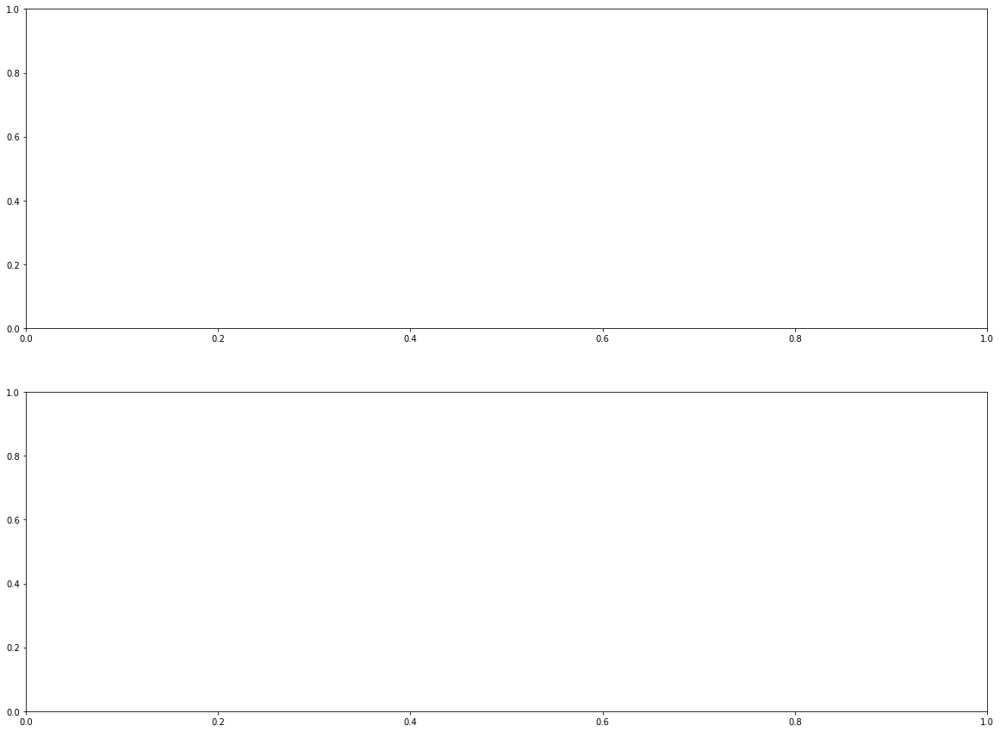

In [46]:
corpus = "googlengrams"
pdf2 = PdfPages('./tmp/Prefix_all_1gramPOS_synthesis_' + corpus+ '.pdf')

#columns = df.columns
#periods = [elt for elt in columns if re.match("[0-9]{4}-[0-9]{2}-[0-9]{2}", elt)]

# distribution entre les prefixes
fig, ax = plt.subplots(2, figsize=(20, 15))
df.groupby('prefix')['full_count'].count().plot(ax=ax[0],kind="bar",title='Distribution des fréquences entre préfixes (nbre de formations distinctes)', rot=45, figsize=(20,10))  # [['full_count']]
add_value_labels(ax[0])
df.groupby('prefix')['full_count'].sum().plot(ax=ax[1],kind="bar",title="Distribution des fréquences entre préfixes (nbre total d'occurrences)", rot=45, figsize=(20,10))  # [['full_count']]
add_value_labels(ax[1])
fig.text(4.25/8.5, 0.5/11., pdf2.get_pagecount(), ha='center', va='center', fontsize=8)
fig.tight_layout()

pdf2.savefig()
plt.close()

# distribution entre les mots
fig, ax = plt.subplots(2, figsize=(20, 15))
#df.groupby('source')['full_count'].nlargest(20).count().plot(ax=ax[0],kind="bar",title='Distribution des fréquences entre sources (nbre de formations distinctes)', rot=45, figsize=(20,10))  # [['full_count']]
df[df.word.isin(words20)].groupby('word')['full_count'].count().plot(ax=ax[0],kind="bar",title='Distribution des fréquences entre mots (20) (nbre de formations distinctes)', rot=45, figsize=(20,10))  # [['full_count']]
add_value_labels(ax[0])
df[df.word.isin(words20)].groupby('word')['full_count'].sum().plot(ax=ax[1],kind="bar",title="Distribution des fréquences entre mots (20) (nbre total d'occurrences)", rot=45, figsize=(20,10))  # [['full_count']]
add_value_labels(ax[1])
fig.text(4.25/8.5, 0.5/11., pdf2.get_pagecount(), ha='center', va='center', fontsize=8)
fig.tight_layout()

pdf2.savefig()
plt.close()


# distribution entre les pos
fig, ax = plt.subplots(2, figsize=(20, 15))
df.groupby('pos')['full_count'].count().plot(ax=ax[0],kind="bar",title='Distribution des fréquences entre pos  (nbre de formations distinctes)', rot=45, figsize=(20,10))  # [['full_count']]
add_value_labels(ax[0])
df.groupby('pos')['full_count'].sum().plot(ax=ax[1],kind="bar",title="Distribution des fréquences entre pos  (nbre total d'occurrences)", rot=45, figsize=(20,10))  # [['full_count']]
add_value_labels(ax[1])
fig.text(4.25/8.5, 0.5/11., pdf2.get_pagecount(), ha='center', va='center', fontsize=8)
fig.tight_layout()

pdf2.savefig()
plt.close()

# distribution entre les séparateurs
fig, ax = plt.subplots(2, figsize=(20, 15))
df.groupby('sep')['full_count'].count().plot(ax=ax[0],kind="bar",title='Distribution des fréquences entre séparateurs  (nbre de formations distinctes)', rot=45, figsize=(20,10))  # [['full_count']]
add_value_labels(ax[0])
df.groupby('sep')['full_count'].sum().plot(ax=ax[1],kind="bar",title="Distribution des fréquences entre séparateurs  (nbre total d'occurrences)", rot=45, figsize=(20,10))  # [['full_count']]
add_value_labels(ax[1])
fig.text(4.25/8.5, 0.5/11., pdf2.get_pagecount(), ha='center', va='center', fontsize=8)
fig.tight_layout()

pdf2.savefig()
plt.close()




# distribution plots
fig, ax = plt.subplots(8,3, figsize=(20, 15))
# get 0.9 quantile
i = 0
for pref in dist1.index.values:
        dfplot = df[df.prefix == pref]
        sns.distplot(dfplot['full_count'], ax=ax[i][0]).set_title('{} : {} formes distinctes, {} total occurrences (100%)'.format(pref, dist1.loc[pref,'count'], dist1.loc[pref,'sum']))
        # get 0.95 quantile
        q = dfplot["full_count"].quantile(0.9)
        dfplot2 = dfplot[dfplot["full_count"] < q]['full_count']      
        sns.distplot(dfplot2, ax=ax[i][1]).set_title(pref + ' : 90% quantiles')
        #sns.distplot(np.log(dfplot), ax=ax[0])
        sns.boxplot(dfplot2,ax=ax[i][2]).set_title(pref + ' : 90% quantiles')
        i=i+1
fig.text(4.25/8.5, 0.5/11., pdf2.get_pagecount(), ha='center', va='center', fontsize=8)
fig.tight_layout()
pdf2.savefig()
plt.close()         

q = df["full_count"].quantile(0.9)
dfplot2 = df[df["full_count"] < q]      

sns.boxplot(x="prefix", y="full_count", data=dfplot2).set_title("Boîte à moustache des préfixes (fréquences absolues, 90% quantile)")
    # +  (TBD) kind= violin, box, boxen...
pdf2.savefig()
plt.close()


# evolution globale pour chaque préfixe
dfplot = df.groupby('prefix')[periods].sum().T
dfplot.index = pd.to_datetime(dfplot.index)
dfplot_rel = df_rel.groupby('prefix')[periods].sum().T
# freq absolue
fig, ax = plt.subplots(1, figsize=(20, 15))
dfplot.plot(ax=ax,kind="line", title="Evolution des distributions des préfixes (fréquence absolue, périodisation originelle)", rot=45, figsize=(20,10))  # [['full_count']]    
fig.text(4.25/8.5, 0.5/11., pdf2.get_pagecount(), ha='center', va='center', fontsize=8)
pdf2.savefig()
plt.close()


# freq rel
fig, ax = plt.subplots(1, figsize=(20, 15))
dfplot_rel.plot(ax=ax,kind="line", title="Evolution des distributions des préfixes (fréquence relative)", rot=45, figsize=(20,10))  # [['full_count']]    
fig.text(4.25/8.5, 0.5/11., pdf2.get_pagecount(), ha='center', va='center', fontsize=8)
pdf2.savefig()
plt.close()

# evolution nbre de mots distincts
fig, ax = plt.subplots(1, figsize=(20, 15))
for k,grp in df_rel.groupby(['prefix']):
    grp[periods].astype(bool).sum(axis=0).T.plot(legend=True, ax=ax,kind="line", title="Evolution du nombre de formes différentes", rot=45, figsize=(20,10))  # [['full_count']]
fig.text(4.25/8.5, 0.5/11., pdf2.get_pagecount(), ha='center', va='center', fontsize=8)
pdf2.savefig()
plt.close()


# evolution globale pour chaque mot (20 plus fréquents)
fig, ax = plt.subplots(1, figsize=(20, 15))
dfplot = df[df.word.isin(words20)].groupby('word')[periods].sum().T
dfplot.index = pd.to_datetime(dfplot.index)
dfplot_rel = df_rel[df_rel.word.isin(words20)].groupby('word')[periods].sum().T
dfplot4=dfplot.resample('5A').sum()
#dfplot.plot(legend=None, ax=ax[0],kind="line", title="Evolution des distributions des mots (fréquence absolue, périodisation originelle)", rot=45, figsize=(20,10))  # [['full_count']]    
#dfplot4.plot(legend=None, ax=ax[1],kind="line", title="Evolution des distributions des mots (fréquence absolue, période 5 ans)", rot=45, figsize=(20,10))  # [['full_count']]    
dfplot_rel.plot(ax=ax,kind="line", title="Evolution des distributions des mots (fréquence relative)", rot=45, figsize=(20,10))  # [['full_count']]    
fig.text(4.25/8.5, 0.5/11., pdf2.get_pagecount(), ha='center', va='center', fontsize=8)
fig.tight_layout()
pdf2.savefig()
plt.close()


# evolution globale pour chaque pos
fig, ax = plt.subplots(1, figsize=(20, 15))
dfplot = df.groupby('pos')[periods].sum().T
dfplot.index = pd.to_datetime(dfplot.index)
dfplot_rel = df_rel.groupby('pos')[periods].sum().T
dfplot4=dfplot.resample('5A').sum()
#dfplot.plot(legend=None, ax=ax[0],kind="line", title="Evolution des distributions des séparateurs (fréquence absolue, périodisation originelle)", rot=45, figsize=(20,10))  # [['full_count']]    
#dfplot4.plot(legend=None, ax=ax[1],kind="line", title="Evolution des distributions des séparateurs (fréquence absolue, période 5 ans)", rot=45, figsize=(20,10))  # [['full_count']]    
dfplot_rel.plot(ax=ax,kind="line", title="Evolution des distributions des pos (fréquence relative)", rot=45, figsize=(20,10))  # [['full_count']]    
fig.text(4.25/8.5, 0.5/11., pdf2.get_pagecount(), ha='center', va='center', fontsize=8)
fig.tight_layout()
pdf2.savefig()
plt.close()


# evolution globale pour chaque séparateur
fig, ax = plt.subplots(1, figsize=(20, 15))
dfplot = df.groupby('sep')[periods].sum().T
dfplot.index = pd.to_datetime(dfplot.index)
dfplot_rel = df_rel.groupby('sep')[periods].sum().T
dfplot4=dfplot.resample('5A').sum()
#dfplot.plot(legend=None, ax=ax[0],kind="line", title="Evolution des distributions des séparateurs (fréquence absolue, périodisation originelle)", rot=45, figsize=(20,10))  # [['full_count']]    
#dfplot4.plot(legend=None, ax=ax[1],kind="line", title="Evolution des distributions des séparateurs (fréquence absolue, période 5 ans)", rot=45, figsize=(20,10))  # [['full_count']]    
dfplot_rel.plot(ax=ax,kind="line", title="Evolution des distributions des séparateurs (fréquence relative)", rot=45, figsize=(20,10))  # [['full_count']]    
fig.text(4.25/8.5, 0.5/11., pdf2.get_pagecount(), ha='center', va='center', fontsize=8)
fig.tight_layout()
pdf2.savefig()
plt.close()




# get 0.9 quantile
i = 0
fig, ax = plt.subplots(2,2, figsize=(20, 15))
for pref in dist1.index.values:
    dfplot3 = df_rel[df_rel.prefix == pref].set_index('word')[periods].T
    dfplot3.index = pd.to_datetime(dfplot3.index)
    #dfplot4=dfplot3.resample('1W').sum()
    dfplotdiffres = dfplot3.apply(np.ceil).diff()

    dfdiffok = dfplotdiffres.apply(lambda x : x.value_counts(), axis=1)
    dfdiffok.rename(columns={-1.0:'disparition',
                          0.0:'conservation',
                          1.0:'apparition'}, 
                 inplace=True)
    #print(dfdiffok)
    dfdiffok.plot(ax=ax[i][0], title=pref + ": vocabulaire conservé, apparaissant et disparaissant")

    dfplotdiffres['mean_diff'] = dfplot3.diff().apply(lambda x : x.mean(), axis=1)
    dfplotdiffres['mean_diff'].plot(ax=ax[i][1], title=pref + ": moyenne de l'évolution des mots construits (fréquence relative pour base)")

    if i==1:
        fig.tight_layout()
        pdf2.savefig()
        #fig, ax = plt.subplots(2,2, figsize=(20, 15))
        i=0
    else:
        i=i+1
        




# moving average, trends etc.
df5 = df_rel.groupby('prefix').sum()[periods]
for pref in dist1.index.values : #df5.index.values:
    series = df5.loc[pref]
    #series.index = series.index.resample("W", how='sum')
    ts = pd.DataFrame({'data':series.values}, index=series.index) # 'year':seriesrel.index, 

    ts['z_data'] = (ts['data'] - ts.data.rolling(window=10).mean()) / ts.data.rolling(window=10).std()
    #ts['zp_data'] = ts['z_data'] - ts['z_data'].shift(10)
    plot_rolling_simple(ts,title= pref, window=10)
    fig.text(4.25/8.5, 0.5/11., pdf2.get_pagecount(), ha='center', va='center', fontsize=8)
    pdf2.savefig()
    plt.close()
pdf2.close()



### par préfixe

In [175]:
### par préfixe

for pref in dist1.index.values:
    pdf2 = PdfPages('./results/' + pref + '_1gram_POS_synthesis_' + corpus + '.pdf')
    dfpref = df[df.prefix==pref]
    dfwpref = df_rel[df_rel.prefix==pref]
    dfpref_rel = df_rel[df_rel.prefix==pref]

    words = dfpref.groupby('word')['full_count'].agg(['count','sum']).sort_values('sum', ascending=False)
   # print(sources)
    words20pref = list(words.index.values)[0:20]
    #print(list(sources.index.values)[0:20])    

    
    # distribution 
    fig, ax = plt.subplots(2, figsize=(20, 15))
    dfpref.groupby('prefix')['full_count'].count().plot(ax=ax[0],kind="bar",title=pref + ' : distribution des fréquences (nbre de formations distinctes)', rot=45, figsize=(20,10))  # [['full_count']]
    add_value_labels(ax[0])
    dfpref.groupby('prefix')['full_count'].sum().plot(ax=ax[1],kind="bar",title=pref + " : distribution des fréquences (nbre total d'occurrences)", rot=45, figsize=(20,10))  # [['full_count']]
    add_value_labels(ax[1])
    fig.text(4.25/8.5, 0.5/11., pdf2.get_pagecount(), ha='center', va='center', fontsize=8)
    fig.tight_layout()

    pdf2.savefig()
    plt.close()

    
    
    # distribution entre les mots générés les plus fréquents d'informations
    fig, ax = plt.subplots(2, figsize=(20, 15))
    #df.groupby('source')['full_count'].nlargest(20).count().plot(ax=ax[0],kind="bar",title='Distribution des fréquences entre sources (nbre de formations distinctes)', rot=45, figsize=(20,10))  # [['full_count']]
    dfpref[df.word.isin(words20pref)].groupby('word')['full_count'].count().plot(ax=ax[0],kind="bar",title='Distribution des fréquences entre mots (20) (nbre de formations distinctes)', rot=45, figsize=(20,10))  # [['full_count']]
    add_value_labels(ax[0])
    dfpref[df.word.isin(words20pref)].groupby('word')['full_count'].sum().plot(ax=ax[1],kind="bar",title="Distribution des fréquences entre mots (20) (nbre total d'occurrences)", rot=45, figsize=(20,10))  # [['full_count']]
    add_value_labels(ax[1])
    fig.text(4.25/8.5, 0.5/11., pdf2.get_pagecount(), ha='center', va='center', fontsize=8)
    fig.tight_layout()
    
    pdf2.savefig()
    plt.close()
 
    # distribution entre les pos de mots
    fig, ax = plt.subplots(2, figsize=(20, 15))
    #df.groupby('source')['full_count'].nlargest(20).count().plot(ax=ax[0],kind="bar",title='Distribution des fréquences entre sources (nbre de formations distinctes)', rot=45, figsize=(20,10))  # [['full_count']]
    dfpref.groupby('pos')['full_count'].count().plot(ax=ax[0],kind="bar",title='Distribution des fréquences entre pos  (nbre de formations distinctes)', rot=45, figsize=(20,10))  # [['full_count']]
    add_value_labels(ax[0])
    dfpref.groupby('pos')['full_count'].sum().plot(ax=ax[1],kind="bar",title="Distribution des fréquences entre pos  (nbre total d'occurrences)", rot=45, figsize=(20,10))  # [['full_count']]
    add_value_labels(ax[1])
    fig.text(4.25/8.5, 0.5/11., pdf2.get_pagecount(), ha='center', va='center', fontsize=8)
    fig.tight_layout()
    
    pdf2.savefig()
    plt.close()
    # distribution entre les séparateurs de mots
    fig, ax = plt.subplots(2, figsize=(20, 15))
    #df.groupby('source')['full_count'].nlargest(20).count().plot(ax=ax[0],kind="bar",title='Distribution des fréquences entre sources (nbre de formations distinctes)', rot=45, figsize=(20,10))  # [['full_count']]
    dfpref.groupby('sep')['full_count'].count().plot(ax=ax[0],kind="bar",title='Distribution des fréquences entre séparateurs  (nbre de formations distinctes)', rot=45, figsize=(20,10))  # [['full_count']]
    add_value_labels(ax[0])
    dfpref.groupby('sep')['full_count'].sum().plot(ax=ax[1],kind="bar",title="Distribution des fréquences entre séparateurs  (nbre total d'occurrences)", rot=45, figsize=(20,10))  # [['full_count']]
    add_value_labels(ax[1])
    fig.text(4.25/8.5, 0.5/11., pdf2.get_pagecount(), ha='center', va='center', fontsize=8)
    fig.tight_layout()
    
    pdf2.savefig()
    plt.close()
  
    
    # distribution plots
    fig, ax = plt.subplots(3, figsize=(20, 15))
    dfplot = dfpref
    sns.distplot(dfplot['full_count'], ax=ax[0]).set_title('{} : {} formes distinctes, {} total occurrences (100%)'.format(pref, dist1.loc[pref,'count'], dist1.loc[pref,'sum']))
    # get 0.95 quantile
    q = dfplot["full_count"].quantile(0.9)
    dfplot2 = dfplot[dfplot["full_count"] < q]['full_count']      
    sns.distplot(dfplot2, ax=ax[1]).set_title(pref + ' : 90% quantiles')
    #sns.distplot(np.log(dfplot), ax=ax[0])
    sns.boxplot(dfplot2,ax=ax[2]).set_title(pref + ' : 90% quantiles')
    fig.text(4.25/8.5, 0.5/11., pdf2.get_pagecount(), ha='center', va='center', fontsize=8)
    fig.tight_layout()
    pdf2.savefig()
    plt.close()         
    
    
    
    # evolution globale pour chaque préfixe
    dfplot = dfpref[periods].sum().T
    dfplot.index = pd.to_datetime(dfplot.index)
    dfplot_rel = dfpref_rel[periods].sum().T
    # freq absolue
    fig, ax = plt.subplots(1, figsize=(20, 15))
    dfplot.plot(ax=ax,kind="line", title=pref + " : évolution des distributions des préfixes (fréquence absolue, périodisation originelle)", rot=45, figsize=(20,10))  # [['full_count']]    
    fig.text(4.25/8.5, 0.5/11., pdf2.get_pagecount(), ha='center', va='center', fontsize=8)
    pdf2.savefig()
    plt.close()
    
    
    # freq rel
    fig, ax = plt.subplots(1, figsize=(20, 15))
    dfplot_rel.plot(ax=ax,kind="line", title=pref + " : évolution des distributions des préfixes (fréquence relative)", rot=45, figsize=(20,10))  # [['full_count']]    
    fig.text(4.25/8.5, 0.5/11., pdf2.get_pagecount(), ha='center', va='center', fontsize=8)
    pdf2.savefig()
    plt.close()
    
    # evolution nbre de mots distincts
    fig, ax = plt.subplots(1, figsize=(20, 15))
    dfpref[periods].astype(bool).sum(axis=0).T.plot(ax=ax,kind="line", title=pref + " : évolution du nombre de formes différentes", rot=45, figsize=(20,10))  # [['full_count']]
    fig.text(4.25/8.5, 0.5/11., pdf2.get_pagecount(), ha='center', va='center', fontsize=8)
    pdf2.savefig()
    plt.close()
    
     # evolution globale pour chaque mot
    fig, ax = plt.subplots(1, figsize=(20, 15))
    dfplot = dfpref[dfpref.word.isin(words20pref)].groupby('word')[periods].sum().T
    dfplot.index = pd.to_datetime(dfplot.index)
    dfplot_rel = dfpref_rel[dfpref_rel.word.isin(words20pref)].groupby('word')[periods].sum().T
    dfplot4=dfplot.resample('5A').sum()
#    dfplot.plot(legend=None, ax=ax[0],kind="line", title="Evolution des distributions des mots (fréquence absolue, périodisation originelle)", rot=45, figsize=(20,10))  # [['full_count']]    
#    dfplot4.plot(legend=None, ax=ax[1],kind="line", title="Evolution des distributions des mots (fréquence absolue, période 5 ans)", rot=45, figsize=(20,10))  # [['full_count']]    
    dfplot_rel.plot(ax=ax,kind="line", title=pref + " : évolution des distributions des mots (fréquence relative)", rot=45, figsize=(20,10))  # [['full_count']]    
    fig.text(4.25/8.5, 0.5/11., pdf2.get_pagecount(), ha='center', va='center', fontsize=8)
    fig.tight_layout()
    pdf2.savefig()
    plt.close()

   
     # evolution globale pour chaque pos
    fig, ax = plt.subplots(1, figsize=(20, 15))
    dfplot = dfpref.groupby('pos')[periods].sum().T
    dfplot.index = pd.to_datetime(dfplot.index)
    dfplot_rel = dfpref_rel.groupby('pos')[periods].sum().T
    dfplot4=dfplot.resample('5A').sum()
    #dfplot.plot(legend=None, ax=ax[0],kind="line", title="Evolution des distributions des séparateurs (fréquence absolue, périodisation originelle)", rot=45, figsize=(20,10))  # [['full_count']]    
    #dfplot4.plot(legend=None, ax=ax[1],kind="line", title="Evolution des distributions des séparateurs (fréquence absolue, période 5 ans)", rot=45, figsize=(20,10))  # [['full_count']]    
    dfplot_rel.plot(ax=ax,kind="line", title=pref + " : évolution des distributions des pos (fréquence relative)", rot=45, figsize=(20,10))  # [['full_count']]    
    fig.text(4.25/8.5, 0.5/11., pdf2.get_pagecount(), ha='center', va='center', fontsize=8)
    fig.tight_layout()
    pdf2.savefig()
    plt.close()
    

     # evolution globale pour chaque séparateur
    fig, ax = plt.subplots(1, figsize=(20, 15))
    dfplot = dfpref.groupby('sep')[periods].sum().T
    dfplot.index = pd.to_datetime(dfplot.index)
    dfplot_rel = dfpref_rel.groupby('sep')[periods].sum().T
    dfplot4=dfplot.resample('5A').sum()
    #dfplot.plot(legend=None, ax=ax[0],kind="line", title="Evolution des distributions des séparateurs (fréquence absolue, périodisation originelle)", rot=45, figsize=(20,10))  # [['full_count']]    
    #dfplot4.plot(legend=None, ax=ax[1],kind="line", title="Evolution des distributions des séparateurs (fréquence absolue, période 5 ans)", rot=45, figsize=(20,10))  # [['full_count']]    
    dfplot_rel.plot(ax=ax,kind="line", title=pref + " : évolution des distributions des séparateurs (fréquence relative)", rot=45, figsize=(20,10))  # [['full_count']]    
    fig.text(4.25/8.5, 0.5/11., pdf2.get_pagecount(), ha='center', va='center', fontsize=8)
    fig.tight_layout()
    pdf2.savefig()
    plt.close()
    
  
    
    # get 0.9 quantile
    fig, ax = plt.subplots(2, figsize=(20, 15))
    dfplot3 = dfpref_rel.set_index('word')[periods].T
    dfplot3.index = pd.to_datetime(dfplot3.index)
    dfplotdiffres = dfplot3.apply(np.ceil).diff()

    dfdiffok = dfplotdiffres.apply(lambda x : x.value_counts(), axis=1)
    dfdiffok.rename(columns={-1.0:'disparition',
                          0.0:'conservation',
                          1.0:'apparition'}, 
                 inplace=True)
    #print(dfdiffok)
    dfdiffok.plot(ax=ax[0], title=pref + ": vocabulaire conservé, apparaissant et disparaissant")

    dfplotdiffres['mean_diff'] = dfplot3.diff().apply(lambda x : x.mean(), axis=1)
    dfplotdiffres['mean_diff'].plot(ax=ax[1], title=pref + ": moyenne de l'évolution des mots construits (fréquence relative pour base)")

    fig.tight_layout()
    pdf2.savefig()
    plt.close()
    
    
    # moving average, trends etc.
    df5 = dfpref_rel.groupby('prefix').sum()[periods]
    series = df5.loc[pref]
    #series.index = series.index.resample("W", how='sum')
    ts = pd.DataFrame({'data':series.values}, index=series.index) # 'year':seriesrel.index, 

    ts['z_data'] = (ts['data'] - ts.data.rolling(window=10).mean()) / ts.data.rolling(window=10).std()
    #ts['zp_data'] = ts['z_data'] - ts['z_data'].shift(10)
    plot_rolling_simple(ts,title= pref, window=10)
    fig.text(4.25/8.5, 0.5/11., pdf2.get_pagecount(), ha='center', va='center', fontsize=8)
    pdf2.savefig()
    plt.close()
    
    pdf2.close()



/Users/emmanuelcartier/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:32: UserWarning:

Boolean Series key will be reindexed to match DataFrame index.

/Users/emmanuelcartier/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:34: UserWarning:

Boolean Series key will be reindexed to match DataFrame index.

/Users/emmanuelcartier/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:32: UserWarning:

Boolean Series key will be reindexed to match DataFrame index.

/Users/emmanuelcartier/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:34: UserWarning:

Boolean Series key will be reindexed to match DataFrame index.

/Users/emmanuelcartier/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:32: UserWarning:

Boolean Series key will be reindexed to match DataFrame index.

/Users/emmanuelcartier/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:34: UserWarning:

Boolean Series key will be reindexed to match DataFrame index.

/Users/emm

## 2 grams (pref word)

In [47]:
if os.path.isfile('../data/fre.prefixes.2.grams.pos.1799-2009.csv'):
    print("Loading the 2 gram big file (pos)...")
    dfpos2= pd.read_csv('../data/fre.prefixes.2.grams.pos.1799-2009.csv', header=0, sep=',', error_bad_lines=False)#, index_col=0 
else:
    print("Please first launch retrieve_google_2grams.py to generate fre.prefixes.2.pos.grams.1799-2009.csv")
    exit()


dfpos2.info()
dfpos2.head(20)




Loading the 2 gram big file (pos)...
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 84696 entries, 0 to 84695
Columns: 211 entries, string to 2009
dtypes: float64(50), int64(160), object(1)
memory usage: 136.3+ MB


,string,1800,1801,1802,1803,1804,1805,1806,1807,1808,...,2000,2001,2002,2003,2004,2005,2006,2007,2008,2009
0,archi 1_ADJ,0.0,0.0,0,0,0,0,0.0,0.0,0.0,...,2,6,2,3,2,2,0,3,2,1
1,archi Le_DET,0.0,0.0,0,0,0,0,0.0,0.0,0.0,...,1,0,0,1,1,1,0,1,0,0
2,archi _ADJ_,1.0,4.0,5,9,7,1,4.0,4.0,1.0,...,148,149,171,207,134,153,174,158,175,132
3,archi _ADP_,1.0,0.0,2,0,0,0,2.0,0.0,1.0,...,6,6,5,13,18,4,12,5,5,13
4,archi _ADV_,0.0,0.0,0,1,2,2,0.0,0.0,0.0,...,9,5,13,7,8,8,8,11,15,6
5,archi _CONJ_,0.0,1.0,1,0,0,1,0.0,0.0,0.0,...,0,3,5,10,1,3,3,2,1,1
6,archi _DET_,4.0,3.0,8,13,8,6,19.0,7.0,12.0,...,22,7,19,34,17,19,18,16,14,8
7,archi _NOUN_,15.0,27.0,59,76,49,48,65.0,66.0,95.0,...,264,251,277,312,309,315,406,373,334,222
8,archi _PRON_,0.0,1.0,0,0,1,0,2.0,0.0,2.0,...,3,9,6,8,2,5,6,4,15,4
9,archi _PRT_,11.0,10.0,4,35,88,213,121.0,45.0,117.0,...,303,282,317,265,331,317,355,306,314,209


In [48]:
# ## create triple column (prefix - word - POS)
# remove sur...

dfpos2 = dfpos2[~dfpos2.string.str.contains("^sur")]
print(dfpos2.info())

# remove where there are less than two _
dfpos2 = dfpos2[dfpos2.string.str.contains("_.+_")]
print(dfpos2.info())
# remove latin loc
dfpos2 = dfpos2[~dfpos2.string.isin(stoplist_loc)]
dfpos2 = dfpos2[~dfpos2.string.isin(stoplist)]
print(dfpos2.info())
# split two words
string_re = '^(.+) (?:.+)$'
string_re2 = '^(?:.+) (.+)$'
dfpos2['string1'] = dfpos2.string.str.extract(string_re, expand=True)
dfpos2['string2'] = dfpos2.string.str.extract(string_re2, expand=True)
#print(dfpos2.string1.unique(), len(dfpos2.string1.unique()))
#print(dfpos2.string2.unique(), len(dfpos2.string2.unique()))
#print(dfpos2[~dfpos2.string1.str.contains("_")])
#print(dfpos2[dfpos2.string.str.contains("archi.+_ADV")])
#print(dfpos2.head())
#print(dfpos2.string.describe())
print(dfpos2.string1.describe())
print(dfpos2.string2.describe())

<class 'pandas.core.frame.DataFrame'>
Int64Index: 8668 entries, 0 to 84695
Columns: 211 entries, string to 2009
dtypes: float64(50), int64(160), object(1)
memory usage: 14.0+ MB
None
<class 'pandas.core.frame.DataFrame'>
Int64Index: 3177 entries, 2 to 84695
Columns: 211 entries, string to 2009
dtypes: float64(50), int64(160), object(1)
memory usage: 5.1+ MB
None
<class 'pandas.core.frame.DataFrame'>
Int64Index: 1481 entries, 2 to 84695
Columns: 211 entries, string to 2009
dtypes: float64(50), int64(160), object(1)
memory usage: 2.4+ MB
None
count          1481
unique           68
top       ultra_PRT
freq            242
Name: string1, dtype: object
count       1481
unique       722
top       _NOUN_
freq          47
Name: string2, dtype: object


In [49]:
# get word1 pos1

word_pos = '^(.+)_(?:.+)$'
word_pos1 = '^(?:.+)_(.+)$'
word_pos2 = '^(.+)?_(?_.+)_$'
word_pos3 = '^_(.+)_$'

# general case for string1
dfpos2['prefix'] = dfpos2.string1.str.extract(word_pos, expand=True)
#dfpos2['pos1'] = dfpos2.string1.str.extract(word_pos1, expand=True)

# case of archi
#dfpos2.prefix.fillna(dfpos2.string1, inplace=True)
#dfpos2.pos1.fillna('', inplace=True)

# general case for string1
dfpos2['word'] = dfpos2.string2.str.extract(word_pos, expand=True)
dfpos2['posGNG'] = dfpos2.string2.str.extract(word_pos1, expand=True)
# case of _NOUN_
#dfpos2.pos2.fillna(dfpos2.string2, inplace=True)
#dfpos2.word.fillna('', inplace=True)

dfpos2['sep'] = " "
dfpos2.prefix = dfpos2.prefix.str.replace('_','')
#dfpos2[dfpos2.pos1.isnull()].prefix.unique()

print(dfpos2.info())
dfpos2.dropna(inplace=True)
print(dfpos2.info())
print(dfpos2.prefix.value_counts())

dfpos2[['string','string1','prefix','string2','word','posGNG','sep']].head(20)


<class 'pandas.core.frame.DataFrame'>
Int64Index: 1481 entries, 2 to 84695
Columns: 217 entries, string to sep
dtypes: float64(50), int64(160), object(7)
memory usage: 2.5+ MB
None
<class 'pandas.core.frame.DataFrame'>
Int64Index: 1114 entries, 64 to 84695
Columns: 217 entries, string to sep
dtypes: float64(50), int64(160), object(7)
memory usage: 1.9+ MB
None
extra    312
supra    241
ultra    231
super    229
hyper     53
maxi      27
archi     21
Name: prefix, dtype: int64


,string,string1,prefix,string2,word,posGNG,sep
64,archi_ADJ prêtres_NOUN,archi_ADJ,archi,prêtres_NOUN,prêtres,NOUN,
71,archi_ADV 1_ADJ,archi_ADV,archi,1_ADJ,1,ADJ,
84,archi_ADV et_CONJ,archi_ADV,archi,et_CONJ,et,CONJ,
86,archi_ADV faux_ADJ,archi_ADV,archi,faux_ADJ,faux,ADJ,
88,archi_ADV prêtre_ADV,archi_ADV,archi,prêtre_ADV,prêtre,ADV,
90,archi_ADV qui_PRON,archi_ADV,archi,qui_PRON,qui,PRON,
111,archi_ADV trésorier_ADJ,archi_ADV,archi,trésorier_ADJ,trésorier,ADJ,
112,archi_ADV trésorier_VERB,archi_ADV,archi,trésorier_VERB,trésorier,VERB,
118,archi_DET chancelier_NOUN,archi_DET,archi,chancelier_NOUN,chancelier,NOUN,
120,archi_DET comble_NOUN,archi_DET,archi,comble_NOUN,comble,NOUN,


In [51]:

dfpos2 = dfpos2[~dfpos2.word.str.contains(r"[0-9]", na=False)]
dfpos2 = dfpos2[dfpos2.word.str.contains(r"^(|s|\w{3,})$", na=True)]
print(dfpos2.info())
print(dfpos2.prefix.value_counts())
print(dfpos2[['string','string1','prefix','string2','word','posGNG','sep']].head(20))
dfpos.to_csv("./tmp/dfpos_google2grams.csv")


<class 'pandas.core.frame.DataFrame'>
Int64Index: 788 entries, 64 to 84695
Columns: 217 entries, string to sep
dtypes: float64(50), int64(160), object(7)
memory usage: 1.3+ MB
None
extra    262
ultra    194
super    146
supra    122
hyper     41
archi     13
maxi      10
Name: prefix, dtype: int64
                         string     string1 prefix           string2  \
64       archi_ADJ prêtres_NOUN   archi_ADJ  archi      prêtres_NOUN   
86           archi_ADV faux_ADJ   archi_ADV  archi          faux_ADJ   
88         archi_ADV prêtre_ADV   archi_ADV  archi        prêtre_ADV   
90           archi_ADV qui_PRON   archi_ADV  archi          qui_PRON   
111     archi_ADV trésorier_ADJ   archi_ADV  archi     trésorier_ADJ   
112    archi_ADV trésorier_VERB   archi_ADV  archi    trésorier_VERB   
118   archi_DET chancelier_NOUN   archi_DET  archi   chancelier_NOUN   
120       archi_DET comble_NOUN   archi_DET  archi       comble_NOUN   
122       archi_DET diacre_NOUN   archi_DET  archi   

/Users/emmanuelcartier/opt/anaconda3/lib/python3.7/site-packages/pandas/core/strings.py:1952: UserWarning: This pattern has match groups. To actually get the groups, use str.extract.
  return func(self, *args, **kwargs)


In [16]:
mapposGNG = {'ADP':'PREP','NOUN':'NOM','PRT':'ADJ','ADJ':'ADJ','VERB':'VERB','X':'X','ADV':'ADV','DET':'DET','PRON':'PRO','CONJ':'CONJ'}
dfpos2['pos'] = dfpos2.apply(lambda row : dico[str(row.word)] if str(row.word) in dico.keys() else mapposGNG[row.posGNG], axis = 1) #  if row.word in dico.keys() else row.posGNG
#dfpos['pos'] = dfpos.apply(lambda row : ",".join(set(dico[str(row.word)])) if str(row.word) in dico.keys() else mapposGNG[row.posGNG], axis = 1) #  if row.word in dico.keys() else row.posGNG

print(dfpos2.info())
print(dfpos2.head(20))


dfpos.to_csv("dfpos2.csv")

<class 'pandas.core.frame.DataFrame'>
Int64Index: 788 entries, 64 to 84695
Columns: 218 entries, string to pos
dtypes: float64(50), int64(160), object(8)
memory usage: 1.3+ MB
None
                         string  1800  1801  1802  1803  1804  1805  1806  \
64       archi_ADJ prêtres_NOUN   0.0   0.0     1     0     0     0   0.0   
86           archi_ADV faux_ADJ   0.0   0.0     0     0     0     0   0.0   
88         archi_ADV prêtre_ADV   0.0   0.0     0     0     2     0   0.0   
90           archi_ADV qui_PRON   0.0   0.0     0     0     0     0   2.0   
111     archi_ADV trésorier_ADJ   0.0   0.0     0     0     0     0   0.0   
112    archi_ADV trésorier_VERB   0.0   0.0     0     0     0     0   0.0   
118   archi_DET chancelier_NOUN   0.0   0.0     0     0     2     4   0.0   
120       archi_DET comble_NOUN   0.0   0.0     0     0     0     0   0.0   
122       archi_DET diacre_NOUN   0.0   0.0     0     0     0     0   1.0   
124       archi_DET prêtre_NOUN   0.0   0.0     0

In [52]:

columns = dfpos2.columns
periods = [elt for elt in columns if re.match("[0-9]{4}", elt)]
dfpos2['full_count'] = dfpos2.apply(lambda x: x[periods].sum(), axis=1)
dfpos2.head()

,string,1800,1801,1802,1803,1804,1805,1806,1807,1808,...,2007,2008,2009,string1,string2,prefix,word,posGNG,sep,full_count
64,archi_ADJ prêtres_NOUN,0.0,0.0,1,0,0,0,0.0,0.0,0.0,...,0,0,0,archi_ADJ,prêtres_NOUN,archi,prêtres,NOUN,,76.0
86,archi_ADV faux_ADJ,0.0,0.0,0,0,0,0,0.0,0.0,0.0,...,4,1,5,archi_ADV,faux_ADJ,archi,faux,ADJ,,67.0
88,archi_ADV prêtre_ADV,0.0,0.0,0,0,2,0,0.0,0.0,0.0,...,0,0,0,archi_ADV,prêtre_ADV,archi,prêtre,ADV,,75.0
90,archi_ADV qui_PRON,0.0,0.0,0,0,0,0,2.0,0.0,0.0,...,1,0,1,archi_ADV,qui_PRON,archi,qui,PRON,,46.0
111,archi_ADV trésorier_ADJ,0.0,0.0,0,0,0,0,0.0,1.0,0.0,...,1,0,0,archi_ADV,trésorier_ADJ,archi,trésorier,ADJ,,46.0


### dfpos2_rel

In [18]:

dfpos2_rel = dfpos2.copy(deep=True)
# load totals of tokens per corpus year
totals = load_total_counts(19,1800,2009)

# calculate relative frequency for each column

for i in range(1800,2010):
    dfpos2_rel[str(i) + '_freqrel'] = (dfpos2_rel[str(i)] / totals[str(i)]) * 1000

# remove absolute frequency for df (relative frequency used for clustering and plotting)
dfpos2_rel = dfpos2_rel.drop([str(i) for i in range(1800,2010)], axis=1)
dfpos2_rel.columns = dfpos2_rel.columns.str.replace('_freqrel', '')

print(dfpos2_rel.info())
print(dfpos2_rel.head(10))



<class 'pandas.core.frame.DataFrame'>
Int64Index: 788 entries, 64 to 84695
Columns: 219 entries, string to 2009
dtypes: float64(211), object(8)
memory usage: 1.3+ MB
None
                        string    string1          string2 prefix        word  \
64      archi_ADJ prêtres_NOUN  archi_ADJ     prêtres_NOUN  archi     prêtres   
86          archi_ADV faux_ADJ  archi_ADV         faux_ADJ  archi        faux   
88        archi_ADV prêtre_ADV  archi_ADV       prêtre_ADV  archi      prêtre   
90          archi_ADV qui_PRON  archi_ADV         qui_PRON  archi         qui   
111    archi_ADV trésorier_ADJ  archi_ADV    trésorier_ADJ  archi   trésorier   
112   archi_ADV trésorier_VERB  archi_ADV   trésorier_VERB  archi   trésorier   
118  archi_DET chancelier_NOUN  archi_DET  chancelier_NOUN  archi  chancelier   
120      archi_DET comble_NOUN  archi_DET      comble_NOUN  archi      comble   
122      archi_DET diacre_NOUN  archi_DET      diacre_NOUN  archi      diacre   
124      archi_DET 

In [53]:
# base for browsing prefixes
dist1 = dfpos2.groupby('prefix')['full_count'].agg(['count','sum']).sort_values('count', ascending=False)
print(dist1)
print(dist1.index.values)
print(dist1.loc['maxi','count'])

        count      sum
prefix                
extra     262  36858.0
ultra     194  34652.0
super     146  23823.0
supra     122  33642.0
hyper      41   3080.0
archi      13   1056.0
maxi       10    991.0
['extra' 'ultra' 'super' 'supra' 'hyper' 'archi' 'maxi']
10


In [54]:

#print(df4.head())
save_report(dfpos2, 'prefix','./tmp/prefixes_2gram_googlengrams1800-2010.xls')


True

## data Synthesis

In [184]:
df = dfpos2.copy(deep=True)
df_rel = dfpos2_rel.copy(deep=True)

### synthèse

/Users/emmanuelcartier/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:241: UserWarning:

Boolean Series key will be reindexed to match DataFrame index.

/Users/emmanuelcartier/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:243: UserWarning:

Boolean Series key will be reindexed to match DataFrame index.

/Users/emmanuelcartier/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:241: UserWarning:

Boolean Series key will be reindexed to match DataFrame index.

/Users/emmanuelcartier/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:243: UserWarning:

Boolean Series key will be reindexed to match DataFrame index.

/Users/emmanuelcartier/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:241: UserWarning:

Boolean Series key will be reindexed to match DataFrame index.

/Users/emmanuelcartier/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:243: UserWarning:

Boolean Series key will be reindexed to match DataFrame index.

/Use

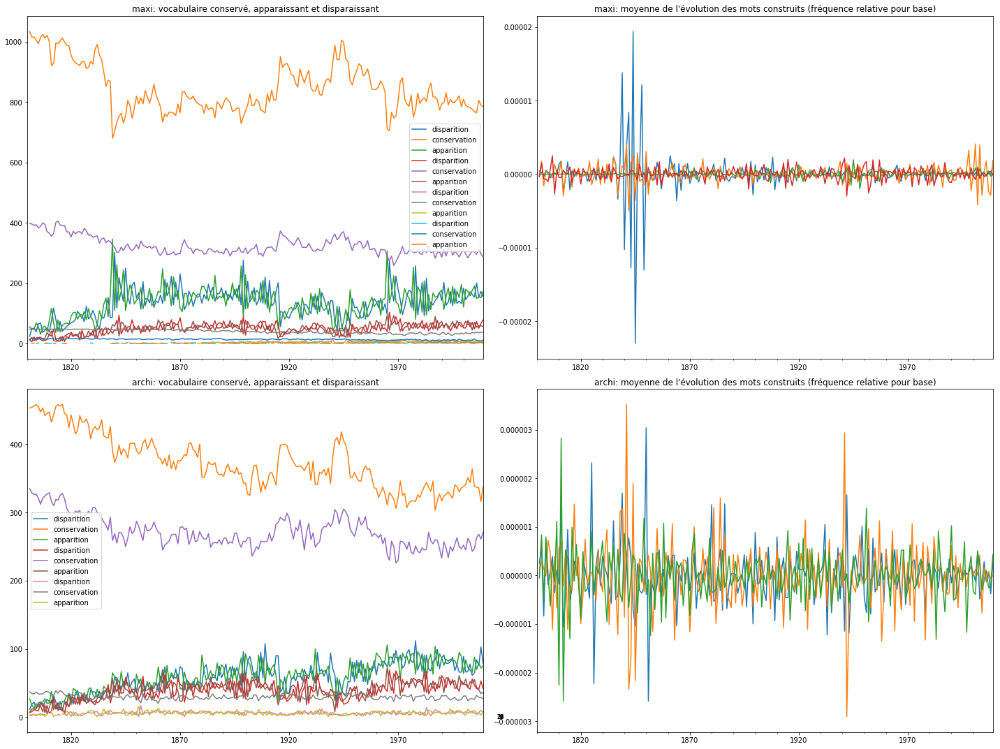

In [185]:
corpus = "googlengrams"
pdf2 = PdfPages('../visu/Prefix_all_2gramPOS_synthesis_' + corpus+ '.pdf')

#columns = df.columns
#periods = [elt for elt in columns if re.match("[0-9]{4}-[0-9]{2}-[0-9]{2}", elt)]

# distribution entre les prefixes
fig, ax = plt.subplots(2, figsize=(20, 15))
df.groupby('prefix')['full_count'].count().plot(ax=ax[0],kind="bar",title='Distribution des fréquences entre préfixes (nbre de formations distinctes)', rot=45, figsize=(20,10))  # [['full_count']]
add_value_labels(ax[0])
df.groupby('prefix')['full_count'].sum().plot(ax=ax[1],kind="bar",title="Distribution des fréquences entre préfixes (nbre total d'occurrences)", rot=45, figsize=(20,10))  # [['full_count']]
add_value_labels(ax[1])
fig.text(4.25/8.5, 0.5/11., pdf2.get_pagecount(), ha='center', va='center', fontsize=8)
fig.tight_layout()

pdf2.savefig()
plt.close()

# distribution entre les mots
fig, ax = plt.subplots(2, figsize=(20, 15))
#df.groupby('source')['full_count'].nlargest(20).count().plot(ax=ax[0],kind="bar",title='Distribution des fréquences entre sources (nbre de formations distinctes)', rot=45, figsize=(20,10))  # [['full_count']]
df[df.word.isin(words20)].groupby('word')['full_count'].count().plot(ax=ax[0],kind="bar",title='Distribution des fréquences entre mots (20) (nbre de formations distinctes)', rot=45, figsize=(20,10))  # [['full_count']]
add_value_labels(ax[0])
df[df.word.isin(words20)].groupby('word')['full_count'].sum().plot(ax=ax[1],kind="bar",title="Distribution des fréquences entre mots (20) (nbre total d'occurrences)", rot=45, figsize=(20,10))  # [['full_count']]
add_value_labels(ax[1])
fig.text(4.25/8.5, 0.5/11., pdf2.get_pagecount(), ha='center', va='center', fontsize=8)
fig.tight_layout()

pdf2.savefig()
plt.close()


# distribution entre les pos
fig, ax = plt.subplots(2, figsize=(20, 15))
df.groupby('pos')['full_count'].count().plot(ax=ax[0],kind="bar",title='Distribution des fréquences entre pos  (nbre de formations distinctes)', rot=45, figsize=(20,10))  # [['full_count']]
add_value_labels(ax[0])
df.groupby('pos')['full_count'].sum().plot(ax=ax[1],kind="bar",title="Distribution des fréquences entre pos  (nbre total d'occurrences)", rot=45, figsize=(20,10))  # [['full_count']]
add_value_labels(ax[1])
fig.text(4.25/8.5, 0.5/11., pdf2.get_pagecount(), ha='center', va='center', fontsize=8)
fig.tight_layout()

pdf2.savefig()
plt.close()

# distribution entre les séparateurs
fig, ax = plt.subplots(2, figsize=(20, 15))
df.groupby('sep')['full_count'].count().plot(ax=ax[0],kind="bar",title='Distribution des fréquences entre séparateurs  (nbre de formations distinctes)', rot=45, figsize=(20,10))  # [['full_count']]
add_value_labels(ax[0])
df.groupby('sep')['full_count'].sum().plot(ax=ax[1],kind="bar",title="Distribution des fréquences entre séparateurs  (nbre total d'occurrences)", rot=45, figsize=(20,10))  # [['full_count']]
add_value_labels(ax[1])
fig.text(4.25/8.5, 0.5/11., pdf2.get_pagecount(), ha='center', va='center', fontsize=8)
fig.tight_layout()

pdf2.savefig()
plt.close()




# distribution plots
fig, ax = plt.subplots(8,3, figsize=(20, 15))
# get 0.9 quantile
i = 0
for pref in dist1.index.values:
        dfplot = df[df.prefix == pref]
        sns.distplot(dfplot['full_count'], ax=ax[i][0]).set_title('{} : {} formes distinctes, {} total occurrences (100%)'.format(pref, dist1.loc[pref,'count'], dist1.loc[pref,'sum']))
        # get 0.95 quantile
        q = dfplot["full_count"].quantile(0.9)
        dfplot2 = dfplot[dfplot["full_count"] < q]['full_count']      
        sns.distplot(dfplot2, ax=ax[i][1]).set_title(pref + ' : 90% quantiles')
        #sns.distplot(np.log(dfplot), ax=ax[0])
        sns.boxplot(dfplot2,ax=ax[i][2]).set_title(pref + ' : 90% quantiles')
        i=i+1
fig.text(4.25/8.5, 0.5/11., pdf2.get_pagecount(), ha='center', va='center', fontsize=8)
fig.tight_layout()
pdf2.savefig()
plt.close()         

q = df["full_count"].quantile(0.9)
dfplot2 = df[df["full_count"] < q]      

sns.boxplot(x="prefix", y="full_count", data=dfplot2).set_title("Boîte à moustache des préfixes (fréquences absolues, 90% quantile)")
    # +  (TBD) kind= violin, box, boxen...
pdf2.savefig()
plt.close()


# evolution globale pour chaque préfixe
dfplot = df.groupby('prefix')[periods].sum().T
dfplot.index = pd.to_datetime(dfplot.index)
dfplot_rel = df_rel.groupby('prefix')[periods].sum().T
# freq absolue
fig, ax = plt.subplots(1, figsize=(20, 15))
dfplot.plot(ax=ax,kind="line", title="Evolution des distributions des préfixes (fréquence absolue, périodisation originelle)", rot=45, figsize=(20,10))  # [['full_count']]    
fig.text(4.25/8.5, 0.5/11., pdf2.get_pagecount(), ha='center', va='center', fontsize=8)
pdf2.savefig()
plt.close()


# freq rel
fig, ax = plt.subplots(1, figsize=(20, 15))
dfplot_rel.plot(ax=ax,kind="line", title="Evolution des distributions des préfixes (fréquence relative)", rot=45, figsize=(20,10))  # [['full_count']]    
fig.text(4.25/8.5, 0.5/11., pdf2.get_pagecount(), ha='center', va='center', fontsize=8)
pdf2.savefig()
plt.close()

# evolution nbre de mots distincts
fig, ax = plt.subplots(1, figsize=(20, 15))
for k,grp in df_rel.groupby(['prefix']):
    grp[periods].astype(bool).sum(axis=0).T.plot(legend=True, ax=ax,kind="line", title="Evolution du nombre de formes différentes", rot=45, figsize=(20,10))  # [['full_count']]
fig.text(4.25/8.5, 0.5/11., pdf2.get_pagecount(), ha='center', va='center', fontsize=8)
pdf2.savefig()
plt.close()


# evolution globale pour chaque mot (20 plus fréquents)
fig, ax = plt.subplots(1, figsize=(20, 15))
dfplot = df[df.word.isin(words20)].groupby('word')[periods].sum().T
dfplot.index = pd.to_datetime(dfplot.index)
dfplot_rel = df_rel[df_rel.word.isin(words20)].groupby('word')[periods].sum().T
dfplot4=dfplot.resample('5A').sum()
#dfplot.plot(legend=None, ax=ax[0],kind="line", title="Evolution des distributions des mots (fréquence absolue, périodisation originelle)", rot=45, figsize=(20,10))  # [['full_count']]    
#dfplot4.plot(legend=None, ax=ax[1],kind="line", title="Evolution des distributions des mots (fréquence absolue, période 5 ans)", rot=45, figsize=(20,10))  # [['full_count']]    
dfplot_rel.plot(ax=ax,kind="line", title="Evolution des distributions des mots (fréquence relative)", rot=45, figsize=(20,10))  # [['full_count']]    
fig.text(4.25/8.5, 0.5/11., pdf2.get_pagecount(), ha='center', va='center', fontsize=8)
fig.tight_layout()
pdf2.savefig()
plt.close()


# evolution globale pour chaque pos
fig, ax = plt.subplots(1, figsize=(20, 15))
dfplot = df.groupby('pos')[periods].sum().T
dfplot.index = pd.to_datetime(dfplot.index)
dfplot_rel = df_rel.groupby('pos')[periods].sum().T
dfplot4=dfplot.resample('5A').sum()
#dfplot.plot(legend=None, ax=ax[0],kind="line", title="Evolution des distributions des séparateurs (fréquence absolue, périodisation originelle)", rot=45, figsize=(20,10))  # [['full_count']]    
#dfplot4.plot(legend=None, ax=ax[1],kind="line", title="Evolution des distributions des séparateurs (fréquence absolue, période 5 ans)", rot=45, figsize=(20,10))  # [['full_count']]    
dfplot_rel.plot(ax=ax,kind="line", title="Evolution des distributions des pos (fréquence relative)", rot=45, figsize=(20,10))  # [['full_count']]    
fig.text(4.25/8.5, 0.5/11., pdf2.get_pagecount(), ha='center', va='center', fontsize=8)
fig.tight_layout()
pdf2.savefig()
plt.close()


# evolution globale pour chaque séparateur
fig, ax = plt.subplots(1, figsize=(20, 15))
dfplot = df.groupby('sep')[periods].sum().T
dfplot.index = pd.to_datetime(dfplot.index)
dfplot_rel = df_rel.groupby('sep')[periods].sum().T
dfplot4=dfplot.resample('5A').sum()
#dfplot.plot(legend=None, ax=ax[0],kind="line", title="Evolution des distributions des séparateurs (fréquence absolue, périodisation originelle)", rot=45, figsize=(20,10))  # [['full_count']]    
#dfplot4.plot(legend=None, ax=ax[1],kind="line", title="Evolution des distributions des séparateurs (fréquence absolue, période 5 ans)", rot=45, figsize=(20,10))  # [['full_count']]    
dfplot_rel.plot(ax=ax,kind="line", title="Evolution des distributions des séparateurs (fréquence relative)", rot=45, figsize=(20,10))  # [['full_count']]    
fig.text(4.25/8.5, 0.5/11., pdf2.get_pagecount(), ha='center', va='center', fontsize=8)
fig.tight_layout()
pdf2.savefig()
plt.close()




# get 0.9 quantile
i = 0
fig, ax = plt.subplots(2,2, figsize=(20, 15))
for pref in dist1.index.values:
    dfplot3 = df_rel[df_rel.prefix == pref].set_index('word')[periods].T
    dfplot3.index = pd.to_datetime(dfplot3.index)
    #dfplot4=dfplot3.resample('1W').sum()
    dfplotdiffres = dfplot3.apply(np.ceil).diff()

    dfdiffok = dfplotdiffres.apply(lambda x : x.value_counts(), axis=1)
    dfdiffok.rename(columns={-1.0:'disparition',
                          0.0:'conservation',
                          1.0:'apparition'}, 
                 inplace=True)
    #print(dfdiffok)
    dfdiffok.plot(ax=ax[i][0], title=pref + ": vocabulaire conservé, apparaissant et disparaissant")

    dfplotdiffres['mean_diff'] = dfplot3.diff().apply(lambda x : x.mean(), axis=1)
    dfplotdiffres['mean_diff'].plot(ax=ax[i][1], title=pref + ": moyenne de l'évolution des mots construits (fréquence relative pour base)")

    if i==1:
        fig.tight_layout()
        pdf2.savefig()
        #fig, ax = plt.subplots(2,2, figsize=(20, 15))
        i=0
    else:
        i=i+1
        




# moving average, trends etc.
df5 = df_rel.groupby('prefix').sum()[periods]
for pref in dist1.index.values : #df5.index.values:
    series = df5.loc[pref]
    #series.index = series.index.resample("W", how='sum')
    ts = pd.DataFrame({'data':series.values}, index=series.index) # 'year':seriesrel.index, 

    ts['z_data'] = (ts['data'] - ts.data.rolling(window=10).mean()) / ts.data.rolling(window=10).std()
    #ts['zp_data'] = ts['z_data'] - ts['z_data'].shift(10)
    plot_rolling_simple(ts,title= pref, window=10)
    fig.text(4.25/8.5, 0.5/11., pdf2.get_pagecount(), ha='center', va='center', fontsize=8)
    pdf2.savefig()
    plt.close()
pdf2.close()

### par préfixe

for pref in dist1.index.values:
    pdf2 = PdfPages('./results/' + pref + '_2gram_POS_synthesis_' + corpus + '.pdf')
    dfpref = df[df.prefix==pref]
    dfwpref = df_rel[df_rel.prefix==pref]
    dfpref_rel = df_rel[df_rel.prefix==pref]

    words = dfpref.groupby('word')['full_count'].agg(['count','sum']).sort_values('sum', ascending=False)
   # print(sources)
    words20pref = list(words.index.values)[0:20]
    #print(list(sources.index.values)[0:20])    

    
    # distribution 
    fig, ax = plt.subplots(2, figsize=(20, 15))
    dfpref.groupby('prefix')['full_count'].count().plot(ax=ax[0],kind="bar",title=pref + ' : distribution des fréquences (nbre de formations distinctes)', rot=45, figsize=(20,10))  # [['full_count']]
    add_value_labels(ax[0])
    dfpref.groupby('prefix')['full_count'].sum().plot(ax=ax[1],kind="bar",title=pref + " : distribution des fréquences (nbre total d'occurrences)", rot=45, figsize=(20,10))  # [['full_count']]
    add_value_labels(ax[1])
    fig.text(4.25/8.5, 0.5/11., pdf2.get_pagecount(), ha='center', va='center', fontsize=8)
    fig.tight_layout()

    pdf2.savefig()
    plt.close()

    
    
    # distribution entre les mots générés les plus fréquents d'informations
    fig, ax = plt.subplots(2, figsize=(20, 15))
    #df.groupby('source')['full_count'].nlargest(20).count().plot(ax=ax[0],kind="bar",title='Distribution des fréquences entre sources (nbre de formations distinctes)', rot=45, figsize=(20,10))  # [['full_count']]
    dfpref[df.word.isin(words20pref)].groupby('word')['full_count'].count().plot(ax=ax[0],kind="bar",title='Distribution des fréquences entre mots (20) (nbre de formations distinctes)', rot=45, figsize=(20,10))  # [['full_count']]
    add_value_labels(ax[0])
    dfpref[df.word.isin(words20pref)].groupby('word')['full_count'].sum().plot(ax=ax[1],kind="bar",title="Distribution des fréquences entre mots (20) (nbre total d'occurrences)", rot=45, figsize=(20,10))  # [['full_count']]
    add_value_labels(ax[1])
    fig.text(4.25/8.5, 0.5/11., pdf2.get_pagecount(), ha='center', va='center', fontsize=8)
    fig.tight_layout()
    
    pdf2.savefig()
    plt.close()
 
    # distribution entre les pos de mots
    fig, ax = plt.subplots(2, figsize=(20, 15))
    #df.groupby('source')['full_count'].nlargest(20).count().plot(ax=ax[0],kind="bar",title='Distribution des fréquences entre sources (nbre de formations distinctes)', rot=45, figsize=(20,10))  # [['full_count']]
    dfpref.groupby('pos')['full_count'].count().plot(ax=ax[0],kind="bar",title='Distribution des fréquences entre pos  (nbre de formations distinctes)', rot=45, figsize=(20,10))  # [['full_count']]
    add_value_labels(ax[0])
    dfpref.groupby('pos')['full_count'].sum().plot(ax=ax[1],kind="bar",title="Distribution des fréquences entre pos  (nbre total d'occurrences)", rot=45, figsize=(20,10))  # [['full_count']]
    add_value_labels(ax[1])
    fig.text(4.25/8.5, 0.5/11., pdf2.get_pagecount(), ha='center', va='center', fontsize=8)
    fig.tight_layout()
    
    pdf2.savefig()
    plt.close()
    # distribution entre les séparateurs de mots
    fig, ax = plt.subplots(2, figsize=(20, 15))
    #df.groupby('source')['full_count'].nlargest(20).count().plot(ax=ax[0],kind="bar",title='Distribution des fréquences entre sources (nbre de formations distinctes)', rot=45, figsize=(20,10))  # [['full_count']]
    dfpref.groupby('sep')['full_count'].count().plot(ax=ax[0],kind="bar",title='Distribution des fréquences entre séparateurs  (nbre de formations distinctes)', rot=45, figsize=(20,10))  # [['full_count']]
    add_value_labels(ax[0])
    dfpref.groupby('sep')['full_count'].sum().plot(ax=ax[1],kind="bar",title="Distribution des fréquences entre séparateurs  (nbre total d'occurrences)", rot=45, figsize=(20,10))  # [['full_count']]
    add_value_labels(ax[1])
    fig.text(4.25/8.5, 0.5/11., pdf2.get_pagecount(), ha='center', va='center', fontsize=8)
    fig.tight_layout()
    
    pdf2.savefig()
    plt.close()
  
    
    # distribution plots
    fig, ax = plt.subplots(3, figsize=(20, 15))
    dfplot = dfpref
    sns.distplot(dfplot['full_count'], ax=ax[0]).set_title('{} : {} formes distinctes, {} total occurrences (100%)'.format(pref, dist1.loc[pref,'count'], dist1.loc[pref,'sum']))
    # get 0.95 quantile
    q = dfplot["full_count"].quantile(0.9)
    dfplot2 = dfplot[dfplot["full_count"] < q]['full_count']      
    sns.distplot(dfplot2, ax=ax[1]).set_title(pref + ' : 90% quantiles')
    #sns.distplot(np.log(dfplot), ax=ax[0])
    sns.boxplot(dfplot2,ax=ax[2]).set_title(pref + ' : 90% quantiles')
    fig.text(4.25/8.5, 0.5/11., pdf2.get_pagecount(), ha='center', va='center', fontsize=8)
    fig.tight_layout()
    pdf2.savefig()
    plt.close()         
    
    
    
    # evolution globale pour chaque préfixe
    dfplot = dfpref[periods].sum().T
    dfplot.index = pd.to_datetime(dfplot.index)
    dfplot_rel = dfpref_rel[periods].sum().T
    # freq absolue
    fig, ax = plt.subplots(1, figsize=(20, 15))
    dfplot.plot(ax=ax,kind="line", title=pref + " : évolution des distributions des préfixes (fréquence absolue, périodisation originelle)", rot=45, figsize=(20,10))  # [['full_count']]    
    fig.text(4.25/8.5, 0.5/11., pdf2.get_pagecount(), ha='center', va='center', fontsize=8)
    pdf2.savefig()
    plt.close()
    
    
    # freq rel
    fig, ax = plt.subplots(1, figsize=(20, 15))
    dfplot_rel.plot(ax=ax,kind="line", title=pref + " : évolution des distributions des préfixes (fréquence relative)", rot=45, figsize=(20,10))  # [['full_count']]    
    fig.text(4.25/8.5, 0.5/11., pdf2.get_pagecount(), ha='center', va='center', fontsize=8)
    pdf2.savefig()
    plt.close()
    
    # evolution nbre de mots distincts
    fig, ax = plt.subplots(1, figsize=(20, 15))
    dfpref[periods].astype(bool).sum(axis=0).T.plot(ax=ax,kind="line", title=pref + " : évolution du nombre de formes différentes", rot=45, figsize=(20,10))  # [['full_count']]
    fig.text(4.25/8.5, 0.5/11., pdf2.get_pagecount(), ha='center', va='center', fontsize=8)
    pdf2.savefig()
    plt.close()
    
     # evolution globale pour chaque mot
    fig, ax = plt.subplots(1, figsize=(20, 15))
    dfplot = dfpref[dfpref.word.isin(words20pref)].groupby('word')[periods].sum().T
    dfplot.index = pd.to_datetime(dfplot.index)
    dfplot_rel = dfpref_rel[dfpref_rel.word.isin(words20pref)].groupby('word')[periods].sum().T
    dfplot4=dfplot.resample('5A').sum()
#    dfplot.plot(legend=None, ax=ax[0],kind="line", title="Evolution des distributions des mots (fréquence absolue, périodisation originelle)", rot=45, figsize=(20,10))  # [['full_count']]    
#    dfplot4.plot(legend=None, ax=ax[1],kind="line", title="Evolution des distributions des mots (fréquence absolue, période 5 ans)", rot=45, figsize=(20,10))  # [['full_count']]    
    dfplot_rel.plot(ax=ax,kind="line", title=pref + " : évolution des distributions des mots (fréquence relative)", rot=45, figsize=(20,10))  # [['full_count']]    
    fig.text(4.25/8.5, 0.5/11., pdf2.get_pagecount(), ha='center', va='center', fontsize=8)
    fig.tight_layout()
    pdf2.savefig()
    plt.close()

   
     # evolution globale pour chaque pos
    fig, ax = plt.subplots(1, figsize=(20, 15))
    dfplot = dfpref.groupby('pos')[periods].sum().T
    dfplot.index = pd.to_datetime(dfplot.index)
    dfplot_rel = dfpref_rel.groupby('pos')[periods].sum().T
    dfplot4=dfplot.resample('5A').sum()
    #dfplot.plot(legend=None, ax=ax[0],kind="line", title="Evolution des distributions des séparateurs (fréquence absolue, périodisation originelle)", rot=45, figsize=(20,10))  # [['full_count']]    
    #dfplot4.plot(legend=None, ax=ax[1],kind="line", title="Evolution des distributions des séparateurs (fréquence absolue, période 5 ans)", rot=45, figsize=(20,10))  # [['full_count']]    
    dfplot_rel.plot(ax=ax,kind="line", title=pref + " : évolution des distributions des pos (fréquence relative)", rot=45, figsize=(20,10))  # [['full_count']]    
    fig.text(4.25/8.5, 0.5/11., pdf2.get_pagecount(), ha='center', va='center', fontsize=8)
    fig.tight_layout()
    pdf2.savefig()
    plt.close()
    

     # evolution globale pour chaque séparateur
    fig, ax = plt.subplots(1, figsize=(20, 15))
    dfplot = dfpref.groupby('sep')[periods].sum().T
    dfplot.index = pd.to_datetime(dfplot.index)
    dfplot_rel = dfpref_rel.groupby('sep')[periods].sum().T
    dfplot4=dfplot.resample('5A').sum()
    #dfplot.plot(legend=None, ax=ax[0],kind="line", title="Evolution des distributions des séparateurs (fréquence absolue, périodisation originelle)", rot=45, figsize=(20,10))  # [['full_count']]    
    #dfplot4.plot(legend=None, ax=ax[1],kind="line", title="Evolution des distributions des séparateurs (fréquence absolue, période 5 ans)", rot=45, figsize=(20,10))  # [['full_count']]    
    dfplot_rel.plot(ax=ax,kind="line", title=pref + " : évolution des distributions des séparateurs (fréquence relative)", rot=45, figsize=(20,10))  # [['full_count']]    
    fig.text(4.25/8.5, 0.5/11., pdf2.get_pagecount(), ha='center', va='center', fontsize=8)
    fig.tight_layout()
    pdf2.savefig()
    plt.close()
    
  
    
    # get 0.9 quantile
    fig, ax = plt.subplots(2, figsize=(20, 15))
    dfplot3 = dfpref_rel.set_index('word')[periods].T
    dfplot3.index = pd.to_datetime(dfplot3.index)
    dfplotdiffres = dfplot3.apply(np.ceil).diff()

    dfdiffok = dfplotdiffres.apply(lambda x : x.value_counts(), axis=1)
    dfdiffok.rename(columns={-1.0:'disparition',
                          0.0:'conservation',
                          1.0:'apparition'}, 
                 inplace=True)
    #print(dfdiffok)
    dfdiffok.plot(ax=ax[0], title=pref + ": vocabulaire conservé, apparaissant et disparaissant")

    dfplotdiffres['mean_diff'] = dfplot3.diff().apply(lambda x : x.mean(), axis=1)
    dfplotdiffres['mean_diff'].plot(ax=ax[1], title=pref + ": moyenne de l'évolution des mots construits (fréquence relative pour base)")

    fig.tight_layout()
    pdf2.savefig()
    plt.close()
    
    
    # moving average, trends etc.
    df5 = dfpref_rel.groupby('prefix').sum()[periods]
    series = df5.loc[pref]
    #series.index = series.index.resample("W", how='sum')
    ts = pd.DataFrame({'data':series.values}, index=series.index) # 'year':seriesrel.index, 

    ts['z_data'] = (ts['data'] - ts.data.rolling(window=10).mean()) / ts.data.rolling(window=10).std()
    #ts['zp_data'] = ts['z_data'] - ts['z_data'].shift(10)
    plot_rolling_simple(ts,title= pref, window=10)
    fig.text(4.25/8.5, 0.5/11., pdf2.get_pagecount(), ha='center', va='center', fontsize=8)
    pdf2.savefig()
    plt.close()
    
    pdf2.close()



## 3 grams (pref - word)

In [55]:


if os.path.isfile('../data/fre.prefixes.3.grams.pos.1799-2009.csv'):
    print("Loading the 3 gram big file (pos)...")
    dfpos3= pd.read_csv('../data/fre.prefixes.3.grams.pos.1799-2009.csv', header=0, sep=',', error_bad_lines=False)#, index_col=0 
else:
    print("Please first launch retrieve_google_1grams.py to generate fre.prefixes.3.pos.grams.1799-2009.csv")
    exit()


dfpos3.info()
dfpos3.head(20)

#dfpos3[dfpos3.string.str.contains("sur")]["string"]
dfpos3[dfpos3.string.str.contains("sur")].info()

Loading the 3 gram big file (pos)...
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 46527 entries, 0 to 46526
Columns: 211 entries, string to 2009
dtypes: int64(210), object(1)
memory usage: 74.9+ MB
<class 'pandas.core.frame.DataFrame'>
Int64Index: 75 entries, 5272 to 46369
Columns: 211 entries, string to 2009
dtypes: int64(210), object(1)
memory usage: 124.2+ KB


In [56]:
dfpos3[~dfpos3.string.str.contains("^sur")].info()


<class 'pandas.core.frame.DataFrame'>
Int64Index: 46527 entries, 0 to 46526
Columns: 211 entries, string to 2009
dtypes: int64(210), object(1)
memory usage: 75.3+ MB


In [57]:
dfpos3[dfpos3.string.str.contains("^sur")].info()


<class 'pandas.core.frame.DataFrame'>
Int64Index: 0 entries
Columns: 211 entries, string to 2009
dtypes: int64(210), object(1)
memory usage: 0.0+ bytes


In [62]:

# remove sur...
dfpos3 = dfpos3[~dfpos3.string.str.contains("^sur")]
print(dfpos3.info())
# remove where there are less than two _
dfpos3 = dfpos3[dfpos3.string.str.contains("_.+_")]
print(dfpos3.info())
# split two words
string_re = '^(.+) (?:-.*) (?:.+)$'
string_re2 = '^(?:.+) (-.*) (?:.+)$'
string_re3 = '^(?:.+) (?:-.*) (.+)$'
dfpos3['string1'] = dfpos3.string.str.extract(string_re, expand=True)
dfpos3['sep'] = dfpos3.string.str.extract(string_re2, expand=True)
dfpos3['string3'] = dfpos3.string.str.extract(string_re3, expand=True)
print(dfpos3.info())
# on élimine ceux qui ne matche pas (pas de séparateur -)
dfpos3.dropna(inplace=True)
print(dfpos3.info())
# on unifie les séparateurs de -- à -
dfpos3.sep.replace(to_replace ='--', value = '-', regex = True, inplace=True) 
# on ne conserve que ceux avec pos (sinon doublons) puis on élimine
dfpos3 = dfpos3[~dfpos3.sep.isin(['-'])]
dfpos3.sep.replace(to_replace ='_.+$', value = '', regex = True, inplace=True)
print(dfpos3.info())
# on ne conserve que le string1 avec pos (sinon doublons) puis on l'elimine et on renomme en prefix
dfpos3 = dfpos3[dfpos3.string1.str.contains('_')]
dfpos3.string1.replace(to_replace ='_.+$', value = '', regex = True, inplace=True)
dfpos3.rename(columns={'string1':'prefix'}, inplace=True)
print(dfpos3.info())
# enfin on sépare string2 en word et pos, puis on elimine les nan (pas de match donc doublon)
dfpos3['word'] = dfpos3.string3.str.extract("^(.+)_(?:.+)$", expand=True)
dfpos3['posGNG'] = dfpos3.string3.str.extract("^(?:.+)_(.+)$", expand=True)
dfpos3.dropna(inplace=True)
print(dfpos3.info())
print(dfpos3.prefix.values())
print(dfpos3.prefix.value_counts())
print(dfpos3[['string','prefix','sep','word','posGNG']])


<class 'pandas.core.frame.DataFrame'>
Int64Index: 2315 entries, 811 to 43444
Columns: 219 entries, string to prefix
dtypes: int64(210), object(9)
memory usage: 3.9+ MB
None
<class 'pandas.core.frame.DataFrame'>
Int64Index: 2315 entries, 811 to 43444
Columns: 219 entries, string to prefix
dtypes: int64(210), object(9)
memory usage: 3.9+ MB
None
<class 'pandas.core.frame.DataFrame'>
Int64Index: 2315 entries, 811 to 43444
Columns: 220 entries, string to string1
dtypes: int64(210), object(10)
memory usage: 3.9+ MB
None
<class 'pandas.core.frame.DataFrame'>
Int64Index: 2315 entries, 811 to 43444
Columns: 220 entries, string to string1
dtypes: int64(210), object(10)
memory usage: 3.9+ MB
None
<class 'pandas.core.frame.DataFrame'>
Int64Index: 2315 entries, 811 to 43444
Columns: 220 entries, string to string1
dtypes: int64(210), object(10)
memory usage: 3.9+ MB
None
<class 'pandas.core.frame.DataFrame'>
Int64Index: 2315 entries, 811 to 43444
Columns: 220 entries, string to prefix
dtypes: int64

TypeError: 'numpy.ndarray' object is not callable

In [22]:
dfpos3 = dfpos3[~dfpos3.word.str.contains(r"[0-9]", na=False)]
dfpos3 = dfpos3[dfpos3.word.str.contains(r"^(|s|\w{3,})$", na=True)]
print(dfpos3.info())
print(dfpos3[['string','prefix','word','posGNG','sep']].head(20))

columns = dfpos3.columns
periods = [elt for elt in columns if re.match("[0-9]{4}", elt)]
dfpos3['full_count'] = dfpos3.apply(lambda x: x[periods].sum(), axis=1)
dfpos3.head()
dfpos3.to_csv("dfpos3.csv")

/Users/emmanuelcartier/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:2: UserWarning: This pattern has match groups. To actually get the groups, use str.extract.
  


<class 'pandas.core.frame.DataFrame'>
Int64Index: 2299 entries, 811 to 43444
Columns: 216 entries, string to posGNG
dtypes: int64(210), object(6)
memory usage: 3.8+ MB
None
                                 string prefix           word posGNG sep
811       archi_ADJ -_ADJ classique_ADJ  archi      classique    ADJ   -
813         archi_ADJ -_ADJ combles_ADJ  archi        combles    ADJ   -
815           archi_ADJ -_ADJ connu_ADJ  archi          connu    ADJ   -
817          archi_ADJ -_ADJ connue_ADJ  archi         connue    ADJ   -
819         archi_ADJ -_ADJ connues_ADJ  archi        connues    ADJ   -
821         archi_ADJ -_ADJ célèbre_ADJ  archi        célèbre    ADJ   -
823          archi_ADJ -_ADJ fausse_ADJ  archi         fausse    ADJ   -
825            archi_ADJ -_ADJ faux_ADJ  archi           faux    ADJ   -
827      archi_ADJ -_ADJ originaire_ADJ  archi     originaire    ADJ   -
829           archi_ADJ -_ADJ plein_ADJ  archi          plein    ADJ   -
831          archi_ADJ -

In [23]:
mapposGNG = {'ADP':'PREP','NOUN':'NOM','PRT':'ADJ','ADJ':'ADJ','VERB':'VERB','X':'X','ADV':'ADV','DET':'DET','PRON':'PRO','CONJ':'CONJ'}
dfpos3['pos'] = dfpos3.apply(lambda row : dico[str(row.word)] if str(row.word) in dico.keys() else mapposGNG[row.posGNG], axis = 1) #  if row.word in dico.keys() else row.posGNG
print(dfpos3.info())
print(dfpos3.head(20))


dfpos.to_csv("dfpos3.csv")

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2299 entries, 811 to 43444
Columns: 218 entries, string to pos
dtypes: int64(211), object(7)
memory usage: 3.8+ MB
None
                                 string  1800  1801  1802  1803  1804  1805  \
811       archi_ADJ -_ADJ classique_ADJ     0     0     0     0     0     0   
813         archi_ADJ -_ADJ combles_ADJ     0     0     0     0     0     0   
815           archi_ADJ -_ADJ connu_ADJ     0     0     0     0     0     0   
817          archi_ADJ -_ADJ connue_ADJ     0     0     0     0     0     0   
819         archi_ADJ -_ADJ connues_ADJ     0     0     0     0     0     0   
821         archi_ADJ -_ADJ célèbre_ADJ     0     0     0     0     0     0   
823          archi_ADJ -_ADJ fausse_ADJ     0     0     0     0     0     0   
825            archi_ADJ -_ADJ faux_ADJ     0     0     0     0     1     0   
827      archi_ADJ -_ADJ originaire_ADJ     0     0     0     0     0     0   
829           archi_ADJ -_ADJ plein_ADJ 

### dfpos3_rel

In [24]:
dfpos3_rel = dfpos3.copy(deep=True)
# load totals of tokens per corpus year
totals = load_total_counts(19,1800,2009)

# calculate relative frequency for each column

for i in range(1800,2010):
    dfpos3_rel[str(i) + '_freqrel'] = (dfpos3_rel[str(i)] / totals[str(i)]) * 1000

# remove absolute frequency for df (relative frequency used for clustering and plotting)
dfpos3_rel = dfpos3_rel.drop([str(i) for i in range(1800,2010)], axis=1)
dfpos3_rel.columns = dfpos3_rel.columns.str.replace('_freqrel', '')

print(dfpos3_rel.info())
print(dfpos3_rel.head(10))

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2299 entries, 811 to 43444
Columns: 218 entries, string to 2009
dtypes: float64(210), int64(1), object(7)
memory usage: 3.8+ MB
None
                             string prefix sep         string3        word  \
811   archi_ADJ -_ADJ classique_ADJ  archi   -   classique_ADJ   classique   
813     archi_ADJ -_ADJ combles_ADJ  archi   -     combles_ADJ     combles   
815       archi_ADJ -_ADJ connu_ADJ  archi   -       connu_ADJ       connu   
817      archi_ADJ -_ADJ connue_ADJ  archi   -      connue_ADJ      connue   
819     archi_ADJ -_ADJ connues_ADJ  archi   -     connues_ADJ     connues   
821     archi_ADJ -_ADJ célèbre_ADJ  archi   -     célèbre_ADJ     célèbre   
823      archi_ADJ -_ADJ fausse_ADJ  archi   -      fausse_ADJ      fausse   
825        archi_ADJ -_ADJ faux_ADJ  archi   -        faux_ADJ        faux   
827  archi_ADJ -_ADJ originaire_ADJ  archi   -  originaire_ADJ  originaire   
829       archi_ADJ -_ADJ plein_ADJ  

In [25]:
# base for browsing prefixes
dist1 = dfpos3.groupby('prefix')['full_count'].agg(['count','sum']).sort_values('count', ascending=False)
print(dist1)
print(dist1.index.values)
print(dist1.loc['maxi','count'])


        count     sum
prefix               
extra    1065  540724
ultra     600  347778
super     342   83491
hyper     167   24439
archi      96   22318
méga       24    4117
maxi        5     592
['extra' 'ultra' 'super' 'hyper' 'archi' 'méga' 'maxi']
5


In [27]:


#print(df4.head())
save_report(dfpos3, 'prefix','prefixes_3gram_googlengrams1800-2010.xls')


True

## data synthesis

In [192]:
df = dfpos3.copy(deep=True)
df_rel = dfpos3_rel.copy(deep=True)

### synthèse

AttributeError: Cannot access callable attribute 'astype' of 'DataFrameGroupBy' objects, try using the 'apply' method

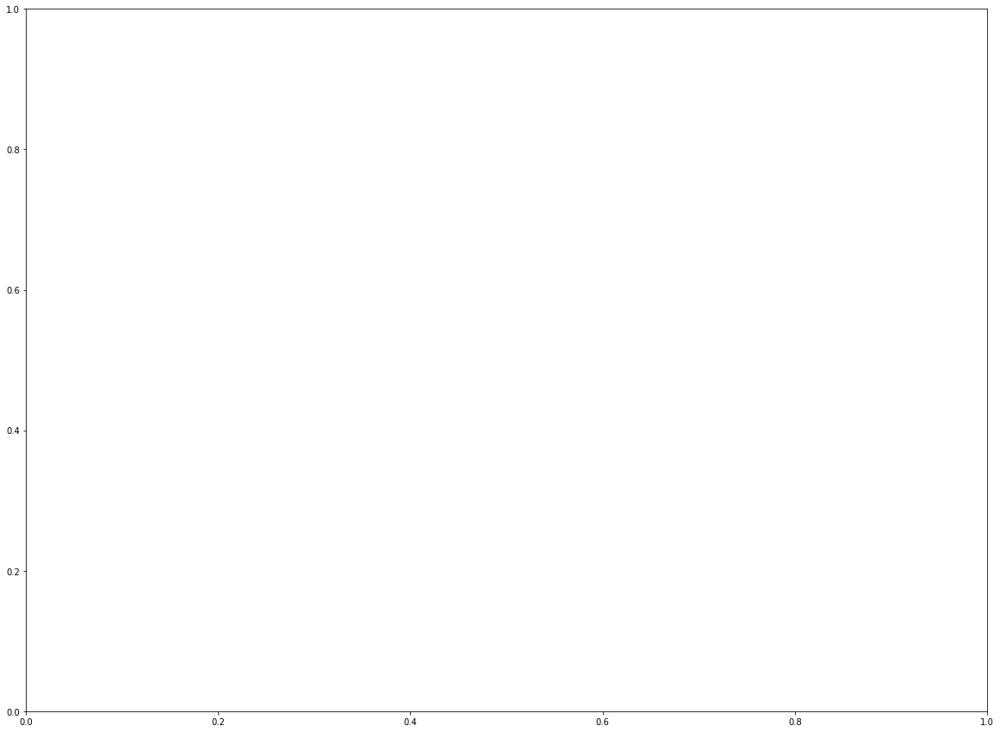

In [292]:
corpus = "googlengrams"
pdf2 = PdfPages('./results/Prefix_all_3gramPOS_synthesis_' + corpus+ '.pdf')

#columns = df.columns
#periods = [elt for elt in columns if re.match("[0-9]{4}-[0-9]{2}-[0-9]{2}", elt)]

# distribution entre les prefixes
fig, ax = plt.subplots(2, figsize=(20, 15))
df.groupby('prefix')['full_count'].count().plot(ax=ax[0],kind="bar",title='Distribution des fréquences entre préfixes (nbre de formations distinctes)', rot=45, figsize=(20,10))  # [['full_count']]
add_value_labels(ax[0])
df.groupby('prefix')['full_count'].sum().plot(ax=ax[1],kind="bar",title="Distribution des fréquences entre préfixes (nbre total d'occurrences)", rot=45, figsize=(20,10))  # [['full_count']]
add_value_labels(ax[1])
fig.text(4.25/8.5, 0.5/11., pdf2.get_pagecount(), ha='center', va='center', fontsize=8)
fig.tight_layout()

pdf2.savefig()
plt.close()

# distribution entre les mots
fig, ax = plt.subplots(2, figsize=(20, 15))
#df.groupby('source')['full_count'].nlargest(20).count().plot(ax=ax[0],kind="bar",title='Distribution des fréquences entre sources (nbre de formations distinctes)', rot=45, figsize=(20,10))  # [['full_count']]
df[df.word.isin(words20)].groupby('word')['full_count'].count().plot(ax=ax[0],kind="bar",title='Distribution des fréquences entre mots (20) (nbre de formations distinctes)', rot=45, figsize=(20,10))  # [['full_count']]
add_value_labels(ax[0])
df[df.word.isin(words20)].groupby('word')['full_count'].sum().plot(ax=ax[1],kind="bar",title="Distribution des fréquences entre mots (20) (nbre total d'occurrences)", rot=45, figsize=(20,10))  # [['full_count']]
add_value_labels(ax[1])
fig.text(4.25/8.5, 0.5/11., pdf2.get_pagecount(), ha='center', va='center', fontsize=8)
fig.tight_layout()

pdf2.savefig()
plt.close()


# distribution entre les pos
fig, ax = plt.subplots(2, figsize=(20, 15))
df.groupby('pos')['full_count'].count().plot(ax=ax[0],kind="bar",title='Distribution des fréquences entre pos  (nbre de formations distinctes)', rot=45, figsize=(20,10))  # [['full_count']]
add_value_labels(ax[0])
df.groupby('pos')['full_count'].sum().plot(ax=ax[1],kind="bar",title="Distribution des fréquences entre pos  (nbre total d'occurrences)", rot=45, figsize=(20,10))  # [['full_count']]
add_value_labels(ax[1])
fig.text(4.25/8.5, 0.5/11., pdf2.get_pagecount(), ha='center', va='center', fontsize=8)
fig.tight_layout()

pdf2.savefig()
plt.close()

# distribution entre les séparateurs
fig, ax = plt.subplots(2, figsize=(20, 15))
df.groupby('sep')['full_count'].count().plot(ax=ax[0],kind="bar",title='Distribution des fréquences entre séparateurs  (nbre de formations distinctes)', rot=45, figsize=(20,10))  # [['full_count']]
add_value_labels(ax[0])
df.groupby('sep')['full_count'].sum().plot(ax=ax[1],kind="bar",title="Distribution des fréquences entre séparateurs  (nbre total d'occurrences)", rot=45, figsize=(20,10))  # [['full_count']]
add_value_labels(ax[1])
fig.text(4.25/8.5, 0.5/11., pdf2.get_pagecount(), ha='center', va='center', fontsize=8)
fig.tight_layout()

pdf2.savefig()
plt.close()




# distribution plots
fig, ax = plt.subplots(8,3, figsize=(20, 15))
# get 0.9 quantile
i = 0
for pref in dist1.index.values:
        dfplot = df[df.prefix == pref]
        sns.distplot(dfplot['full_count'], ax=ax[i][0]).set_title('{} : {} formes distinctes, {} total occurrences (100%)'.format(pref, dist1.loc[pref,'count'], dist1.loc[pref,'sum']))
        # get 0.95 quantile
        q = dfplot["full_count"].quantile(0.9)
        dfplot2 = dfplot[dfplot["full_count"] < q]['full_count']      
        sns.distplot(dfplot2, ax=ax[i][1]).set_title(pref + ' : 90% quantiles')
        #sns.distplot(np.log(dfplot), ax=ax[0])
        sns.boxplot(dfplot2,ax=ax[i][2]).set_title(pref + ' : 90% quantiles')
        i=i+1
fig.text(4.25/8.5, 0.5/11., pdf2.get_pagecount(), ha='center', va='center', fontsize=8)
fig.tight_layout()
pdf2.savefig()
plt.close()         

q = df["full_count"].quantile(0.9)
dfplot2 = df[df["full_count"] < q]      

sns.boxplot(x="prefix", y="full_count", data=dfplot2).set_title("Boîte à moustache des préfixes (fréquences absolues, 90% quantile)")
    # +  (TBD) kind= violin, box, boxen...
pdf2.savefig()
plt.close()


# evolution globale pour chaque préfixe
dfplot = df.groupby('prefix')[periods].sum().T
dfplot.index = pd.to_datetime(dfplot.index)
dfplot_rel = df_rel.groupby('prefix')[periods].sum().T
# freq absolue
fig, ax = plt.subplots(1, figsize=(20, 15))
dfplot.plot(ax=ax,kind="line", title="Evolution des distributions des préfixes (fréquence absolue, périodisation originelle)", rot=45, figsize=(20,10))  # [['full_count']]    
fig.text(4.25/8.5, 0.5/11., pdf2.get_pagecount(), ha='center', va='center', fontsize=8)
pdf2.savefig()
plt.close()


# freq rel
fig, ax = plt.subplots(1, figsize=(20, 15))
dfplot_rel.plot(ax=ax,kind="line", title="Evolution des distributions des préfixes (fréquence relative)", rot=45, figsize=(20,10))  # [['full_count']]    
fig.text(4.25/8.5, 0.5/11., pdf2.get_pagecount(), ha='center', va='center', fontsize=8)
pdf2.savefig()
plt.close()

# evolution nbre de mots distincts
fig, ax = plt.subplots(1, figsize=(20, 15))
for k,grp in df_rel.groupby(['prefix']):
    grp[periods].astype(bool).sum(axis=0).T.plot(legend=True, ax=ax,kind="line", title="Evolution du nombre de formes différentes", rot=45, figsize=(20,10))  # [['full_count']]
fig.text(4.25/8.5, 0.5/11., pdf2.get_pagecount(), ha='center', va='center', fontsize=8)
pdf2.savefig()
plt.close()
  
# evolution nbre de mots distincts
fig, ax = plt.subplots(1, figsize=(20, 15))
df_rel.groupby('prefix')[periods].astype(bool).sum(axis=0).T.plot(ax=ax,kind="line", title=pref + " : évolution du nombre de formes différentes", rot=45, figsize=(20,10))  # [['full_count']]
fig.text(4.25/8.5, 0.5/11., pdf2.get_pagecount(), ha='center', va='center', fontsize=8)
pdf2.savefig()
plt.close()

# evolution globale pour chaque mot (20 plus fréquents)
fig, ax = plt.subplots(1, figsize=(20, 15))
dfplot = df[df.word.isin(words20)].groupby('word')[periods].sum().T
dfplot.index = pd.to_datetime(dfplot.index)
dfplot_rel = df_rel[df_rel.word.isin(words20)].groupby('word')[periods].sum().T
dfplot4=dfplot.resample('5A').sum()
#dfplot.plot(legend=None, ax=ax[0],kind="line", title="Evolution des distributions des mots (fréquence absolue, périodisation originelle)", rot=45, figsize=(20,10))  # [['full_count']]    
#dfplot4.plot(legend=None, ax=ax[1],kind="line", title="Evolution des distributions des mots (fréquence absolue, période 5 ans)", rot=45, figsize=(20,10))  # [['full_count']]    
dfplot_rel.plot(ax=ax,kind="line", title="Evolution des distributions des mots (fréquence relative)", rot=45, figsize=(20,10))  # [['full_count']]    
fig.text(4.25/8.5, 0.5/11., pdf2.get_pagecount(), ha='center', va='center', fontsize=8)
fig.tight_layout()
pdf2.savefig()
plt.close()


# evolution globale pour chaque pos
fig, ax = plt.subplots(1, figsize=(20, 15))
dfplot = df.groupby('pos')[periods].sum().T
dfplot.index = pd.to_datetime(dfplot.index)
dfplot_rel = df_rel.groupby('pos')[periods].sum().T
dfplot4=dfplot.resample('5A').sum()
#dfplot.plot(legend=None, ax=ax[0],kind="line", title="Evolution des distributions des séparateurs (fréquence absolue, périodisation originelle)", rot=45, figsize=(20,10))  # [['full_count']]    
#dfplot4.plot(legend=None, ax=ax[1],kind="line", title="Evolution des distributions des séparateurs (fréquence absolue, période 5 ans)", rot=45, figsize=(20,10))  # [['full_count']]    
dfplot_rel.plot(ax=ax,kind="line", title="Evolution des distributions des pos (fréquence relative)", rot=45, figsize=(20,10))  # [['full_count']]    
fig.text(4.25/8.5, 0.5/11., pdf2.get_pagecount(), ha='center', va='center', fontsize=8)
fig.tight_layout()
pdf2.savefig()
plt.close()


# evolution globale pour chaque séparateur
fig, ax = plt.subplots(1, figsize=(20, 15))
dfplot = df.groupby('sep')[periods].sum().T
dfplot.index = pd.to_datetime(dfplot.index)
dfplot_rel = df_rel.groupby('sep')[periods].sum().T
dfplot4=dfplot.resample('5A').sum()
#dfplot.plot(legend=None, ax=ax[0],kind="line", title="Evolution des distributions des séparateurs (fréquence absolue, périodisation originelle)", rot=45, figsize=(20,10))  # [['full_count']]    
#dfplot4.plot(legend=None, ax=ax[1],kind="line", title="Evolution des distributions des séparateurs (fréquence absolue, période 5 ans)", rot=45, figsize=(20,10))  # [['full_count']]    
dfplot_rel.plot(ax=ax,kind="line", title="Evolution des distributions des séparateurs (fréquence relative)", rot=45, figsize=(20,10))  # [['full_count']]    
fig.text(4.25/8.5, 0.5/11., pdf2.get_pagecount(), ha='center', va='center', fontsize=8)
fig.tight_layout()
pdf2.savefig()
plt.close()




# get 0.9 quantile
i = 0
fig, ax = plt.subplots(2,2, figsize=(20, 15))
for pref in dist1.index.values:
    dfplot3 = df_rel[df_rel.prefix == pref].set_index('word')[periods].T
    dfplot3.index = pd.to_datetime(dfplot3.index)
    #dfplot4=dfplot3.resample('1W').sum()
    dfplotdiffres = dfplot3.apply(np.ceil).diff()

    dfdiffok = dfplotdiffres.apply(lambda x : x.value_counts(), axis=1)
    dfdiffok.rename(columns={-1.0:'disparition',
                          0.0:'conservation',
                          1.0:'apparition'}, 
                 inplace=True)
    #print(dfdiffok)
    dfdiffok.plot(ax=ax[i][0], title=pref + ": vocabulaire conservé, apparaissant et disparaissant")

    dfplotdiffres['mean_diff'] = dfplot3.diff().apply(lambda x : x.mean(), axis=1)
    dfplotdiffres['mean_diff'].plot(ax=ax[i][1], title=pref + ": moyenne de l'évolution des mots construits (fréquence relative pour base)")

    if i==1:
        fig.tight_layout()
        pdf2.savefig()
        #fig, ax = plt.subplots(2,2, figsize=(20, 15))
        i=0
    else:
        i=i+1
        




# moving average, trends etc.
df5 = df_rel.groupby('prefix').sum()[periods]
for pref in dist1.index.values : #df5.index.values:
    series = df5.loc[pref]
    #series.index = series.index.resample("W", how='sum')
    ts = pd.DataFrame({'data':series.values}, index=series.index) # 'year':seriesrel.index, 

    ts['z_data'] = (ts['data'] - ts.data.rolling(window=10).mean()) / ts.data.rolling(window=10).std()
    #ts['zp_data'] = ts['z_data'] - ts['z_data'].shift(10)
    plot_rolling_simple(ts,title= pref, window=10)
    fig.text(4.25/8.5, 0.5/11., pdf2.get_pagecount(), ha='center', va='center', fontsize=8)
    pdf2.savefig()
    plt.close()
pdf2.close()

### par préfixe

for pref in dist1.index.values:
    pdf2 = PdfPages('./results/' + pref + '_1gram_POS_synthesis_' + corpus + '.pdf')
    dfpref = df[df.prefix==pref]
    dfwpref = df_rel[df_rel.prefix==pref]
    dfpref_rel = df_rel[df_rel.prefix==pref]

    words = dfpref.groupby('word')['full_count'].agg(['count','sum']).sort_values('sum', ascending=False)
   # print(sources)
    words20pref = list(words.index.values)[0:20]
    #print(list(sources.index.values)[0:20])    

    
    # distribution 
    fig, ax = plt.subplots(2, figsize=(20, 15))
    dfpref.groupby('prefix')['full_count'].count().plot(ax=ax[0],kind="bar",title=pref + ' : distribution des fréquences (nbre de formations distinctes)', rot=45, figsize=(20,10))  # [['full_count']]
    add_value_labels(ax[0])
    dfpref.groupby('prefix')['full_count'].sum().plot(ax=ax[1],kind="bar",title=pref + " : distribution des fréquences (nbre total d'occurrences)", rot=45, figsize=(20,10))  # [['full_count']]
    add_value_labels(ax[1])
    fig.text(4.25/8.5, 0.5/11., pdf2.get_pagecount(), ha='center', va='center', fontsize=8)
    fig.tight_layout()

    pdf2.savefig()
    plt.close()

    
    
    # distribution entre les mots générés les plus fréquents d'informations
    fig, ax = plt.subplots(2, figsize=(20, 15))
    #df.groupby('source')['full_count'].nlargest(20).count().plot(ax=ax[0],kind="bar",title='Distribution des fréquences entre sources (nbre de formations distinctes)', rot=45, figsize=(20,10))  # [['full_count']]
    dfpref[df.word.isin(words20pref)].groupby('word')['full_count'].count().plot(ax=ax[0],kind="bar",title='Distribution des fréquences entre mots (20) (nbre de formations distinctes)', rot=45, figsize=(20,10))  # [['full_count']]
    add_value_labels(ax[0])
    dfpref[df.word.isin(words20pref)].groupby('word')['full_count'].sum().plot(ax=ax[1],kind="bar",title="Distribution des fréquences entre mots (20) (nbre total d'occurrences)", rot=45, figsize=(20,10))  # [['full_count']]
    add_value_labels(ax[1])
    fig.text(4.25/8.5, 0.5/11., pdf2.get_pagecount(), ha='center', va='center', fontsize=8)
    fig.tight_layout()
    
    pdf2.savefig()
    plt.close()
 
    # distribution entre les pos de mots
    fig, ax = plt.subplots(2, figsize=(20, 15))
    #df.groupby('source')['full_count'].nlargest(20).count().plot(ax=ax[0],kind="bar",title='Distribution des fréquences entre sources (nbre de formations distinctes)', rot=45, figsize=(20,10))  # [['full_count']]
    dfpref.groupby('pos')['full_count'].count().plot(ax=ax[0],kind="bar",title='Distribution des fréquences entre pos  (nbre de formations distinctes)', rot=45, figsize=(20,10))  # [['full_count']]
    add_value_labels(ax[0])
    dfpref.groupby('pos')['full_count'].sum().plot(ax=ax[1],kind="bar",title="Distribution des fréquences entre pos  (nbre total d'occurrences)", rot=45, figsize=(20,10))  # [['full_count']]
    add_value_labels(ax[1])
    fig.text(4.25/8.5, 0.5/11., pdf2.get_pagecount(), ha='center', va='center', fontsize=8)
    fig.tight_layout()
    
    pdf2.savefig()
    plt.close()
    # distribution entre les séparateurs de mots
    fig, ax = plt.subplots(2, figsize=(20, 15))
    #df.groupby('source')['full_count'].nlargest(20).count().plot(ax=ax[0],kind="bar",title='Distribution des fréquences entre sources (nbre de formations distinctes)', rot=45, figsize=(20,10))  # [['full_count']]
    dfpref.groupby('sep')['full_count'].count().plot(ax=ax[0],kind="bar",title='Distribution des fréquences entre séparateurs  (nbre de formations distinctes)', rot=45, figsize=(20,10))  # [['full_count']]
    add_value_labels(ax[0])
    dfpref.groupby('sep')['full_count'].sum().plot(ax=ax[1],kind="bar",title="Distribution des fréquences entre séparateurs  (nbre total d'occurrences)", rot=45, figsize=(20,10))  # [['full_count']]
    add_value_labels(ax[1])
    fig.text(4.25/8.5, 0.5/11., pdf2.get_pagecount(), ha='center', va='center', fontsize=8)
    fig.tight_layout()
    
    pdf2.savefig()
    plt.close()
  
    
    # distribution plots
    fig, ax = plt.subplots(3, figsize=(20, 15))
    dfplot = dfpref
    sns.distplot(dfplot['full_count'], ax=ax[0]).set_title('{} : {} formes distinctes, {} total occurrences (100%)'.format(pref, dist1.loc[pref,'count'], dist1.loc[pref,'sum']))
    # get 0.95 quantile
    q = dfplot["full_count"].quantile(0.9)
    dfplot2 = dfplot[dfplot["full_count"] < q]['full_count']      
    sns.distplot(dfplot2, ax=ax[1]).set_title(pref + ' : 90% quantiles')
    #sns.distplot(np.log(dfplot), ax=ax[0])
    sns.boxplot(dfplot2,ax=ax[2]).set_title(pref + ' : 90% quantiles')
    fig.text(4.25/8.5, 0.5/11., pdf2.get_pagecount(), ha='center', va='center', fontsize=8)
    fig.tight_layout()
    pdf2.savefig()
    plt.close()         
    
    
    
    # evolution globale pour chaque préfixe
    dfplot = dfpref[periods].sum().T
    dfplot.index = pd.to_datetime(dfplot.index)
    dfplot_rel = dfpref_rel[periods].sum().T
    # freq absolue
    fig, ax = plt.subplots(1, figsize=(20, 15))
    dfplot.plot(ax=ax,kind="line", title=pref + " : évolution des distributions des préfixes (fréquence absolue, périodisation originelle)", rot=45, figsize=(20,10))  # [['full_count']]    
    fig.text(4.25/8.5, 0.5/11., pdf2.get_pagecount(), ha='center', va='center', fontsize=8)
    pdf2.savefig()
    plt.close()
    
    
    # freq rel
    fig, ax = plt.subplots(1, figsize=(20, 15))
    dfplot_rel.plot(ax=ax,kind="line", title=pref + " : évolution des distributions des préfixes (fréquence relative)", rot=45, figsize=(20,10))  # [['full_count']]    
    fig.text(4.25/8.5, 0.5/11., pdf2.get_pagecount(), ha='center', va='center', fontsize=8)
    pdf2.savefig()
    plt.close()
    
    # evolution nbre de mots distincts
    fig, ax = plt.subplots(1, figsize=(20, 15))
    dfpref[periods].astype(bool).sum(axis=0).T.plot(ax=ax,kind="line", title=pref + " : évolution du nombre de formes différentes", rot=45, figsize=(20,10))  # [['full_count']]
    fig.text(4.25/8.5, 0.5/11., pdf2.get_pagecount(), ha='center', va='center', fontsize=8)
    pdf2.savefig()
    plt.close()
    
     # evolution globale pour chaque mot
    fig, ax = plt.subplots(1, figsize=(20, 15))
    dfplot = dfpref[dfpref.word.isin(words20pref)].groupby('word')[periods].sum().T
    dfplot.index = pd.to_datetime(dfplot.index)
    dfplot_rel = dfpref_rel[dfpref_rel.word.isin(words20pref)].groupby('word')[periods].sum().T
    dfplot4=dfplot.resample('5A').sum()
#    dfplot.plot(legend=None, ax=ax[0],kind="line", title="Evolution des distributions des mots (fréquence absolue, périodisation originelle)", rot=45, figsize=(20,10))  # [['full_count']]    
#    dfplot4.plot(legend=None, ax=ax[1],kind="line", title="Evolution des distributions des mots (fréquence absolue, période 5 ans)", rot=45, figsize=(20,10))  # [['full_count']]    
    dfplot_rel.plot(ax=ax,kind="line", title=pref + " : évolution des distributions des mots (fréquence relative)", rot=45, figsize=(20,10))  # [['full_count']]    
    fig.text(4.25/8.5, 0.5/11., pdf2.get_pagecount(), ha='center', va='center', fontsize=8)
    fig.tight_layout()
    pdf2.savefig()
    plt.close()

   
     # evolution globale pour chaque pos
    fig, ax = plt.subplots(1, figsize=(20, 15))
    dfplot = dfpref.groupby('pos')[periods].sum().T
    dfplot.index = pd.to_datetime(dfplot.index)
    dfplot_rel = dfpref_rel.groupby('pos')[periods].sum().T
    dfplot4=dfplot.resample('5A').sum()
    #dfplot.plot(legend=None, ax=ax[0],kind="line", title="Evolution des distributions des séparateurs (fréquence absolue, périodisation originelle)", rot=45, figsize=(20,10))  # [['full_count']]    
    #dfplot4.plot(legend=None, ax=ax[1],kind="line", title="Evolution des distributions des séparateurs (fréquence absolue, période 5 ans)", rot=45, figsize=(20,10))  # [['full_count']]    
    dfplot_rel.plot(ax=ax,kind="line", title=pref + " : évolution des distributions des pos (fréquence relative)", rot=45, figsize=(20,10))  # [['full_count']]    
    fig.text(4.25/8.5, 0.5/11., pdf2.get_pagecount(), ha='center', va='center', fontsize=8)
    fig.tight_layout()
    pdf2.savefig()
    plt.close()
    

     # evolution globale pour chaque séparateur
    fig, ax = plt.subplots(1, figsize=(20, 15))
    dfplot = dfpref.groupby('sep')[periods].sum().T
    dfplot.index = pd.to_datetime(dfplot.index)
    dfplot_rel = dfpref_rel.groupby('sep')[periods].sum().T
    dfplot4=dfplot.resample('5A').sum()
    #dfplot.plot(legend=None, ax=ax[0],kind="line", title="Evolution des distributions des séparateurs (fréquence absolue, périodisation originelle)", rot=45, figsize=(20,10))  # [['full_count']]    
    #dfplot4.plot(legend=None, ax=ax[1],kind="line", title="Evolution des distributions des séparateurs (fréquence absolue, période 5 ans)", rot=45, figsize=(20,10))  # [['full_count']]    
    dfplot_rel.plot(ax=ax,kind="line", title=pref + " : évolution des distributions des séparateurs (fréquence relative)", rot=45, figsize=(20,10))  # [['full_count']]    
    fig.text(4.25/8.5, 0.5/11., pdf2.get_pagecount(), ha='center', va='center', fontsize=8)
    fig.tight_layout()
    pdf2.savefig()
    plt.close()
    
  
    
    # get 0.9 quantile
    fig, ax = plt.subplots(2, figsize=(20, 15))
    dfplot3 = dfpref_rel.set_index('word')[periods].T
    dfplot3.index = pd.to_datetime(dfplot3.index)
    dfplotdiffres = dfplot3.apply(np.ceil).diff()

    dfdiffok = dfplotdiffres.apply(lambda x : x.value_counts(), axis=1)
    dfdiffok.rename(columns={-1.0:'disparition',
                          0.0:'conservation',
                          1.0:'apparition'}, 
                 inplace=True)
    #print(dfdiffok)
    dfdiffok.plot(ax=ax[0], title=pref + ": vocabulaire conservé, apparaissant et disparaissant")

    dfplotdiffres['mean_diff'] = dfplot3.diff().apply(lambda x : x.mean(), axis=1)
    dfplotdiffres['mean_diff'].plot(ax=ax[1], title=pref + ": moyenne de l'évolution des mots construits (fréquence relative pour base)")

    fig.tight_layout()
    pdf2.savefig()
    plt.close()
    
    
    # moving average, trends etc.
    df5 = dfpref_rel.groupby('prefix').sum()[periods]
    series = df5.loc[pref]
    #series.index = series.index.resample("W", how='sum')
    ts = pd.DataFrame({'data':series.values}, index=series.index) # 'year':seriesrel.index, 

    ts['z_data'] = (ts['data'] - ts.data.rolling(window=10).mean()) / ts.data.rolling(window=10).std()
    #ts['zp_data'] = ts['z_data'] - ts['z_data'].shift(10)
    plot_rolling_simple(ts,title= pref, window=10)
    fig.text(4.25/8.5, 0.5/11., pdf2.get_pagecount(), ha='center', va='center', fontsize=8)
    pdf2.savefig()
    plt.close()
    
    pdf2.close()



## Regroupement dfpos4  : dfpos+dfpos2+dfpos3

### dfpos4

In [26]:
dfpos.sep = 'FUSION'
dfpos2.sep = 'ESPACE'
dfpos3.sep = 'TIRET'

dfpos4 = pd.concat([dfpos, dfpos2, dfpos3],ignore_index=True)
print(dfpos4.info())
print(dfpos4.head())
print(dfpos4.sep.unique())


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3889 entries, 0 to 3888
Columns: 220 entries, 1800 to word
dtypes: float64(51), int64(160), object(9)
memory usage: 6.5+ MB
None
   1800  1801  1802  1803  1804  1805   1806  1807   1808  1809  ...  \
0   1.0   2.0     7     9     5     1    4.0   4.0    5.0    11  ...   
1   0.0   0.0     0     0     0     0    0.0   0.0    0.0     0  ...   
2  11.0  15.0    16    32    30    33   44.0  30.0   48.0    35  ...   
3   1.0   2.0     4     2     3     4    1.0   1.0    5.0     7  ...   
4  19.0  27.0    66   100    78   119  102.0  90.0  114.0    77  ...   

   full_count   pos  posGNG  prefix     sep  string  string1  string2  \
0      6000.0   ADJ     ADJ   archi  FUSION   archi      NaN      NaN   
1        63.0  PREP     ADP   archi  FUSION   archi      NaN      NaN   
2     14434.0   ADV     ADV   archi  FUSION   archi      NaN      NaN   
3      1203.0   DET     DET   archi  FUSION   archi      NaN      NaN   
4     31715.0   NOM    

/Users/emmanuelcartier/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:5: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.

  """


In [27]:
dfpos4 = dfpos4[~(dfpos4.word=='')]
dfpos4.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 3827 entries, 9 to 3888
Columns: 220 entries, 1800 to word
dtypes: float64(51), int64(160), object(9)
memory usage: 6.5+ MB


### dfpos4_rel

In [28]:
dfpos_rel.sep = 'FUSION'
dfpos2_rel.sep = 'ESPACE'
dfpos3_rel.sep = 'TIRET'
dfpos4_rel = pd.concat([dfpos_rel, dfpos2_rel, dfpos3_rel],ignore_index=True)
print(dfpos4_rel.info())
print(dfpos4_rel.head())

print(dfpos4_rel.sep.unique())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3889 entries, 0 to 3888
Columns: 220 entries, 1800 to word
dtypes: float64(211), object(9)
memory usage: 6.5+ MB
None
       1800      1801      1802      1803      1804      1805      1806  \
0  0.000010  0.000014  0.000056  0.000064  0.000042  0.000009  0.000041   
1  0.000000  0.000000  0.000000  0.000000  0.000000  0.000000  0.000000   
2  0.000113  0.000108  0.000128  0.000229  0.000255  0.000285  0.000450   
3  0.000010  0.000014  0.000032  0.000014  0.000025  0.000035  0.000010   
4  0.000196  0.000194  0.000527  0.000716  0.000662  0.001027  0.001042   

       1807      1808      1809  ...  full_count   pos  posGNG  prefix  \
0  0.000035  0.000035  0.000087  ...      6000.0   ADJ     ADJ   archi   
1  0.000000  0.000000  0.000000  ...        63.0  PREP     ADP   archi   
2  0.000264  0.000336  0.000277  ...     14434.0   ADV     ADV   archi   
3  0.000009  0.000035  0.000055  ...      1203.0   DET     DET   archi   
4  0.000793

/Users/emmanuelcartier/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:4: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.

  after removing the cwd from sys.path.


In [29]:
dfpos4_rel = dfpos4_rel[~(dfpos4_rel.word=='')]
dfpos4_rel.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 3827 entries, 9 to 3888
Columns: 220 entries, 1800 to word
dtypes: float64(211), object(9)
memory usage: 6.5+ MB


### courte synthèse

In [30]:
# base for browsing prefixes
dfpos4 =  dfpos4.sort_values(['prefix','sep','pos'], ascending=False)
dist1 = dfpos4.groupby(['prefix','sep','pos'])['full_count'].agg(['count','sum']).sort_values('count', ascending=False)
print(dist1)

#print(dist1.index.values)
print(dist1.loc['maxi','count'])

                      count       sum
prefix sep    pos                    
extra  TIRET  NOM       531  317663.0
              ADJ       483  207918.0
ultra  TIRET  NOM       442  315866.0
super  TIRET  NOM       314   80306.0
hyper  FUSION NOM       153   97534.0
       TIRET  NOM       143   22489.0
ultra  TIRET  ADJ       130   26693.0
extra  ESPACE NOM       126   16870.0
ultra  ESPACE NOM       120   23465.0
super  FUSION NOM       115   86746.0
       ESPACE NOM       105   15267.0
méga   FUSION NOM        78   62058.0
supra  ESPACE NOM        70   22913.0
archi  TIRET  NOM        65   18067.0
extra  ESPACE ADJ        56    8748.0
ultra  FUSION NOM        52   18858.0
archi  FUSION NOM        49  133359.0
hyper  FUSION ADJ        46   25360.0
extra  FUSION NOM        38    5733.0
hyper  ESPACE NOM        33    2443.0
extra  TIRET  ADV        30   12471.0
ultra  ESPACE ADJ        27    1909.0
archi  TIRET  ADJ        27    2967.0
extra  ESPACE ADV        26    4090.0
hyper  TIRET

/Users/emmanuelcartier/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: PerformanceWarning: indexing past lexsort depth may impact performance.
  import sys


In [61]:
# base for browsing prefixes
dist1 = dfpos4.groupby('prefix')['full_count'].agg(['count','sum']).sort_values('count', ascending=False)
print(dist1)

freq1 = dfpos4[dfpos4.full_count==1].groupby('prefix')['full_count'].agg(['count']).sort_values('count', ascending=False)
print(freq1)

print(dist1.index.values)
#print(dist1.loc['maxi','count'])


        count       sum
prefix                 
extra    1416  603476.0
ultra     869  405733.0
super     643  231081.0
hyper     438  162155.0
archi     181  166057.0
supra     162   50221.0
méga      103   66255.0
maxi       15    1583.0
Empty DataFrame
Columns: [count]
Index: []
['extra' 'ultra' 'super' 'hyper' 'archi' 'supra' 'méga' 'maxi']


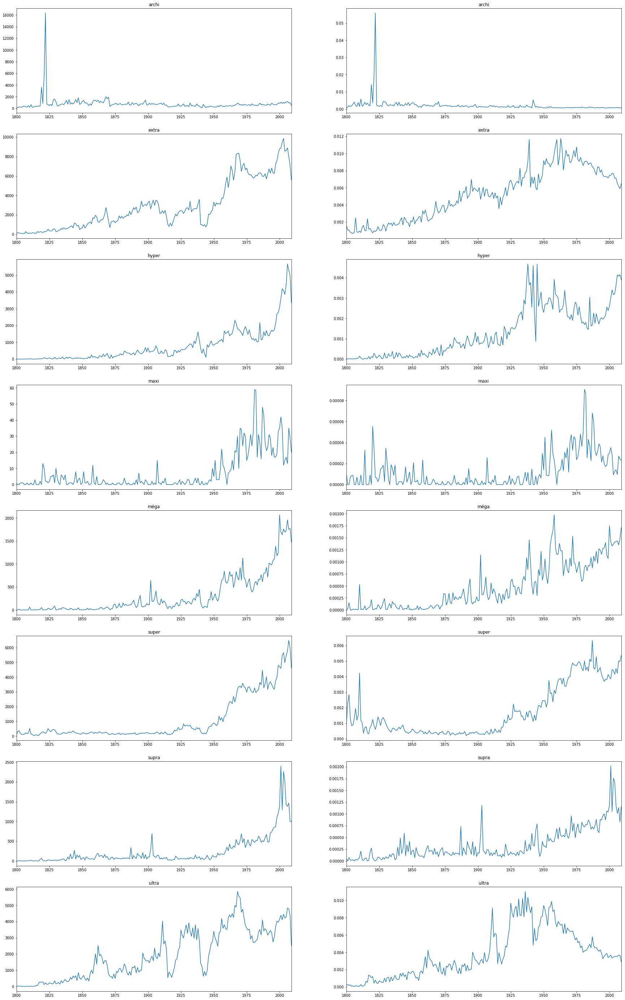

In [44]:


fig, ax = plt.subplots(8,2, figsize=(30, 50))
i=0
for k, grp in dfpos4.groupby('prefix'):                           
    dfpos4[dfpos4.prefix==k][periods].sum().T.plot(ax=ax[i][0], title=k)
    dfpos4_rel[dfpos4_rel.prefix==k][periods].sum().T.plot(ax=ax[i][1], title=k)
    i=i+1

In [39]:
## z-score for distribution by prefix =  (df.value - df.mean) / df.standard_deviation
from scipy.stats import zscore
## 1mean and standard deviation for each prefix
dfpos5 = dfpos4.copy(deep=True)
print(dfpos5.head())
#values = dfpos4.groupby(['prefix','string'])['full_count'].sum()
#print(type(values), values)
prefixes = dfpos5.prefix.unique()
print(prefixes)
for pref in prefixes:
    dfprefix = dfpos5[dfpos5.prefix == pref][['string','full_count']]
    dfprefix["mean"] = dfprefix.full_count.mean()
    dfprefix["std_dev"] = dfprefix.full_count.std()
    dfprefix["z-score"] = (dfprefix.full_count - dfprefix['mean']) / dfprefix.std_dev
    #print(dfprefix)
    #print(k,values.mean(), values.std())

#dfpos5['z-score'] =  (dfpos5.full_count - )


      1800  1801  1802  1803  1804  1805  1806  1807  1808  1809  ...  \
3467   0.0   0.0     0     0     0     0   0.0   0.0   0.0     0  ...   
3505   0.0   0.0     0     0     0     0   0.0   0.0   0.0     0  ...   
3553   0.0   0.0     0     0     0     0   0.0   0.0   0.0     0  ...   
3796   0.0   0.0     0     0     0     0   0.0   0.0   0.0     0  ...   
3812   0.0   0.0     0     0     0     0   0.0   0.0   0.0     0  ...   

      full_count  pos  posGNG  prefix    sep                    string  \
3467       364.0    X       X   ultra  TIRET    ultra_PRT -_PRT high_X   
3505       168.0    X       X   ultra  TIRET     ultra_PRT -_PRT low_X   
3553        65.0    X       X   ultra  TIRET  ultra_PRT -_PRT modern_X   
3796        56.0    X       X   ultra  TIRET   ultra_PRT -_PRT sonic_X   
3812        57.0    X       X   ultra  TIRET   ultra_PRT -_PRT sound_X   

      string1  string2   string3    word  
3467      NaN      NaN    high_X    high  
3505      NaN      NaN     low

### génération csv pour visualisation Néoveille

In [40]:
# for visualization of results
print(dfpos4_rel.columns)
periods = [elt for elt in columns if re.match("[0-9]{4}", elt)]
df5 =  dfpos4_rel.copy(deep=True)
df5tmp = df5[periods]
df5tmp2 = df5[['string','prefix','word','sep','pos']]
#print(df5tmp.info())
#print(df5tmp2.info())

df6 = df5tmp.merge(df5tmp2, right_index = True, left_index = True)
#print(df6.head())
df7 = df6.melt(id_vars = ['string','prefix','word','sep','pos'], value_name = "rel_freq").dropna()
df7.rename(index=str, columns={"variable": "year"}, inplace=True)
df7 = df7[df7.rel_freq > 0]
print(df7.info())
print(df7.head())
df7.to_csv("df_googlengrams_neoveille.csv", index=False)

Index(['1800', '1801', '1802', '1803', '1804', '1805', '1806', '1807', '1808',
       '1809',
       ...
       'full_count', 'pos', 'posGNG', 'prefix', 'sep', 'string', 'string1',
       'string2', 'string3', 'word'],
      dtype='object', length=220)
<class 'pandas.core.frame.DataFrame'>
Index: 194004 entries, 7 to 803660
Data columns (total 7 columns):
string      194004 non-null object
prefix      194004 non-null object
word        194004 non-null object
sep         194004 non-null object
pos         194004 non-null object
year        194004 non-null object
rel_freq    194004 non-null float64
dtypes: float64(1), object(6)
memory usage: 11.8+ MB
None
         string prefix    word     sep  pos  year  rel_freq
7   archicomble  archi  comble  FUSION  NOM  1800  0.000021
20   archiducal  archi   ducal  FUSION  ADJ  1800  0.000010
25   archiduché  archi   duché  FUSION  NOM  1800  0.000021
27    archiducs  archi    ducs  FUSION  NOM  1800  0.000052
44   archipompe  archi   pompe  FUSION

### data synthesis

In [33]:
prefs = df7.prefix.unique()
#dist1 = dfpos4.groupby(['prefix','sep','pos'])['full_count'].agg(['count','sum'])#.sort_values('count', ascending=False)
#dist2 = dfpos4.groupby(['prefix','sep','pos'])['full_count'].agg(['count','sum'])#.sort_values('count', ascending=False)
print(dist1.loc['maxi','count'])
df8 = df7
df8.year.replace({r"^([0-9]{3})([0-9])$":  r'\1\\0', "\\\\":""}, regex=True, inplace=True)
print(df8.year.unique())
    
pdf = PdfPages('synthese_prefixes_googlengrams.pdf')

fig, ax = plt.subplots(8,2, figsize=(30, 50))
# get 0.9 quantile
i = 0
for pref in prefs:
   # df7pivot = df7[df7.prefix == pref].pivot_table("year", "pos", aggfunc=lambda x: len(x.unique()))
    df8pivot = df8[df8.prefix == pref].groupby(['year','pos'])['rel_freq'].mean().unstack()
    sns.heatmap(df8pivot,ax=ax[i][0],  annot=True, fmt="g").set_title(pref + " : Année * POS\nMoyenne de la fréquence relative")#, fmt="d", , annot=True,  title=pref, , linewidths=.5 ,cmap="Blues"
    #plt.show()
    df8pivot = df8[df8.prefix == pref].groupby(['year','sep'])['rel_freq'].mean().unstack()
    sns.heatmap(df8pivot, ax=ax[i][1],annot=True).set_title(pref + " : Année * SEP\nMoyenne de la fréquence relative")#, fmt="d", , annot=True,  title=pref, , linewidths=.5, , fmt=""
    #plt.show()
    i=i+1
fig.tight_layout()
plt.savefig("synthese_prefixes_googlengrams.png")
pdf.savefig()
plt.close()
pdf.close()

15
['180\\0' '181\\0' '182\\0' '183\\0' '184\\0' '185\\0' '186\\0' '187\\0'
 '188\\0' '189\\0' '190\\0' '191\\0' '192\\0' '193\\0' '194\\0' '195\\0'
 '196\\0' '197\\0' '198\\0' '199\\0' '200\\0']


### sauvegarde par préfixe

In [34]:


#print(df4.head())
save_report(dfpos4, 'prefix','prefixes_allgram_googlengrams1800-2010_freq_abs.xls')
#print(df4.head())
save_report(dfpos4_rel, 'prefix','prefixes_allgram_googlengrams1800-2010_freq_rel.xls')



True

In [35]:
# base for browsing prefixes

In [36]:
dist1 = dfpos4.groupby('prefix')['full_count'].agg(['count','sum']).sort_values('count', ascending=False)
print(dist1)
print(dist1.index.values)
#print(dist1.loc['maxi','count'])


        count       sum
prefix                 
extra    1416  603476.0
ultra     869  405733.0
super     643  231081.0
hyper     438  162155.0
archi     181  166057.0
supra     162   50221.0
méga      103   66255.0
maxi       15    1583.0
['extra' 'ultra' 'super' 'hyper' 'archi' 'supra' 'méga' 'maxi']


In [2]:
dfpos4.head()

NameError: name 'dfpos4' is not defined

### synthèse pdf : './results/Prefix_all_POS_synthesis_' + corpus+ '.pdf'

In [37]:
df = dfpos4.copy(deep=True)
df_rel = dfpos4_rel.copy(deep=True)

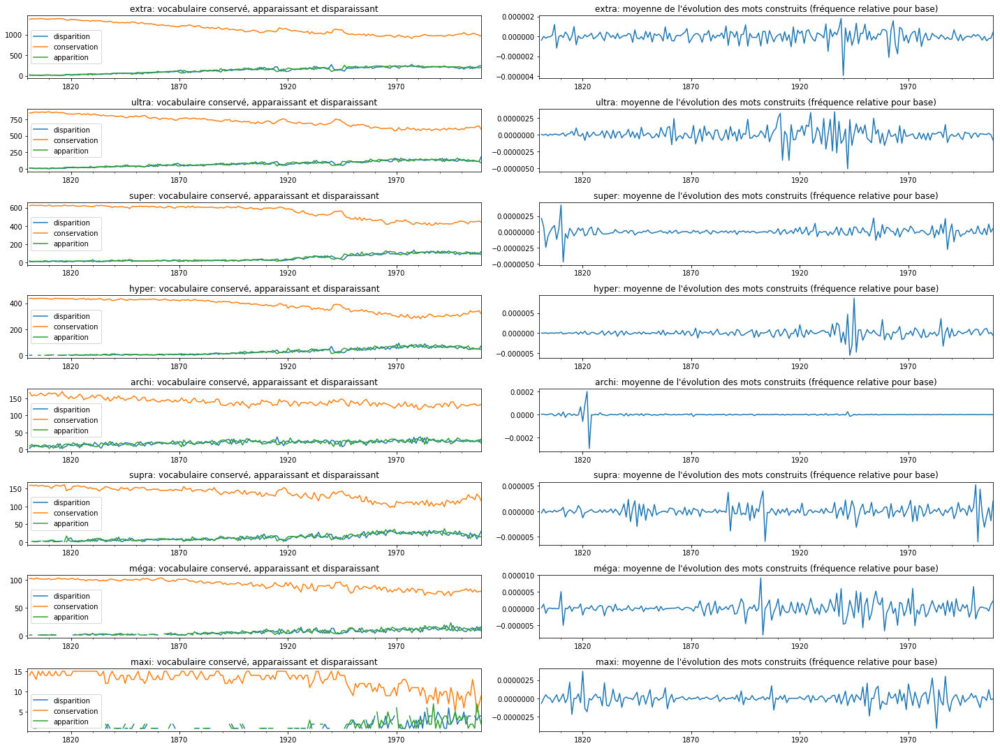

In [48]:
corpus = "googlengrams"
pdf2 = PdfPages('./results/Prefix_all_POS_synthesis_' + corpus+ '.pdf')

#columns = df.columns
#periods = [elt for elt in columns if re.match("[0-9]{4}-[0-9]{2}-[0-9]{2}", elt)]

# distribution entre les prefixes
fig, ax = plt.subplots(3, figsize=(20, 15))
df.groupby('prefix')['full_count'].count().plot(ax=ax[0],kind="bar",title='Distribution des fréquences entre préfixes (nbre de formations distinctes)', rot=45, figsize=(20,10))  # [['full_count']]
add_value_labels(ax[0])
df.groupby('prefix')['full_count'].sum().plot(ax=ax[1],kind="bar",title="Distribution des fréquences entre préfixes (nbre total d'occurrences)", rot=45, figsize=(20,10))  # [['full_count']]
add_value_labels(ax[1])
ax[2].axis("off")
ax[2].table(cellText=dist1.values,
          rowLabels=dist1.index,
          colLabels=dist1.columns,
          cellLoc = 'right', rowLoc = 'center',
          loc='center')
fig.text(4.25/8.5, 0.5/11., pdf2.get_pagecount(), ha='center', va='center', fontsize=8)
fig.tight_layout()

pdf2.savefig()
plt.close()

words = df.groupby('word')['full_count'].agg(['count','sum']).sort_values('sum', ascending=False)
# print(sources)
words20 = list(words.index.values)[0:20]

# distribution entre les mots
fig, ax = plt.subplots(2, figsize=(20, 15))
#df.groupby('source')['full_count'].nlargest(20).count().plot(ax=ax[0],kind="bar",title='Distribution des fréquences entre sources (nbre de formations distinctes)', rot=45, figsize=(20,10))  # [['full_count']]
df[df.word.isin(words20)].groupby('word')['full_count'].count().plot(ax=ax[0],kind="bar",title='Distribution des fréquences entre mots (20) (nbre de formations distinctes)', rot=45, figsize=(20,10))  # [['full_count']]
add_value_labels(ax[0])
df[df.word.isin(words20)].groupby('word')['full_count'].sum().plot(ax=ax[1],kind="bar",title="Distribution des fréquences entre mots (20) (nbre total d'occurrences)", rot=45, figsize=(20,10))  # [['full_count']]
add_value_labels(ax[1])
fig.text(4.25/8.5, 0.5/11., pdf2.get_pagecount(), ha='center', va='center', fontsize=8)
fig.tight_layout()

pdf2.savefig()
plt.close()


# distribution entre les pos
fig, ax = plt.subplots(2, figsize=(20, 15))
df.groupby('pos')['full_count'].count().plot(ax=ax[0],kind="bar",title='Distribution des fréquences entre pos  (nbre de formations distinctes)', rot=45, figsize=(20,10))  # [['full_count']]
add_value_labels(ax[0])
df.groupby('pos')['full_count'].sum().plot(ax=ax[1],kind="bar",title="Distribution des fréquences entre pos  (nbre total d'occurrences)", rot=45, figsize=(20,10))  # [['full_count']]
add_value_labels(ax[1])
fig.text(4.25/8.5, 0.5/11., pdf2.get_pagecount(), ha='center', va='center', fontsize=8)
fig.tight_layout()

pdf2.savefig()
plt.close()

# distribution entre les séparateurs
fig, ax = plt.subplots(2, figsize=(20, 15))
df.groupby('sep')['full_count'].count().plot(ax=ax[0],kind="bar",title='Distribution des fréquences entre séparateurs  (nbre de formations distinctes)', rot=45, figsize=(20,10))  # [['full_count']]
add_value_labels(ax[0])
df.groupby('sep')['full_count'].sum().plot(ax=ax[1],kind="bar",title="Distribution des fréquences entre séparateurs  (nbre total d'occurrences)", rot=45, figsize=(20,10))  # [['full_count']]
add_value_labels(ax[1])
fig.text(4.25/8.5, 0.5/11., pdf2.get_pagecount(), ha='center', va='center', fontsize=8)
fig.tight_layout()

pdf2.savefig()
plt.close()




# distribution plots
fig, ax = plt.subplots(8,3, figsize=(20, 15))
# get 0.9 quantile
i = 0
for pref in dist1.index.values:
        dfplot = df[df.prefix == pref]
        sns.distplot(dfplot['full_count'], ax=ax[i][0]).set_title('{} : {} formes distinctes, {} total occurrences (100%)'.format(pref, dist1.loc[pref,'count'], dist1.loc[pref,'sum']))
        # get 0.95 quantile
        q = dfplot["full_count"].quantile(0.9)
        dfplot2 = dfplot[dfplot["full_count"] < q]['full_count']      
        sns.distplot(dfplot2, ax=ax[i][1]).set_title(pref + ' : 90% quantiles')
        #sns.distplot(np.log(dfplot), ax=ax[0])
        sns.boxplot(dfplot2,ax=ax[i][2]).set_title(pref + ' : 90% quantiles')
        i=i+1
fig.text(4.25/8.5, 0.5/11., pdf2.get_pagecount(), ha='center', va='center', fontsize=8)
fig.tight_layout()
pdf2.savefig()
plt.close()         

fig, ax = plt.subplots(3, figsize=(20, 15))
q = df["full_count"].quantile(0.9)
q2 = df["full_count"].quantile(0.7)
dfplot2 = df[df["full_count"] < q] 
dfplot3 = df[df["full_count"] < q2] 
sns.boxplot(x="prefix", y="full_count", ax=ax[0],data=df).set_title("Boîte à moustache des préfixes (fréquences absolues, 100%)")

sns.boxplot(x="prefix", y="full_count", ax=ax[1], data=dfplot2).set_title("Boîte à moustache des préfixes (fréquences absolues, 90% quantile)")

sns.boxplot(x="prefix", y="full_count", ax=ax[2], data=dfplot3).set_title("Boîte à moustache des préfixes (fréquences absolues, 70% quantile)")
pdf2.savefig()
plt.close()


# evolution globale pour chaque préfixe
dfplot = df.groupby('prefix')[periods].sum().T
dfplot.index = pd.to_datetime(dfplot.index)
dfplot_rel = df_rel.groupby('prefix')[periods].sum().T
# freq absolue
fig, ax = plt.subplots(1, figsize=(20, 15))
dfplot.plot(ax=ax,kind="line", title="Evolution des distributions des préfixes (fréquence absolue, périodisation originelle)", rot=45, figsize=(20,10))  # [['full_count']]    
fig.text(4.25/8.5, 0.5/11., pdf2.get_pagecount(), ha='center', va='center', fontsize=8)
pdf2.savefig()
plt.close()


# freq rel
fig, ax = plt.subplots(1, figsize=(20, 15))
dfplot_rel.plot(ax=ax,kind="line", title="Evolution des distributions des préfixes (fréquence relative)", rot=45, figsize=(20,10))  # [['full_count']]    
fig.text(4.25/8.5, 0.5/11., pdf2.get_pagecount(), ha='center', va='center', fontsize=8)
pdf2.savefig()
plt.close()

# evolution nbre de mots distincts
fig, ax = plt.subplots(1, figsize=(20, 15))

for k,grp in df_rel.groupby(['prefix']):
    #print(k)
    grp[periods].astype(bool).sum(axis=0).T.plot(title=k, legend=True,ax=ax,kind="line", rot=45, figsize=(25,15))  # [['full_count']]
    i=i+1
ax.set_title("Evolution du nombre de formes différentes")
fig.text(4.25/8.5, 0.5/11., pdf2.get_pagecount(), ha='center', va='center', fontsize=8)
pdf2.savefig()
plt.close()





# evolution globale pour chaque mot (20 plus fréquents)
fig, ax = plt.subplots(1, figsize=(20, 15))
dfplot = df[df.word.isin(words20)].groupby('word')[periods].sum().T
dfplot.index = pd.to_datetime(dfplot.index)
dfplot_rel = df_rel[df_rel.word.isin(words20)].groupby('word')[periods].sum().T
dfplot4=dfplot.resample('5A').sum()
#dfplot.plot(legend=None, ax=ax[0],kind="line", title="Evolution des distributions des mots (fréquence absolue, périodisation originelle)", rot=45, figsize=(20,10))  # [['full_count']]    
#dfplot4.plot(legend=None, ax=ax[1],kind="line", title="Evolution des distributions des mots (fréquence absolue, période 5 ans)", rot=45, figsize=(20,10))  # [['full_count']]    
dfplot_rel.plot(ax=ax,kind="line", title="Evolution des distributions des mots (fréquence relative)", rot=45, figsize=(20,10))  # [['full_count']]    
fig.text(4.25/8.5, 0.5/11., pdf2.get_pagecount(), ha='center', va='center', fontsize=8)
fig.tight_layout()
pdf2.savefig()
plt.close()


# evolution globale pour chaque pos
fig, ax = plt.subplots(1, figsize=(20, 15))
dfplot = df.groupby('pos')[periods].sum().T
dfplot.index = pd.to_datetime(dfplot.index)
dfplot_rel = df_rel.groupby('pos')[periods].sum().T
dfplot4=dfplot.resample('5A').sum()
#dfplot.plot(legend=None, ax=ax[0],kind="line", title="Evolution des distributions des séparateurs (fréquence absolue, périodisation originelle)", rot=45, figsize=(20,10))  # [['full_count']]    
#dfplot4.plot(legend=None, ax=ax[1],kind="line", title="Evolution des distributions des séparateurs (fréquence absolue, période 5 ans)", rot=45, figsize=(20,10))  # [['full_count']]    
dfplot_rel.plot(ax=ax,kind="line", title="Evolution des distributions des pos (fréquence relative)", rot=45, figsize=(20,10))  # [['full_count']]    
fig.text(4.25/8.5, 0.5/11., pdf2.get_pagecount(), ha='center', va='center', fontsize=8)
fig.tight_layout()
pdf2.savefig()
plt.close()


# evolution globale pour chaque séparateur
fig, ax = plt.subplots(1, figsize=(20, 15))
dfplot = df.groupby('sep')[periods].sum().T
dfplot.index = pd.to_datetime(dfplot.index)
dfplot_rel = df_rel.groupby('sep')[periods].sum().T
dfplot4=dfplot.resample('5A').sum()
#dfplot.plot(legend=None, ax=ax[0],kind="line", title="Evolution des distributions des séparateurs (fréquence absolue, périodisation originelle)", rot=45, figsize=(20,10))  # [['full_count']]    
#dfplot4.plot(legend=None, ax=ax[1],kind="line", title="Evolution des distributions des séparateurs (fréquence absolue, période 5 ans)", rot=45, figsize=(20,10))  # [['full_count']]    
dfplot_rel.plot(ax=ax,kind="line", title="Evolution des distributions des séparateurs (fréquence relative)", rot=45, figsize=(20,10))  # [['full_count']]    
fig.text(4.25/8.5, 0.5/11., pdf2.get_pagecount(), ha='center', va='center', fontsize=8)
fig.tight_layout()
pdf2.savefig()
plt.close()





# get 0.9 quantile
i = 0
fig, ax = plt.subplots(8,2, figsize=(20, 15))
for pref in dist1.index.values:
    dfplot3 = df_rel[df_rel.prefix == pref].set_index('word')[periods].T # word
    dfplot3.index = pd.to_datetime(dfplot3.index)
    #dfplot4=dfplot3.resample('1W').sum()
    dfplotdiffres = dfplot3.apply(np.ceil).diff()

    dfdiffok = dfplotdiffres.apply(lambda x : x.value_counts(), axis=1)
    dfdiffok.rename(columns={-1.0:'disparition',
                          0.0:'conservation',
                          1.0:'apparition'}, 
                 inplace=True)
    #print(dfdiffok)
    dfdiffok.plot(ax=ax[i][0], title=pref + ": vocabulaire conservé, apparaissant et disparaissant")

    dfplotdiffres['mean_diff'] = dfplot3.diff().apply(lambda x : x.mean(), axis=1)
    dfplotdiffres['mean_diff'].plot(ax=ax[i][1], title=pref + ": moyenne de l'évolution des mots construits (fréquence relative pour base)")

    if i==7:
        fig.tight_layout()
        pdf2.savefig()
        #fig, ax = plt.subplots(2,2, figsize=(20, 15))
        i=0
    else:
        i=i+1
        

def plot_rolling(df,title, ax, window=10):
    ax.plot(df.index, df.data, label='raw data')
    ax.plot(df.data.rolling(window=window).mean(), label="rolling mean (window=" + str(window) + ")")
    ax.plot(df.data.rolling(window=window).std(), label="rolling std (window=" + str(window) + ")")
    ax.legend()
    ax.set_title(title)


# moving average, trends etc.
fig, ax = plt.subplots(8, figsize=(20, 15))
i=0
df5 = df_rel.groupby('prefix').sum()[periods]
for pref in dist1.index.values : #df5.index.values:
    series = df5.loc[pref]
    #series.index = series.index.resample("W", how='sum')
    ts = pd.DataFrame({'data':series.values}, index=series.index) # 'year':seriesrel.index, 

    ts['z_data'] = (ts['data'] - ts.data.rolling(window=10).mean()) / ts.data.rolling(window=10).std()
    #ts['zp_data'] = ts['z_data'] - ts['z_data'].shift(10)
    plot_rolling(ts,pref,ax[i], window=10)
    i=i+1
plt.tight_layout()
fig.text(4.25/8.5, 0.5/11., pdf2.get_pagecount(), ha='center', va='center', fontsize=8)
pdf2.savefig()

plt.close()
pdf2.close()



In [51]:
### par préfixe

for pref in dist1.index.values:
    pdf2 = PdfPages('./results/' + pref + '_all_POS_synthesis_' + corpus + '.pdf')
    dfpref = df[df.prefix==pref]
    dfwpref = df_rel[df_rel.prefix==pref]
    dfpref_rel = df_rel[df_rel.prefix==pref]

    words = dfpref.groupby('word')['full_count'].agg(['count','sum']).sort_values('sum', ascending=False)
   # print(sources)
    words20pref = list(words.index.values)[0:20]
    #print(list(sources.index.values)[0:20])    

    
    # distribution 
    fig, ax = plt.subplots(2, figsize=(20, 15))
    dfpref.groupby('prefix')['full_count'].count().plot(ax=ax[0],kind="bar",title=pref + ' : distribution des fréquences (nbre de formations distinctes)', rot=45, figsize=(20,10))  # [['full_count']]
    add_value_labels(ax[0])
    dfpref.groupby('prefix')['full_count'].sum().plot(ax=ax[1],kind="bar",title=pref + " : distribution des fréquences (nbre total d'occurrences)", rot=45, figsize=(20,10))  # [['full_count']]
    add_value_labels(ax[1])
    fig.text(4.25/8.5, 0.5/11., pdf2.get_pagecount(), ha='center', va='center', fontsize=8)
    fig.tight_layout()

    pdf2.savefig()
    plt.close()

    
    
    # distribution entre les mots générés les plus fréquents d'informations
    fig, ax = plt.subplots(2, figsize=(20, 15))
    #df.groupby('source')['full_count'].nlargest(20).count().plot(ax=ax[0],kind="bar",title='Distribution des fréquences entre sources (nbre de formations distinctes)', rot=45, figsize=(20,10))  # [['full_count']]
    dfpref[df.word.isin(words20pref)].groupby('word')['full_count'].count().plot(ax=ax[0],kind="bar",title='Distribution des fréquences entre mots (20) (nbre de formations distinctes)', rot=45, figsize=(20,10))  # [['full_count']]
    add_value_labels(ax[0])
    dfpref[df.word.isin(words20pref)].groupby('word')['full_count'].sum().plot(ax=ax[1],kind="bar",title="Distribution des fréquences entre mots (20) (nbre total d'occurrences)", rot=45, figsize=(20,10))  # [['full_count']]
    add_value_labels(ax[1])
    fig.text(4.25/8.5, 0.5/11., pdf2.get_pagecount(), ha='center', va='center', fontsize=8)
    fig.tight_layout()
    
    pdf2.savefig()
    plt.close()
 
    # distribution entre les pos de mots
    fig, ax = plt.subplots(2, figsize=(20, 15))
    #df.groupby('source')['full_count'].nlargest(20).count().plot(ax=ax[0],kind="bar",title='Distribution des fréquences entre sources (nbre de formations distinctes)', rot=45, figsize=(20,10))  # [['full_count']]
    dfpref.groupby('pos')['full_count'].count().plot(ax=ax[0],kind="bar",title='Distribution des fréquences entre pos  (nbre de formations distinctes)', rot=45, figsize=(20,10))  # [['full_count']]
    add_value_labels(ax[0])
    dfpref.groupby('pos')['full_count'].sum().plot(ax=ax[1],kind="bar",title="Distribution des fréquences entre pos  (nbre total d'occurrences)", rot=45, figsize=(20,10))  # [['full_count']]
    add_value_labels(ax[1])
    fig.text(4.25/8.5, 0.5/11., pdf2.get_pagecount(), ha='center', va='center', fontsize=8)
    fig.tight_layout()
    
    pdf2.savefig()
    plt.close()
    # distribution entre les séparateurs de mots
    fig, ax = plt.subplots(2, figsize=(20, 15))
    #df.groupby('source')['full_count'].nlargest(20).count().plot(ax=ax[0],kind="bar",title='Distribution des fréquences entre sources (nbre de formations distinctes)', rot=45, figsize=(20,10))  # [['full_count']]
    dfpref.groupby('sep')['full_count'].count().plot(ax=ax[0],kind="bar",title='Distribution des fréquences entre séparateurs  (nbre de formations distinctes)', rot=45, figsize=(20,10))  # [['full_count']]
    add_value_labels(ax[0])
    dfpref.groupby('sep')['full_count'].sum().plot(ax=ax[1],kind="bar",title="Distribution des fréquences entre séparateurs  (nbre total d'occurrences)", rot=45, figsize=(20,10))  # [['full_count']]
    add_value_labels(ax[1])
    fig.text(4.25/8.5, 0.5/11., pdf2.get_pagecount(), ha='center', va='center', fontsize=8)
    fig.tight_layout()
    
    pdf2.savefig()
    plt.close()
  
    
    # distribution plots
    fig, ax = plt.subplots(3, figsize=(20, 15))
    dfplot = dfpref
    sns.distplot(dfplot['full_count'], ax=ax[0]).set_title('{} : {} formes distinctes, {} total occurrences (100%)'.format(pref, dist1.loc[pref,'count'], dist1.loc[pref,'sum']))
    # get 0.95 quantile
    q = dfplot["full_count"].quantile(0.9)
    dfplot2 = dfplot[dfplot["full_count"] < q]['full_count']      
    sns.distplot(dfplot2, ax=ax[1]).set_title(pref + ' : 90% quantiles')
    #sns.distplot(np.log(dfplot), ax=ax[0])
    sns.boxplot(dfplot2,ax=ax[2]).set_title(pref + ' : 90% quantiles')
    fig.text(4.25/8.5, 0.5/11., pdf2.get_pagecount(), ha='center', va='center', fontsize=8)
    fig.tight_layout()
    pdf2.savefig()
    plt.close()         
    
    
    
    # evolution globale pour chaque préfixe
    dfplot = dfpref[periods].sum().T
    dfplot.index = pd.to_datetime(dfplot.index)
    dfplot_rel = dfpref_rel[periods].sum().T
    # freq absolue
    fig, ax = plt.subplots(1, figsize=(20, 15))
    dfplot.plot(ax=ax,kind="line", title=pref + " : évolution des distributions des préfixes (fréquence absolue, périodisation originelle)", rot=45, figsize=(20,10))  # [['full_count']]    
    fig.text(4.25/8.5, 0.5/11., pdf2.get_pagecount(), ha='center', va='center', fontsize=8)
    pdf2.savefig()
    plt.close()
    
    
    # freq rel
    fig, ax = plt.subplots(1, figsize=(20, 15))
    dfplot_rel.plot(ax=ax,kind="line", title=pref + " : évolution des distributions des préfixes (fréquence relative)", rot=45, figsize=(20,10))  # [['full_count']]    
    fig.text(4.25/8.5, 0.5/11., pdf2.get_pagecount(), ha='center', va='center', fontsize=8)
    pdf2.savefig()
    plt.close()
    
    # evolution nbre de mots distincts
    fig, ax = plt.subplots(1, figsize=(20, 15))
    dfpref[periods].astype(bool).sum(axis=0).T.plot(ax=ax,kind="line", title=pref + " : évolution du nombre de formes différentes", rot=45, figsize=(20,10))  # [['full_count']]
    fig.text(4.25/8.5, 0.5/11., pdf2.get_pagecount(), ha='center', va='center', fontsize=8)
    pdf2.savefig()
    plt.close()
    
     # evolution globale pour chaque mot
    fig, ax = plt.subplots(1, figsize=(20, 15))
    dfplot = dfpref[dfpref.word.isin(words20pref)].groupby('word')[periods].sum().T
    dfplot.index = pd.to_datetime(dfplot.index)
    dfplot_rel = dfpref_rel[dfpref_rel.word.isin(words20pref)].groupby('word')[periods].sum().T
    dfplot4=dfplot.resample('5A').sum()
#    dfplot.plot(legend=None, ax=ax[0],kind="line", title="Evolution des distributions des mots (fréquence absolue, périodisation originelle)", rot=45, figsize=(20,10))  # [['full_count']]    
#    dfplot4.plot(legend=None, ax=ax[1],kind="line", title="Evolution des distributions des mots (fréquence absolue, période 5 ans)", rot=45, figsize=(20,10))  # [['full_count']]    
    dfplot_rel.plot(ax=ax,kind="line", title=pref + " : évolution des distributions des mots (fréquence relative)", rot=45, figsize=(20,10))  # [['full_count']]    
    fig.text(4.25/8.5, 0.5/11., pdf2.get_pagecount(), ha='center', va='center', fontsize=8)
    fig.tight_layout()
    pdf2.savefig()
    plt.close()

   
     # evolution globale pour chaque pos
    fig, ax = plt.subplots(1, figsize=(20, 15))
    dfplot = dfpref.groupby('pos')[periods].sum().T
    dfplot.index = pd.to_datetime(dfplot.index)
    dfplot_rel = dfpref_rel.groupby('pos')[periods].sum().T
    dfplot4=dfplot.resample('5A').sum()
    #dfplot.plot(legend=None, ax=ax[0],kind="line", title="Evolution des distributions des séparateurs (fréquence absolue, périodisation originelle)", rot=45, figsize=(20,10))  # [['full_count']]    
    #dfplot4.plot(legend=None, ax=ax[1],kind="line", title="Evolution des distributions des séparateurs (fréquence absolue, période 5 ans)", rot=45, figsize=(20,10))  # [['full_count']]    
    dfplot_rel.plot(ax=ax,kind="line", title=pref + " : évolution des distributions des pos (fréquence relative)", rot=45, figsize=(20,10))  # [['full_count']]    
    fig.text(4.25/8.5, 0.5/11., pdf2.get_pagecount(), ha='center', va='center', fontsize=8)
    fig.tight_layout()
    pdf2.savefig()
    plt.close()
    

     # evolution globale pour chaque séparateur
    fig, ax = plt.subplots(1, figsize=(20, 15))
    dfplot = dfpref.groupby('sep')[periods].sum().T
    dfplot.index = pd.to_datetime(dfplot.index)
    dfplot_rel = dfpref_rel.groupby('sep')[periods].sum().T
    dfplot4=dfplot.resample('5A').sum()
    #dfplot.plot(legend=None, ax=ax[0],kind="line", title="Evolution des distributions des séparateurs (fréquence absolue, périodisation originelle)", rot=45, figsize=(20,10))  # [['full_count']]    
    #dfplot4.plot(legend=None, ax=ax[1],kind="line", title="Evolution des distributions des séparateurs (fréquence absolue, période 5 ans)", rot=45, figsize=(20,10))  # [['full_count']]    
    dfplot_rel.plot(ax=ax,kind="line", title=pref + " : évolution des distributions des séparateurs (fréquence relative)", rot=45, figsize=(20,10))  # [['full_count']]    
    fig.text(4.25/8.5, 0.5/11., pdf2.get_pagecount(), ha='center', va='center', fontsize=8)
    fig.tight_layout()
    pdf2.savefig()
    plt.close()
    
  
    
    # get 0.9 quantile
    fig, ax = plt.subplots(2, figsize=(20, 15))
    dfplot3 = dfpref_rel.set_index('word')[periods].T
    dfplot3.index = pd.to_datetime(dfplot3.index)
    dfplotdiffres = dfplot3.apply(np.ceil).diff()

    dfdiffok = dfplotdiffres.apply(lambda x : x.value_counts(), axis=1)
    dfdiffok.rename(columns={-1.0:'disparition',
                          0.0:'conservation',
                          1.0:'apparition'}, 
                 inplace=True)
    #print(dfdiffok)
    dfdiffok.plot(ax=ax[0], title=pref + ": vocabulaire conservé, apparaissant et disparaissant")

    dfplotdiffres['mean_diff'] = dfplot3.diff().apply(lambda x : x.mean(), axis=1)
    dfplotdiffres['mean_diff'].plot(ax=ax[1], title=pref + ": moyenne de l'évolution des mots construits (fréquence relative pour base)")

    fig.tight_layout()
    pdf2.savefig()
    plt.close()
    
    
    # moving average, trends etc.
    df5 = dfpref_rel.groupby('prefix').sum()[periods]
    series = df5.loc[pref]
    #series.index = series.index.resample("W", how='sum')
    ts = pd.DataFrame({'data':series.values}, index=series.index) # 'year':seriesrel.index, 

    ts['z_data'] = (ts['data'] - ts.data.rolling(window=10).mean()) / ts.data.rolling(window=10).std()
    #ts['zp_data'] = ts['z_data'] - ts['z_data'].shift(10)
    plot_rolling_simple(ts,title= pref, window=10)
    fig.text(4.25/8.5, 0.5/11., pdf2.get_pagecount(), ha='center', va='center', fontsize=8)
    pdf2.savefig()
    plt.close()
    
    pdf2.close()



/Users/emmanuelcartier/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:32: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
/Users/emmanuelcartier/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:34: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
/Users/emmanuelcartier/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:32: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
/Users/emmanuelcartier/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:34: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
/Users/emmanuelcartier/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:32: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
/Users/emmanuelcartier/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:34: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
/Users/emmanuelcartier

In [61]:
corpus='googlengrams'

In [170]:
# ## With Plotly

# In[480]:


# with plotly
import plotly.plotly as py
import plotly.tools as pytools
import plotly.graph_objs as go
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
init_notebook_mode(connected=False)
#pytools.set_credentials_file(username='ecartierdijon', api_key='3msHhM6RjRcAvIpAgcz6')
#help(py.plot) max 25 public graphs
# evolution globale pour chaque préfixe
#fig, ax = plt.subplots(3, figsize=(20, 15))
#df.groupby('prefix')[periods].sum().T.plot(ax=ax[0],kind="line", title="Evolution des distributions des préfixes (fréquence absolue)", rot=45, figsize=(20,10))  # [['full_count']]    
#df_rel.groupby('prefix')[periods].sum().T.plot(ax=ax[1],kind="line", title="Evolution des distributions des préfixes (fréquence relative)", rot=45, figsize=(20,10))  # [['full_count']]    
#for k,grp in df.groupby(['prefix']):
#    grp[periods].astype(bool).sum(axis=0).T.plot(ax=ax[2],kind="line", title="Evolution des nombres de formes différentes par année", rot=45, figsize=(20,10))  # [['full_count']]
#plt.show()


 

# frequence relative
filename = "./plotly_graphs/Evolution_relative-prefixes_nopos_"+corpus+".html"
group_data = df_rel.groupby('prefix').sum()
df6 = group_data[periods].T
#print(df6.head())
data = []
for pref in df6.columns.values:
    linegraph = go.Scatter(
        x=df6.index,
        y=df6[pref],
        name = pref,
        #line = dict(color = '#17BECF'),
        opacity = 0.8)
    data.append(linegraph)

layout = dict(
    title='Evolution des fréquences relatives de 1800 à 2010 : ' + corpus,
    xaxis=dict(
        rangeslider=dict(
            visible = True
        ),
        type='date'
    )
)

fig = dict(data=data, layout=layout)
plot(fig, filename = filename) 


'./plotly_graphs/Evolution_relative-prefixes_nopos_googlengrams.html'

In [171]:



# with plotly -  for more flexibility, use Dash!
import plotly.plotly as py
import plotly.tools as pytools
import plotly.graph_objs as go
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
init_notebook_mode(connected=False)
#pytools.set_credentials_file(username='ecartierdijon', api_key='3msHhM6RjRcAvIpAgcz6')
#help(py.plot) max 25 public graphs


#df.dropna(inplace=True)
#print(df.head())
#df_rel.dropna(inplace=True)
figs = {}
#prefs = ('ultra','super','hyper','hypra','extra','méga','archi','maxi','supra')
# data
i = 0
for pref in dist1.index.values:
        print(pref)
        #if df[df.prefix.str.contains(pref)].word.count() > 0:
        i = i + 1
        dfplot = df[df.prefix == pref].sort_values('full_count', ascending=False).groupby('word').sum() #.set_index('word') # .head(30)
        total_words = len(dfplot.index)
        print(total_words)
        total_occ = dfplot['full_count'].sum()
        print(total_occ)
        dfplotT =  dfplot[periods].T # .groupby('word').sum()
        #print(dfplotT.info())
        #print(dfplotT.head())
        #plot(title= pref + " :  évolution des formations les plus fréquentes (30)")
        #print(dfplot)
        data = []
        for word in dfplotT.columns.values:
            nb_elts = dfplotT[word].sum(axis=0)
            #print(word,nb_elts)
            if nb_elts>3:
                linegraph = go.Scatter(
                    x=dfplotT.index,
                    y=dfplotT[word],
                    name = word,
                    #line = dict(color = '#17BECF'),
                    opacity = 0.8)
                #fig.append_trace(linegraph, i, 1)
                data.append(linegraph)
        print("Done with graphs generation!")

        layout = dict(
            title= pref + " : évolution des fréquences (>3) ("  + str(total_words) + ' mots distincts, ' + str(int(total_occ)) + ' occurrences) : ' + corpus,
            xaxis=dict(
                rangeslider=dict(
                    visible = True
                ),
                type='date'
            )
        )

        #fig.append_trace(dict(data=data, layout=layout), i, 1)
        fig = dict(data=data, layout=layout)
        plot(fig, filename = "./plotly_graphs/Evolution-prefixes-" + pref + "-words-neoveille.html") 
        #figs[pref]=fig
        
        
#for pref in figs.keys():
#    plot(figs[pref], filename = "./plotly_graphs/Evolution-prefixes-" + pref + "-words-neoveille.html") 

extra
920
1665833.0
Done with graphs generation!
super
848
1590597.0
Done with graphs generation!
ultra
613
1137809.0
Done with graphs generation!
hyper
289
537412.0
Done with graphs generation!
supra
234
1491569.0
Done with graphs generation!
archi
107
717964.0
Done with graphs generation!
méga
93
125243.0
Done with graphs generation!
maxi
16
35641.0
Done with graphs generation!


In [136]:
## six graphs for word, pos and sep with evolution and distribution


# with plotly -  for more flexibility, use Dash!
import plotly.plotly as py
import plotly.tools as pytools
import plotly.graph_objs as go
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
init_notebook_mode(connected=False)


fig = pytools.make_subplots(rows=3, cols=1, subplot_titles=('Evolution des mots', 'Evolution des parties du discours'
                                                          ))
i = 0
for pref in dist1.index.values:
        print(pref)
# word
        dfplot = df[df.prefix == pref].sort_values('full_count', ascending=False).groupby('word').sum() #.set_index('word') # .head(30)
        total_words = len(dfplot.index)
        print(total_words)
        total_occ = dfplot['full_count'].sum()
        print(total_occ)
        dfplotT =  dfplot[periods].T 
        title1 = pref + " : évolution des fréquences (>5) ("  + str(total_words) + ' mots distincts, ' + str(int(total_occ)) + ' occurrences) : ' 
        #data = []
        for word in dfplotT.columns.values:
            nb_elts = dfplotT[word].sum(axis=0)
            #print(word,nb_elts)
            if nb_elts>3:
                linegraph = go.Scatter(
                    x=dfplotT.index,
                    y=dfplotT[word],
                    name = word,
                    #line = dict(color = '#17BECF'),
                    opacity = 0.8)
                fig.append_trace(linegraph, 1, 1)
                #data.append(linegraph)
        print("Done for " + pref + " words")
# pos
        dfplot = df[df.prefix == pref].sort_values('full_count', ascending=False).groupby('pos').sum() #.set_index('word') # .head(30)
        total_words = len(dfplot.index)
        print(total_words)
        total_occ = dfplot['full_count'].sum()
        print(total_occ)
        dfplotT =  dfplot[periods].T 
        title2 = pref + " : évolution des parties du discours ("  + str(total_words) + ' mots distincts, ' + str(int(total_occ)) + ' occurrences) : ' 
        #data = []
        for word in dfplotT.columns.values:
            nb_elts = dfplotT[word].sum(axis=0)
            #print(word,nb_elts)
            if nb_elts>3:
                linegraph = go.Scatter(
                    x=dfplotT.index,
                    y=dfplotT[word],
                    showlegend=False,
                    name = word,
                    opacity = 0.8)
                fig.append_trace(linegraph, 2, 1)
                #data.append(linegraph)
        print("Done for " + pref + " pos")

# sep
        dfplot = df[df.prefix == pref].sort_values('full_count', ascending=False).groupby('sep').sum() #.set_index('word') # .head(30)
        total_words = len(dfplot.index)
        print(total_words)
        total_occ = dfplot['full_count'].sum()
        print(total_occ)
        dfplotT =  dfplot[periods].T 
        title3 = pref + " : évolution des séparateurs ("  + str(total_words) + ' sép. distincts, ' + str(int(total_occ)) + ' occurrences) : ' 
        #data = []
        for word in dfplotT.columns.values:
            nb_elts = dfplotT[word].sum(axis=0)
            #print(word,nb_elts)
            if nb_elts>3:
                linegraph = go.Scatter(
                    x=dfplotT.index,
                    y=dfplotT[word],
                    showlegend=False,
                    name = word,
                    opacity = 0.8)
                fig.append_trace(linegraph, 3, 1)
                #data.append(linegraph)
        print("Done for " + pref + " sep")


    #fig.append_trace(trace1, 1, 1)
    #fig.append_trace(trace2, 1, 2)

        fig['layout'].update(title= pref + ' : '+ corpus) # height=600, width=800,        
        plot(fig, filename = "./plotly_graphs/Evolution-prefixes-" + pref + "-words-pos-sep_evolution_distrib.html") 
        #figs[pref]=fig
        
        

This is the format of your plot grid:
[ (1,1) x1,y1 ]
[ (2,1) x2,y2 ]
[ (3,1) x3,y3 ]

extra
998
1718138.0
Done for extra words
10
1718138.0
Done for extra pos
3
1718138.0
Done for extra sep
super
1095
1784317.0
Done for super words
10
1784317.0
Done for super pos
3
1784317.0
Done for super sep
ultra
643
1174032.0
Done for ultra words
10
1174032.0
Done for ultra pos
3
1174032.0
Done for ultra sep
hyper
289
537412.0
Done for hyper words
9
537412.0
Done for hyper pos
3
537412.0
Done for hyper sep
supra
367
1542553.0
Done for supra words
10
1542553.0
Done for supra pos
2
1542553.0
Done for supra sep
archi
108
718582.0
Done for archi words
9
718582.0
Done for archi pos
3
718582.0
Done for archi sep
méga
93
125243.0
Done for méga words
6
125243.0
Done for méga pos
2
125243.0
Done for méga sep
maxi
17
37358.0
Done for maxi words
10
37358.0
Done for maxi pos
3
37358.0
Done for maxi sep


In [126]:
corpus='googlengrams'

# with plotly -  for more flexibility, use Dash!
import plotly.plotly as py
import plotly.tools as pytools
import plotly.graph_objs as go
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
init_notebook_mode(connected=False)
#pytools.set_credentials_file(username='ecartierdijon', api_key='3msHhM6RjRcAvIpAgcz6')
#help(py.plot) max 25 public graphs

figs = {}
#prefs = ('ultra','super','hyper','hypra','extra','méga','archi','maxi','supra')
# data
i = 0
for pref in dist1.index.values:
        print(pref)
        #if df[df.prefix.str.contains(pref)].word.count() > 0:
        i = i + 1
        dfplot = df[df.prefix == pref].sort_values('full_count', ascending=False).groupby('sep').sum() #.set_index('word') # .head(30)
        total_words = len(dfplot.index)
        print(total_words)
        total_occ = dfplot['full_count'].sum()
        print(total_occ)
        dfplotT =  dfplot[periods].T # .groupby('word').sum()
        data = []
        for word in dfplotT.columns.values:
                linegraph = go.Scatter(
                    x=dfplotT.index,
                    y=dfplotT[word],
                    name = word,
                    #line = dict(color = '#17BECF'),
                    opacity = 0.8)
                #fig.append_trace(linegraph, i, 1)
                data.append(linegraph)
        print("Done with graphs generation!")

        layout = dict(
            title= pref + " : évolution des fréquences de séparateurs   ("  + str(total_words) + ' sép. distincts, ' + str(int(total_occ)) + ' occurrences) :' + corpus,
            xaxis=dict(
                rangeslider=dict(
                    visible = True
                ),
                type='date'
            )
        )

        #fig.append_trace(dict(data=data, layout=layout), i, 1)
        fig = dict(data=data, layout=layout)
        plot(fig, filename = "./plotly_graphs/Evolution-prefixes-" + pref + "-sep-"+ corpus +".html") 
        #figs[pref]=fig
        
        
#for pref in figs.keys():
#    plot(figs[pref], filename = "./plotly_graphs/Evolution-prefixes-" + pref + "-words-neoveille.html") 

extra
3
1718138.0
Done with graphs generation!
super
3
1784317.0
Done with graphs generation!
ultra
3
1174032.0
Done with graphs generation!
hyper
3
537412.0
Done with graphs generation!
supra
2
1542553.0
Done with graphs generation!
archi
3
718582.0
Done with graphs generation!
méga
2
125243.0
Done with graphs generation!
maxi
3
37358.0
Done with graphs generation!


In [127]:
corpus='googlengrams'

# with plotly -  for more flexibility, use Dash!
import plotly.plotly as py
import plotly.tools as pytools
import plotly.graph_objs as go
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
init_notebook_mode(connected=False)
#pytools.set_credentials_file(username='ecartierdijon', api_key='3msHhM6RjRcAvIpAgcz6')
#help(py.plot) max 25 public graphs

figs = {}
#prefs = ('ultra','super','hyper','hypra','extra','méga','archi','maxi','supra')
# data
i = 0
for pref in dist1.index.values:
        print(pref)
        #if df[df.prefix.str.contains(pref)].word.count() > 0:
        i = i + 1
        dfplot = df[df.prefix == pref].sort_values('full_count', ascending=False).groupby('pos').sum() #.set_index('word') # .head(30)
        total_words = len(dfplot.index)
        print(total_words)
        total_occ = dfplot['full_count'].sum()
        print(total_occ)
        dfplotT =  dfplot[periods].T # .groupby('word').sum()
        data = []
        for word in dfplotT.columns.values:
                linegraph = go.Scatter(
                    x=dfplotT.index,
                    y=dfplotT[word],
                    name = word,
                    #line = dict(color = '#17BECF'),
                    opacity = 0.8)
                #fig.append_trace(linegraph, i, 1)
                data.append(linegraph)
        print("Done with graphs generation!")

        layout = dict(
            title= pref + " : évolution des fréquences de pos  ("  + str(total_words) + ' sép. distincts, ' + str(int(total_occ)) + ' occurrences) :' + corpus,
            xaxis=dict(
                rangeslider=dict(
                    visible = True
                ),
                type='date'
            )
        )

        #fig.append_trace(dict(data=data, layout=layout), i, 1)
        fig = dict(data=data, layout=layout)
        plot(fig, filename = "./plotly_graphs/Evolution-prefixes-" + pref + "-pos-"+ corpus +".html") 
        #figs[pref]=fig
        
        
#for pref in figs.keys():
#    plot(figs[pref], filename = "./plotly_graphs/Evolution-prefixes-" + pref + "-words-neoveille.html") 

extra
10
1718138.0
Done with graphs generation!
super
10
1784317.0
Done with graphs generation!
ultra
10
1174032.0
Done with graphs generation!
hyper
9
537412.0
Done with graphs generation!
supra
10
1542553.0
Done with graphs generation!
archi
9
718582.0
Done with graphs generation!
méga
6
125243.0
Done with graphs generation!
maxi
10
37358.0
Done with graphs generation!


In [91]:
#print(df.groupby('pos')['full_count'].sum().reset_index())
#print(df.pos.unique())
#print(dist1.index.unique())
#print(df.prefix.unique())
print(df.info())
df2 = df.fillna('__',inplace=True)
print(df2.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 11262 entries, 0 to 11261
Columns: 219 entries, 1800 to word
dtypes: float64(51), int64(160), object(8)
memory usage: 18.8+ MB
None
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 11262 entries, 0 to 11261
Columns: 219 entries, 1800 to word
dtypes: float64(51), int64(160), object(8)
memory usage: 18.8+ MB
None


In [94]:
corpus='googlengram'
df.fillna('__',inplace=True)
dfseppos= df.copy(deep=True)
dfseppos['sep_pos'] = dfseppos['sep'] + '_' + dfseppos['pos']
import plotly.plotly as py
import plotly.tools as pytools
import plotly.graph_objs as go
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
init_notebook_mode(connected=True)

for pref in dist1.index.values:
        print(pref)
        i = i + 1
        dfplot = dfseppos[dfseppos.prefix.str.contains(pref)]#.head(100)
        df1 = dfplot.groupby(['sep_pos'])['full_count'].sum().reset_index()
        print(df1.sep_pos.values)
        print(df1.full_count.values)
        df2 = dfplot.groupby(['sep_pos','word'])['full_count'].sum().reset_index().sort_values('full_count', ascending=False)
        labels = list(df2['word'].values) + list(df1.sep_pos.values)+ [pref]
        parents =  list(df2['sep_pos'].values) + [pref]*len(df1.sep_pos.values)+[""]
        values = list(df2['full_count'].values) + list(df1.full_count.values)+ [sum(df1.full_count.values)]

        trace1 = go.Sunburst(
            labels=labels,
            parents=parents,
            values=values,
            #legend = pref + " : répartition séparateurs - mots",
            domain=dict(column=0),
            
        )

        layout = go.Layout(
            grid=go.layout.Grid(columns=2, rows=1),
            title=go.layout.Title(
                text=pref + " : répartition pos - mots",
                xref='paper',
                x=0
            ),
            #title= 
            margin = go.layout.Margin(t=0, l=0, r=0, b=0),
            sunburstcolorway=[
                    "#636efa","#EF553B","#00cc96","#ab63fa","#19d3f3",
                    "#e763fa", "#FECB52","#FFA15A","#FF6692","#B6E880"
              ],
            extendsunburstcolors=True
        ) 
        fig = dict(data=[trace1], layout=layout)
        plot(fig, filename='./plotly_graphs/' + pref + '_' + corpus +'_pos_word_sunburst_.html')
        
        
        

super
['ESPACE_ADJ' 'ESPACE_ADP' 'ESPACE_ADV' 'ESPACE_CONJ' 'ESPACE_DET'
 'ESPACE_NOUN' 'ESPACE_PRON' 'ESPACE_PRT' 'ESPACE_VERB' 'ESPACE_X'
 'FUSION_ADJ' 'FUSION_ADP' 'FUSION_ADV' 'FUSION_CONJ' 'FUSION_DET'
 'FUSION_NOUN' 'FUSION_PRON' 'FUSION_PRT' 'FUSION_VERB' 'FUSION_X'
 'TIRET_ADJ' 'TIRET_ADV' 'TIRET_DET' 'TIRET_NOUN' 'TIRET_PRON' 'TIRET_PRT'
 'TIRET_VERB' 'TIRET_X']
[4.135000e+03 1.116000e+03 5.168000e+03 2.900000e+02 3.244000e+03
 6.170500e+04 6.010000e+02 6.891000e+03 1.381000e+03 1.631470e+05
 1.503348e+06 4.043000e+03 1.366020e+05 2.539000e+03 1.718700e+04
 2.017410e+05 1.079000e+03 2.048090e+05 7.842880e+05 5.467120e+05
 9.084000e+03 8.600000e+01 5.100000e+01 7.246000e+04 1.480000e+02
 5.500000e+02 6.700000e+02 4.420000e+02]
extra
['ESPACE_ADJ' 'ESPACE_ADP' 'ESPACE_ADV' 'ESPACE_CONJ' 'ESPACE_DET'
 'ESPACE_NOUN' 'ESPACE_PRON' 'ESPACE_PRT' 'ESPACE_VERB' 'ESPACE_X'
 'FUSION_ADJ' 'FUSION_ADP' 'FUSION_ADV' 'FUSION_DET' 'FUSION_NOUN'
 'FUSION_PRON' 'FUSION_PRT' 'FUSION_VERB' 'FUSIO

In [66]:
corpus='googlengram'
df.fillna('__',inplace=True)
#dfseppos= df.copy(deep=True)
#dfseppos['sep_pos'] = dfseppos['sep'] + '_' + dfseppos['pos']
import plotly.plotly as py
import plotly.tools as pytools
import plotly.graph_objs as go
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
init_notebook_mode(connected=True)

for pref in dist1.index.values:
        print(pref)
        i = i + 1
        dfplot = df[df.prefix.str.contains(pref)]#.head(100)
        df1 = dfplot.groupby(['pos'])['full_count'].sum().reset_index()
        print(df1.pos.values)
        print(df1.full_count.values)
        df2 = dfplot.groupby(['pos','word'])['full_count'].sum().reset_index().sort_values('full_count', ascending=False)
        labels = list(df2['word'].values) + list(df1.pos.values)+ [pref]
        parents =  list(df2['pos'].values) + [pref]*len(df1.pos.values)+[""]
        values = list(df2['full_count'].values) + list(df1.full_count.values)+ [sum(df1.full_count.values)]

        trace1 = go.Sunburst(
            labels=labels,
            parents=parents,
            values=values,
            #legend = pref + " : répartition séparateurs - mots",
            domain=dict(column=0),
            
        )
        df1 = dfplot.groupby(['sep'])['full_count'].sum().reset_index()
        print(df1.sep.values)
        print(df1.full_count.values)
        df2 = dfplot.groupby(['sep','pos'])['full_count'].sum().reset_index().sort_values('full_count', ascending=False)
        labels = list(df2['pos'].values) + list(df1.sep.values)+ [pref]
        parents =  list(df2['sep'].values) + [pref]*len(df1.sep.values)+[""]
        values = list(df2['full_count'].values) + list(df1.full_count.values)+ [sum(df1.full_count.values)]

        trace2 = go.Sunburst(
            labels=labels,
            parents=parents,
            values=values,
            #legend = pref + " : répartition séparateurs - mots",
            domain=dict(column=1),
            
        )

        layout = go.Layout(
            grid=go.layout.Grid(columns=2, rows=1),
            title= pref + " :  distribution sep - pos - word",
            margin = go.layout.Margin(t=0, l=0, r=0, b=0),
            sunburstcolorway=[
                    "#636efa","#EF553B","#00cc96","#ab63fa","#19d3f3",
                    "#e763fa", "#FECB52","#FFA15A","#FF6692","#B6E880"
              ],
            extendsunburstcolors=True
        ) 
        fig = dict(data=[trace1,trace2], layout=layout)
        
        #fig = pytools.make_subplots(rows=1, cols=2)

        #fig.append_trace(trace1, 1, 1)
        #fig.append_trace(trace2, 1, 2)

        #fig['layout'].update(height=600, width=800, title='i <3 annotations and subplots')
        
        plot(fig, filename='./plotly_graphs/' + pref + '_' + corpus +'_pos_word_sunburst_.html')
        
        
        

extra
['ADJ' 'ADP' 'ADV' 'CONJ' 'DET' 'NOUN' 'PRON' 'PRT' 'VERB' 'X']
[3.21185e+05 2.52000e+03 2.87900e+03 2.71000e+02 1.95500e+03 2.49646e+05
 2.62300e+03 8.24000e+03 9.08590e+04 1.17220e+04]
['ESPACE' 'FUSION' 'TIRET']
[ 42480. 108696. 540724.]
super
['ADJ' 'ADP' 'ADV' 'CONJ' 'DET' 'NOUN' 'PRON' 'PRT' 'VERB' 'X']
[6.37580e+04 2.19800e+03 3.32200e+03 2.90000e+02 4.21500e+03 1.38372e+05
 4.40000e+02 2.12700e+03 6.61259e+05 3.75210e+04]
['ESPACE' 'FUSION' 'TIRET']
[ 53958. 776053.  83491.]
ultra
['ADJ' 'ADP' 'ADV' 'CONJ' 'DET' 'NOUN' 'PRON' 'PRT' 'VERB' 'X']
[158693.   4294.   3631.    614.   6461. 257698.   1678.  28182.   7085.
  12968.]
['ESPACE' 'FUSION' 'TIRET']
[ 38746.  94780. 347778.]
hyper
['ADJ' 'ADP' 'ADV' 'DET' 'NOUN' 'PRON' 'PRT' 'VERB' 'X']
[ 68156.   1868.   3456.   7502. 288948.   7937.    706.  31917.  13877.]
['ESPACE' 'FUSION' 'TIRET']
[  3816. 396112.  24439.]
supra
['ADJ' 'ADP' 'ADV' 'CONJ' 'DET' 'NOUN' 'PRON' 'PRT' 'VERB' 'X']
[ 8161.  4366.   281.   545.  4770. 38